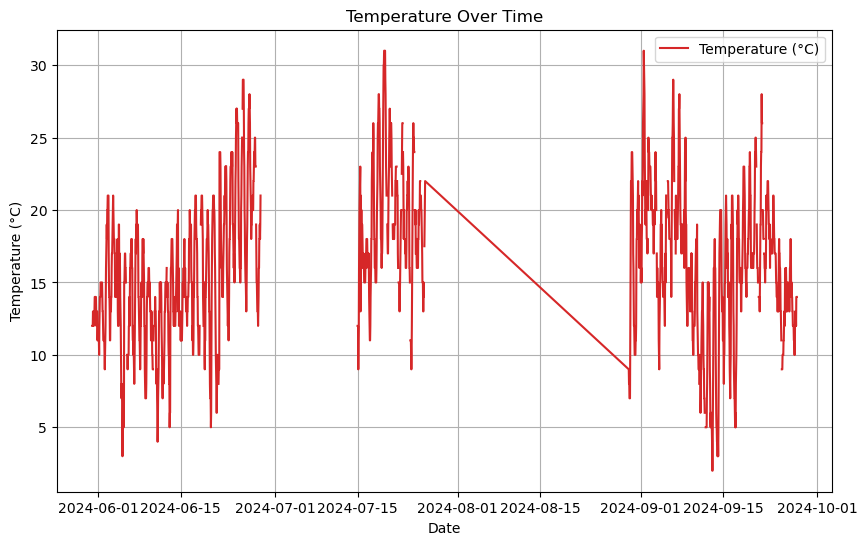

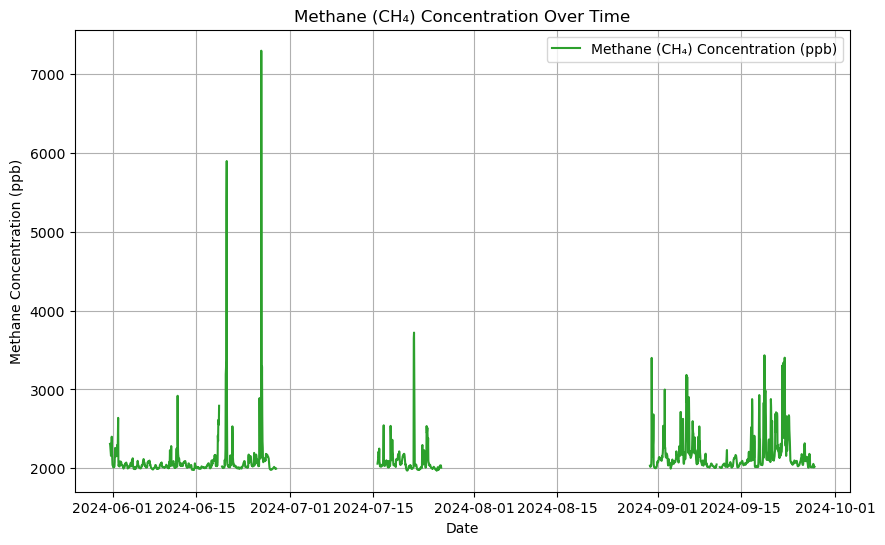

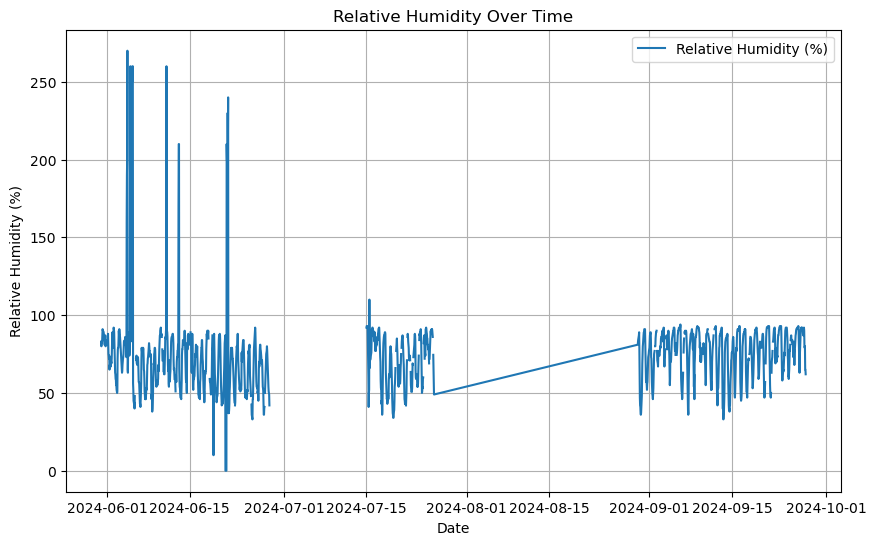

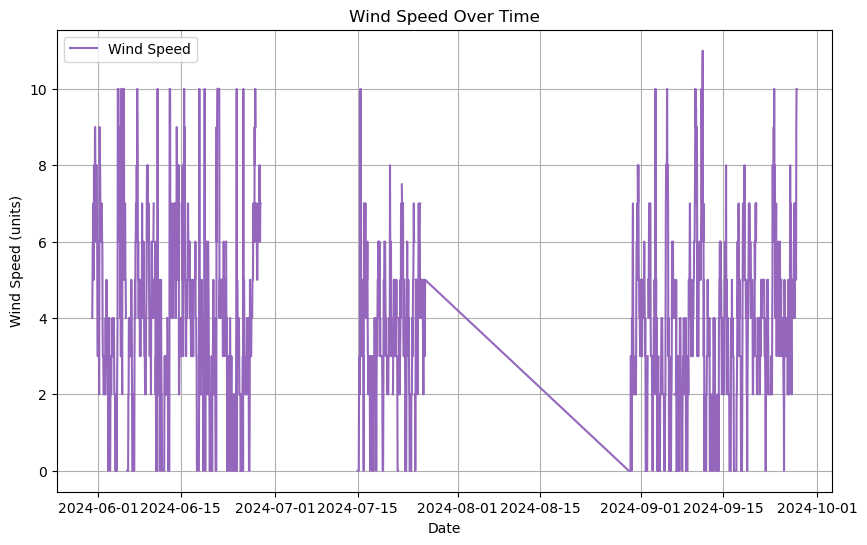

<Figure size 1000x600 with 0 Axes>

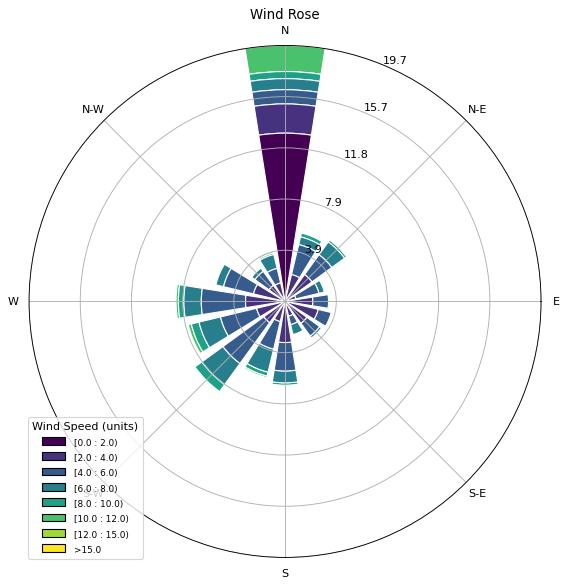

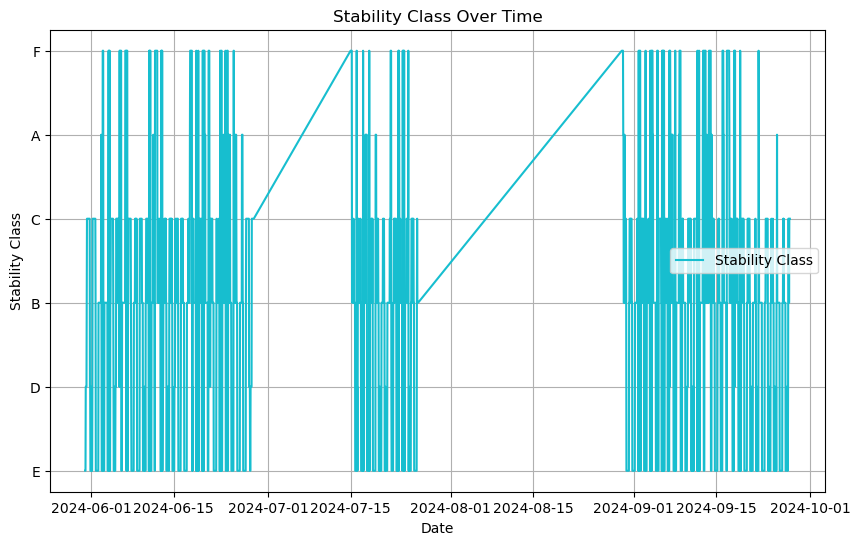

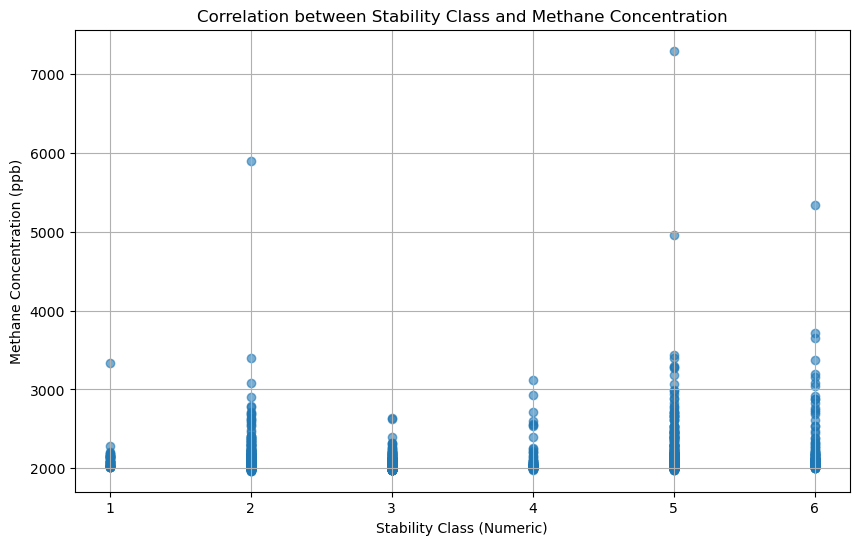

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [14]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Convert 'date' column to datetime format
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()

# Plot Correlation of Stability Class with Methane Concentration
stability_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5, 'F': 6}
data['stability_numeric'] = data['stability_class'].map(stability_mapping)
plt.figure(figsize=(10, 6))
plt.scatter(data['stability_numeric'], data['ch4_ppb'], alpha=0.6, color='tab:blue')
plt.xlabel('Stability Class (Numeric)')
plt.ylabel('Methane Concentration (ppb)')
plt.title('Correlation between Stability Class and Methane Concentration')
plt.grid(True)
plt.show()

# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


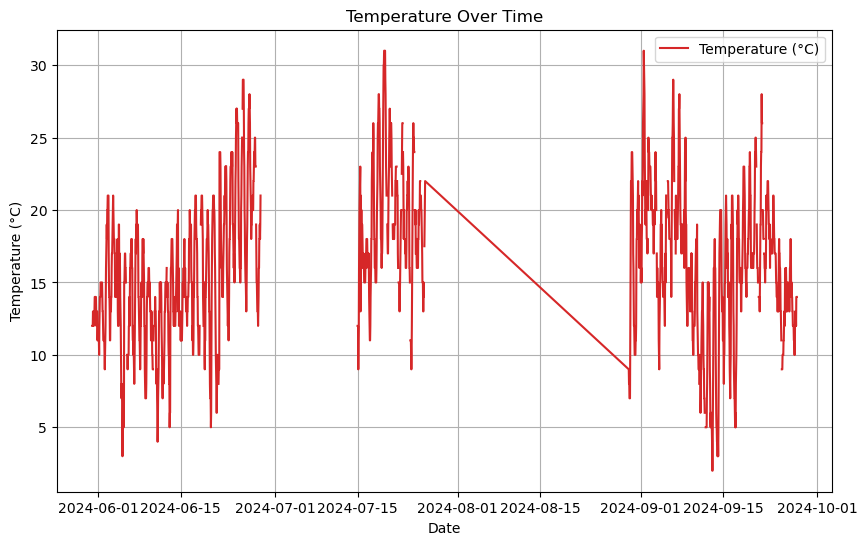

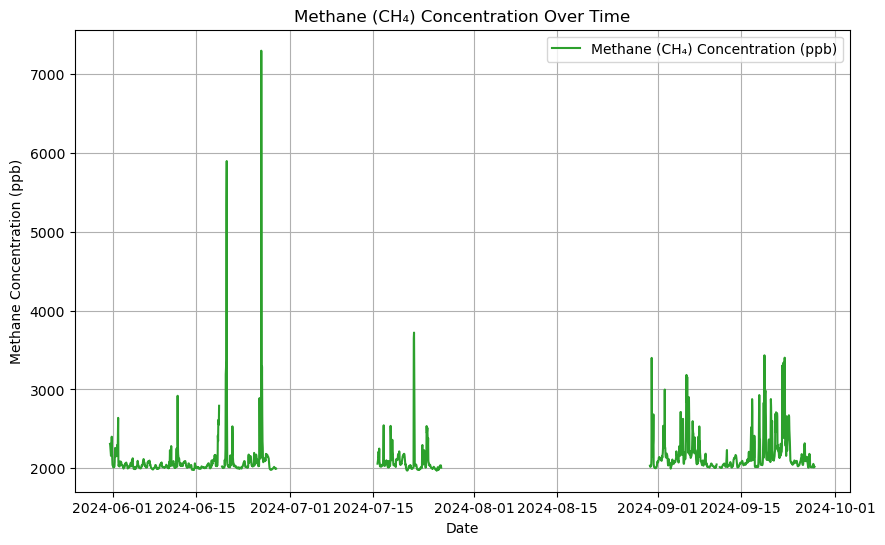

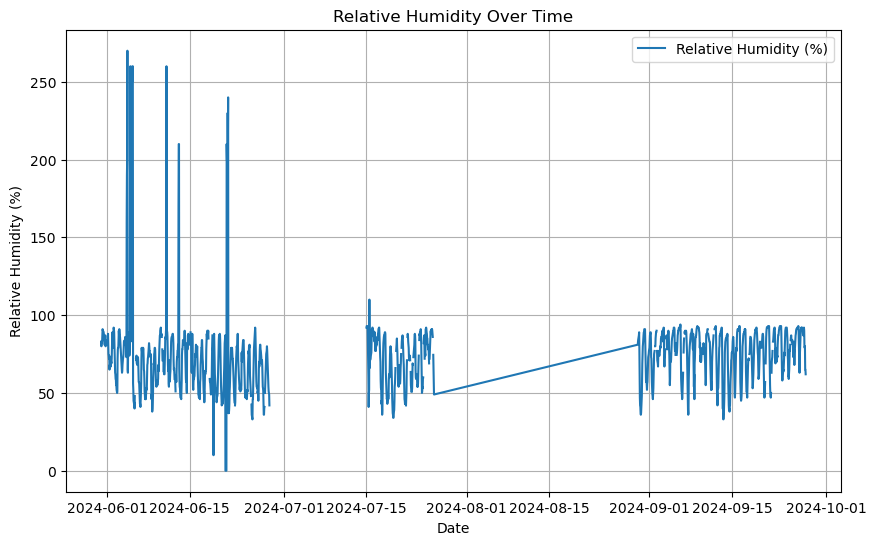

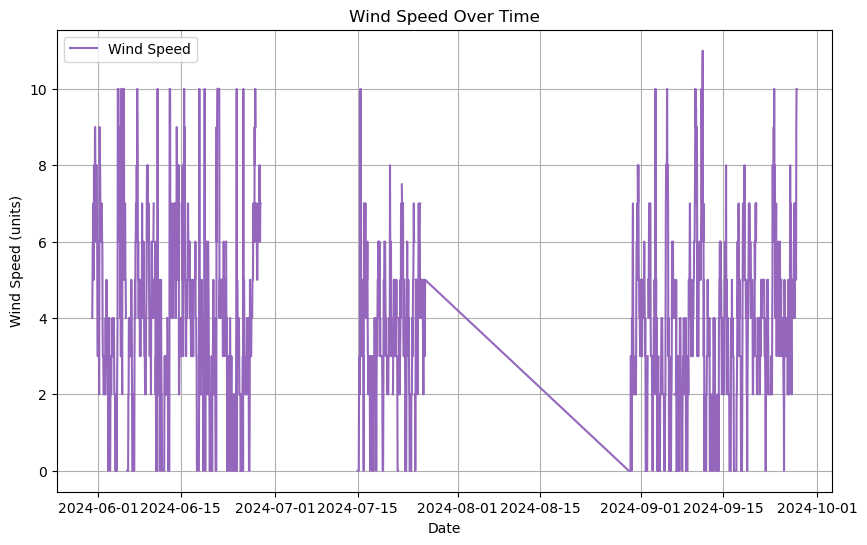

<Figure size 1000x600 with 0 Axes>

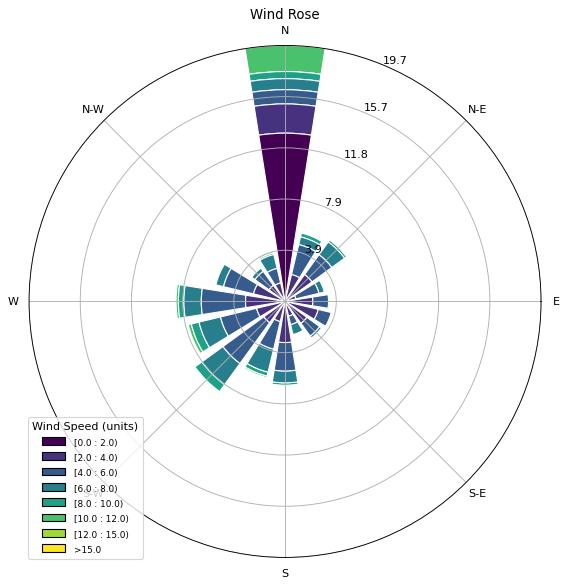

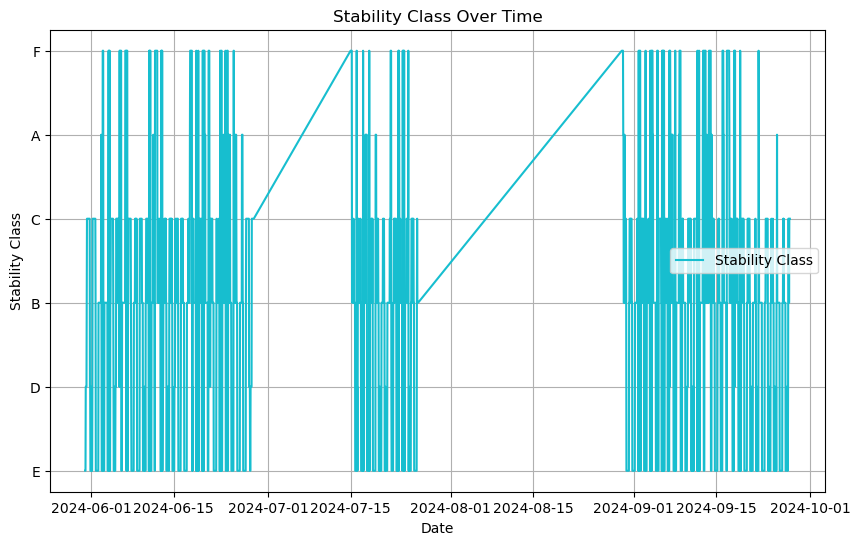

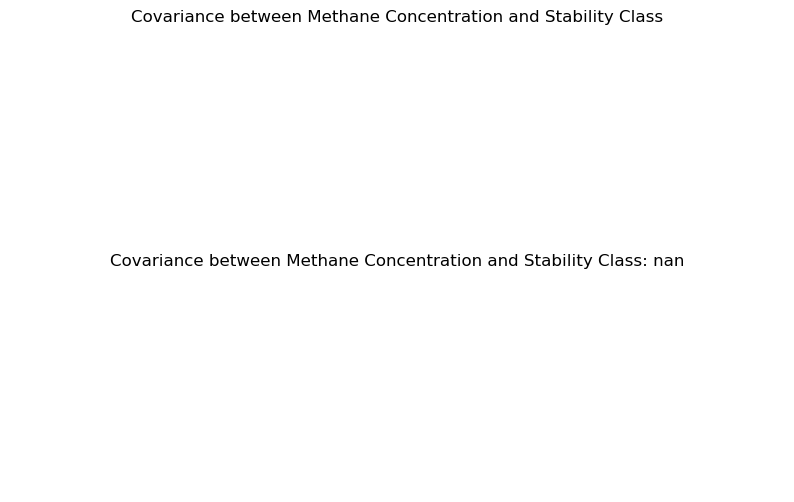

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [15]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Convert 'date' column to datetime format
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()

# Plot Covariance of Methane Concentration and Stability Class
stability_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5, 'F': 6}
data['stability_numeric'] = data['stability_class'].map(stability_mapping)
covariance = np.cov(data['stability_numeric'], data['ch4_ppb'])[0, 1]
plt.figure(figsize=(10, 6))
plt.text(0.5, 0.5, f'Covariance between Methane Concentration and Stability Class: {covariance:.2f}', 
         fontsize=12, ha='center', va='center', wrap=True)
plt.axis('off')
plt.title('Covariance between Methane Concentration and Stability Class')
plt.show()

# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


In [16]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Convert 'date' column to datetime format
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'][(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')], [(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')], label='')', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'][(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')], data['stability_class'][(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')], label='Stability Class')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()

# Plot Covariance of Methane Concentration and Stability Class
stability_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5, 'F': 6}
data['stability_numeric'] = data['stability_class'].map(stability_mapping)
covariance = np.cov(data['stability_numeric'], data['ch4_ppb'])[0, 1]
plt.figure(figsize=(10, 6))
plt.text(0.5, 0.5, f'Covariance between Methane Concentration and Stability Class: {covariance:.2f}', 
         fontsize=12, ha='center', va='center', wrap=True)
plt.axis('off')
plt.title('Covariance between Methane Concentration and Stability Class')
plt.show()

# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: invalid syntax (1793187948.py, line 37)

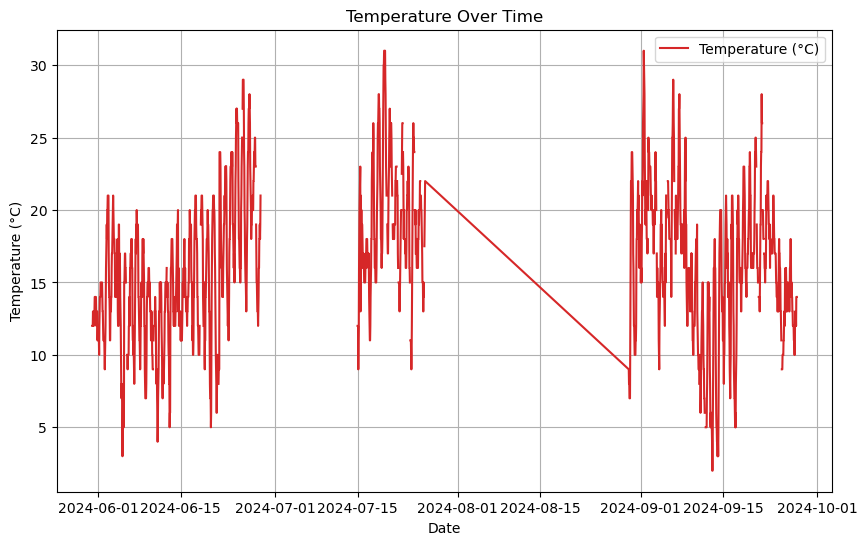

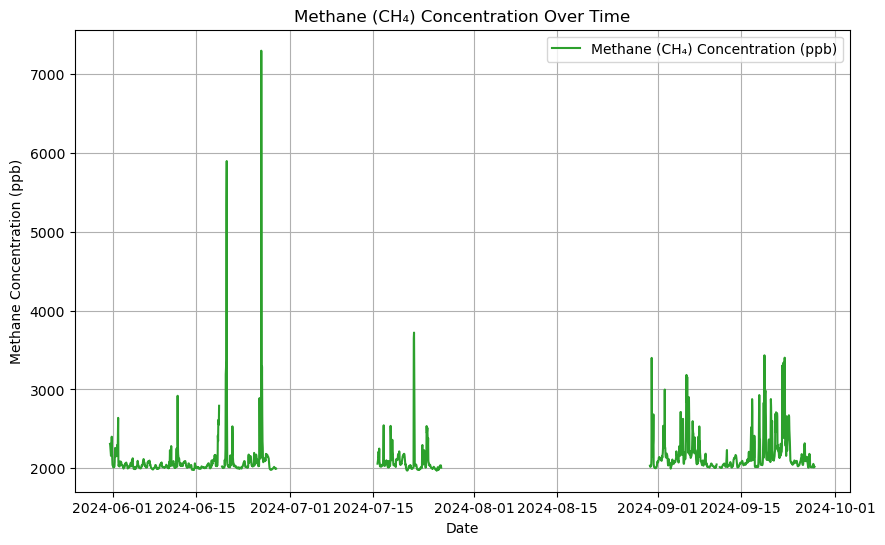

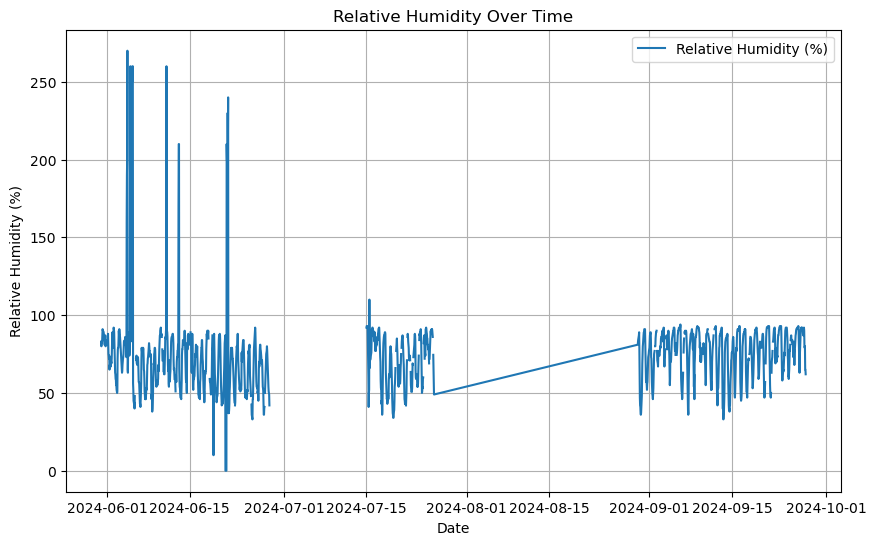

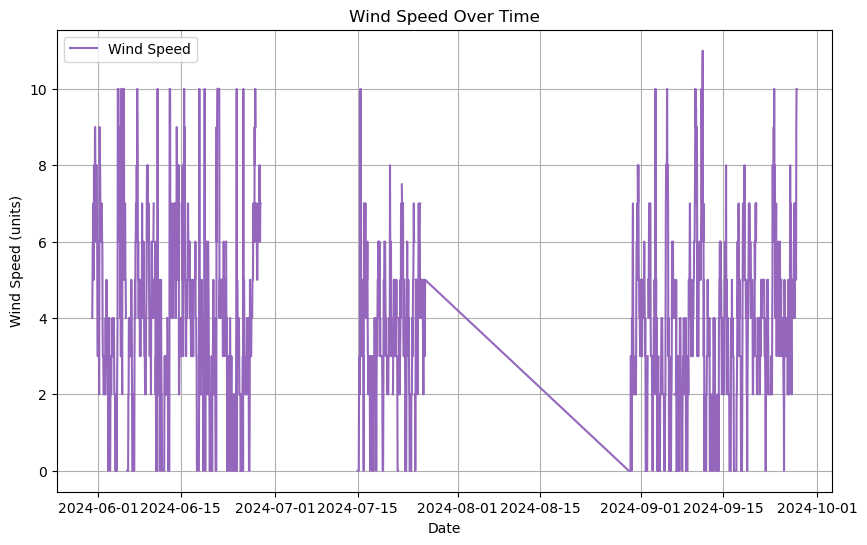

<Figure size 1000x600 with 0 Axes>

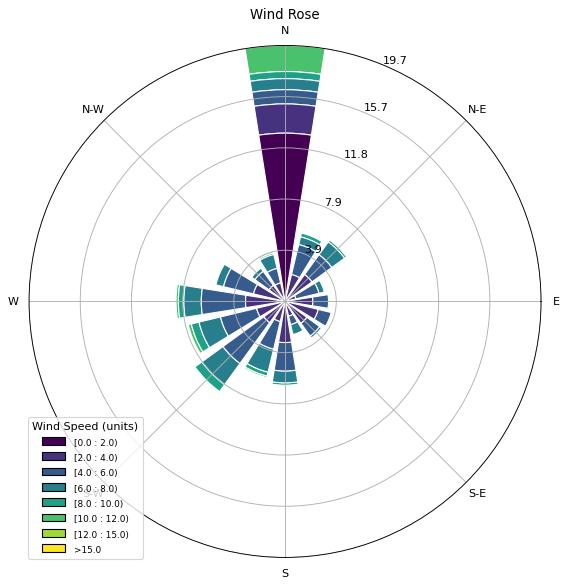

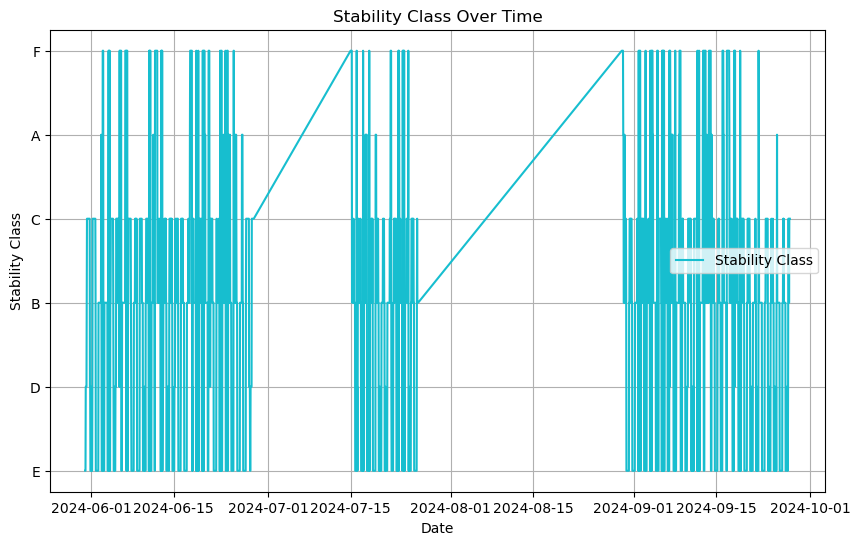

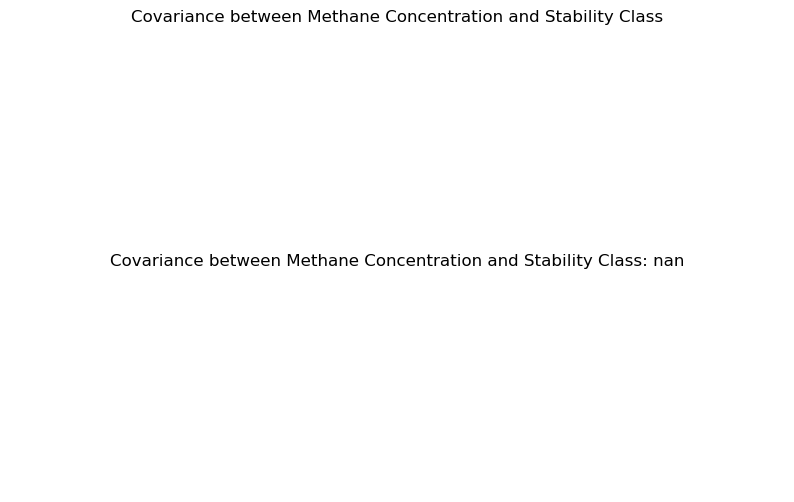

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [17]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Convert 'date' column to datetime format
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()

# Plot Covariance of Methane Concentration and Stability Class
stability_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5, 'F': 6}
data['stability_numeric'] = data['stability_class'].map(stability_mapping)
covariance = np.cov(data['stability_numeric'], data['ch4_ppb'])[0, 1]
plt.figure(figsize=(10, 6))
plt.text(0.5, 0.5, f'Covariance between Methane Concentration and Stability Class: {covariance:.2f}', 
         fontsize=12, ha='center', va='center', wrap=True)
plt.axis('off')
plt.title('Covariance between Methane Concentration and Stability Class')
plt.show()

# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


In [18]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

# Filter data to only include June and July 2024
data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Convert 'date' column to datetime format
data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: invalid syntax (1508546340.py, line 14)

In [19]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: invalid syntax (2842897007.py, line 20)

In [24]:
data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

,date,ALTM_hPa,temp,DEW_C,rh,wd,ws,nsec,lat,lon,altinmeters,nsec.licor,co2_ppm,h2o_ppm,ch4_ppb,ch4_ppm,latitude2,longitude2,stability_class,stability_numeric
24,2024-06-01 00:00:00,1022.0,12.0,9.0,81.0,340.0,5.0,3926188800,52.42,0.57,10.0,3926188800,502.675686,10302.456356,2033.570846,2.033571,52.237111,0.144343,E,5
25,2024-06-01 01:00:00,1022.0,11.0,8.0,82.0,330.0,5.0,3926192400,52.42,0.57,10.0,3926192400,499.947144,10355.819219,2035.321906,2.035322,52.237111,0.144343,E,5
26,2024-06-01 02:00:00,1022.0,11.0,9.0,83.0,350.0,6.0,3926196000,52.42,0.57,10.0,3926196000,498.243073,10503.512316,2017.076573,2.017077,52.237111,0.144343,D,4
27,2024-06-01 03:00:00,1022.4,11.0,9.0,83.0,340.0,4.0,3926199600,52.42,0.57,10.0,3926199600,498.223777,10264.297981,2010.005053,2.010005,52.237111,0.144343,E,5
28,2024-06-01 04:00:00,1022.4,10.0,9.0,88.0,300.0,2.0,3926203200,52.42,0.57,10.0,3926203200,500.904840,10143.616014,2019.127673,2.019128,52.237111,0.144343,E,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
682,2024-06-28 10:00:00,1014.2,19.0,8.0,51.0,230.0,8.0,3928557600,52.42,0.57,10.0,3928557600,471.847389,10962.051657,1997.264961,1.997265,52.237111,0.144343,C,3
683,2024-06-28 11:00:00,1014.6,18.0,8.0,50.0,270.0,6.0,3928561200,52.42,0.57,10.0,3928561200,470.943334,10787.715057,1996.197633,1.996198,52.237111,0.144343,C,3
684,2024-06-28 12:00:00,1014.6,19.0,8.0,49.0,240.0,7.0,3928564800,52.42,0.57,10.0,3928564800,471.953476,10706.882007,1997.418815,1.997419,52.237111,0.144343,C,3
685,2024-06-28 13:00:00,1014.6,21.0,7.0,42.0,230.0,7.0,3928568400,52.42,0.57,10.0,3928568400,470.619104,10373.153587,1992.516618,1.992517,52.237111,0.144343,C,3


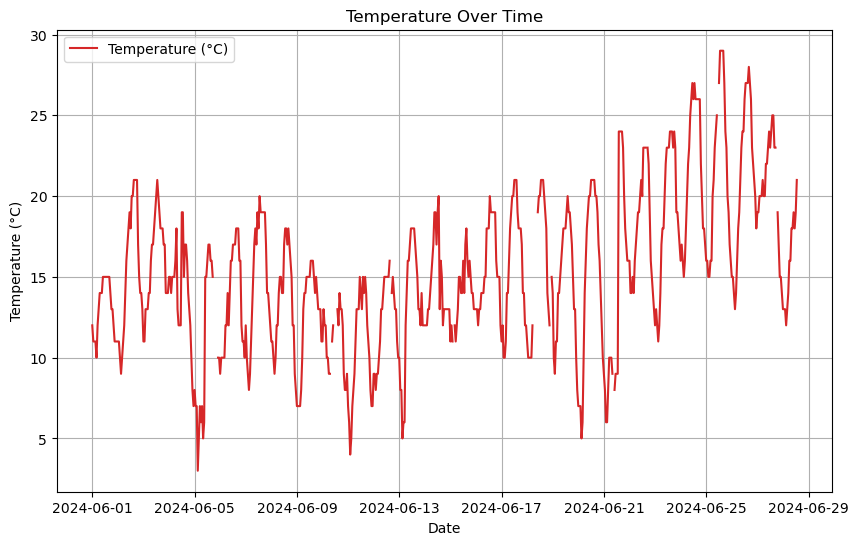

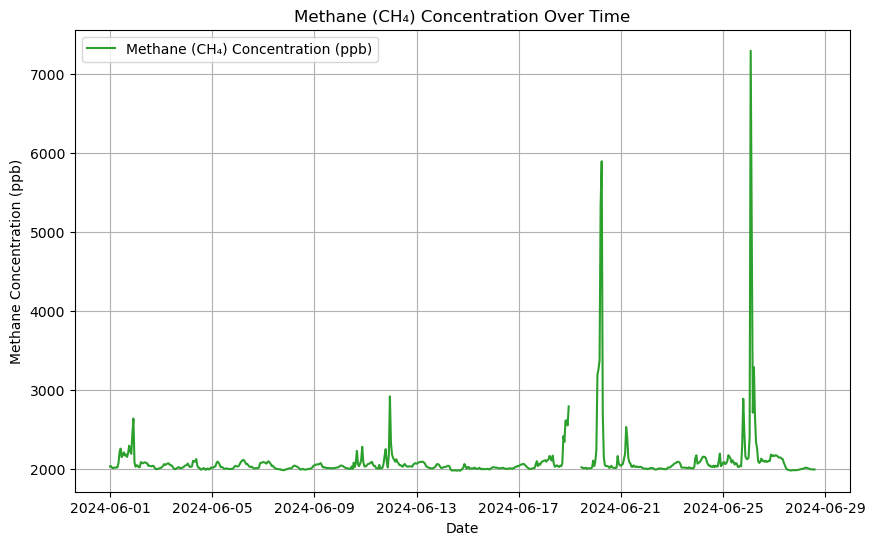

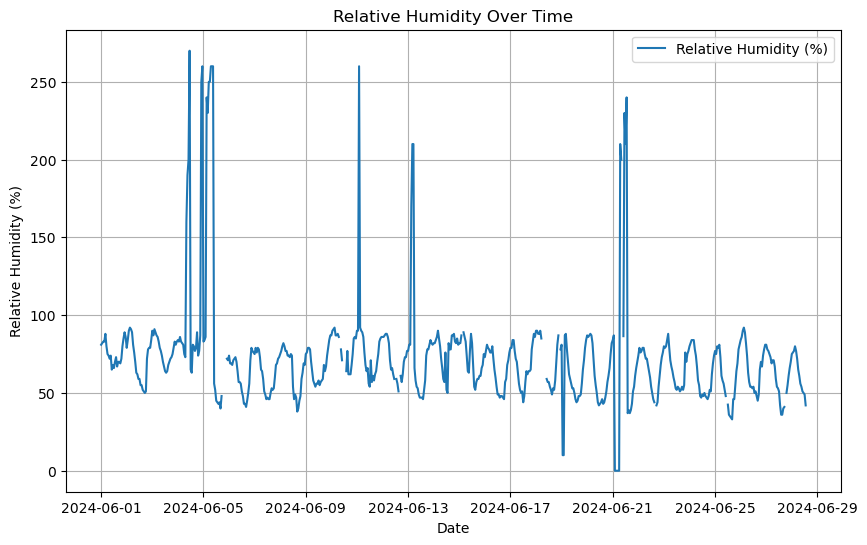

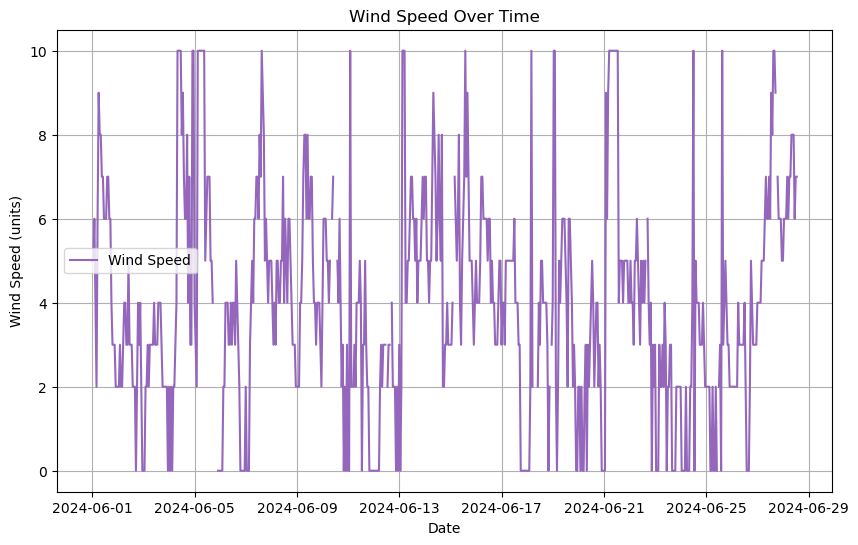

<Figure size 1000x600 with 0 Axes>

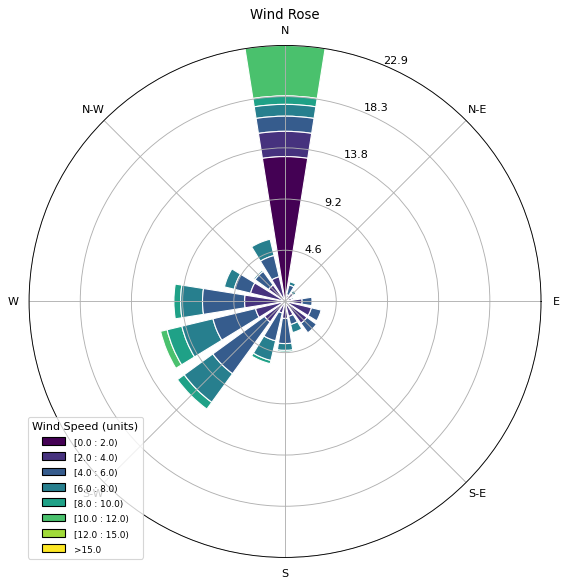

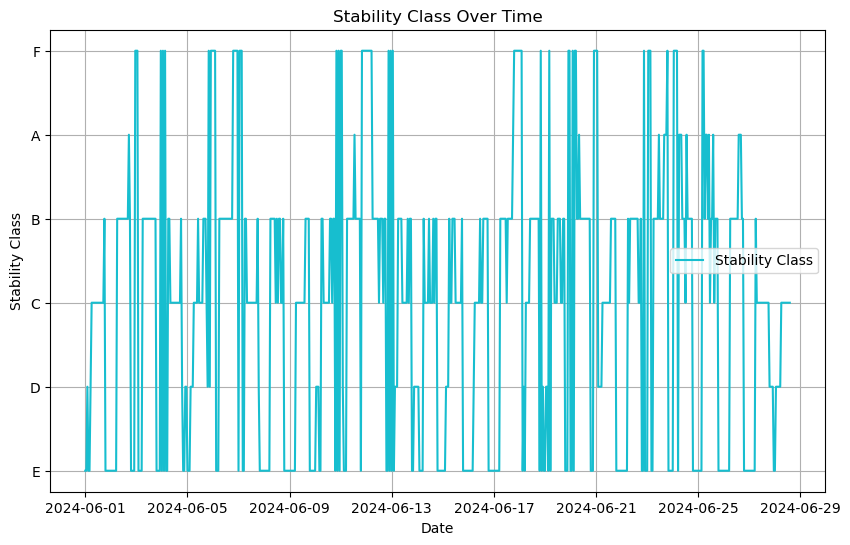

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [25]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


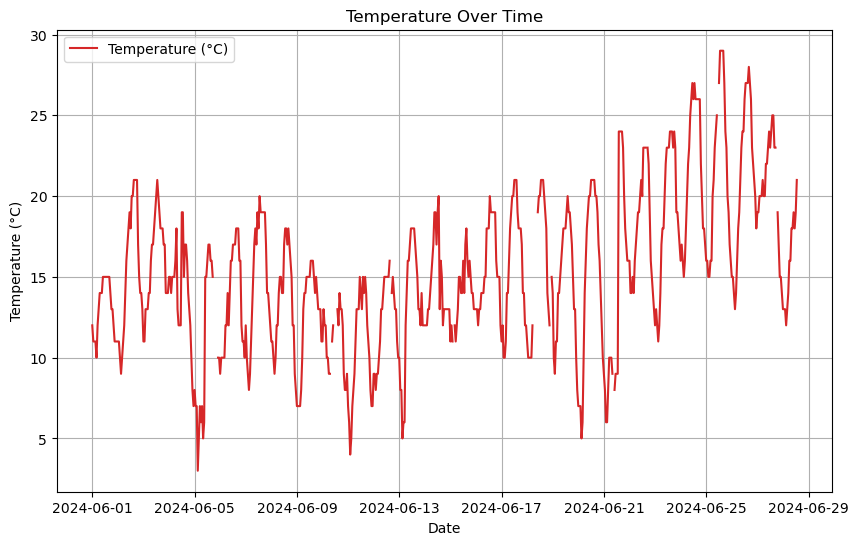

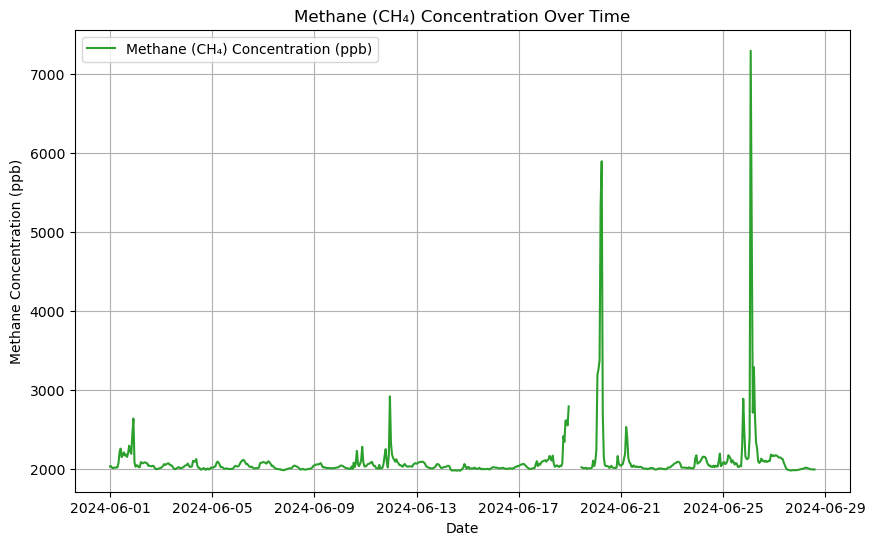

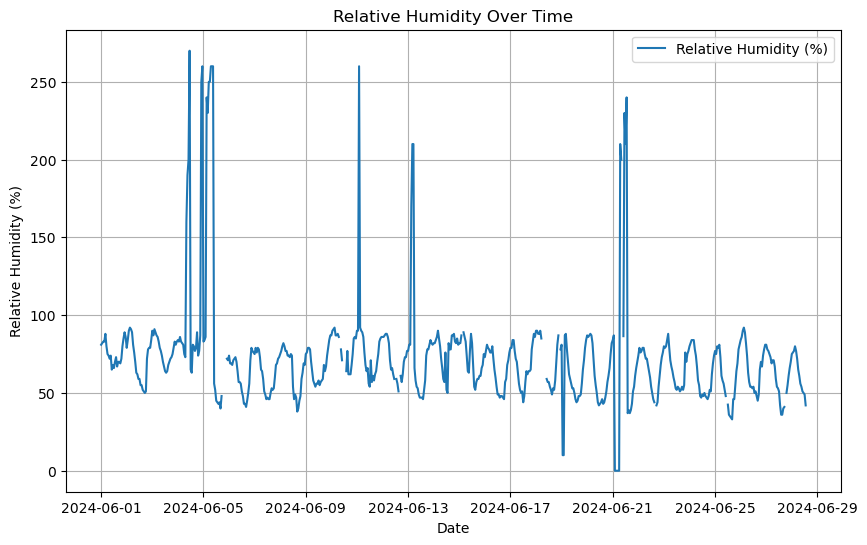

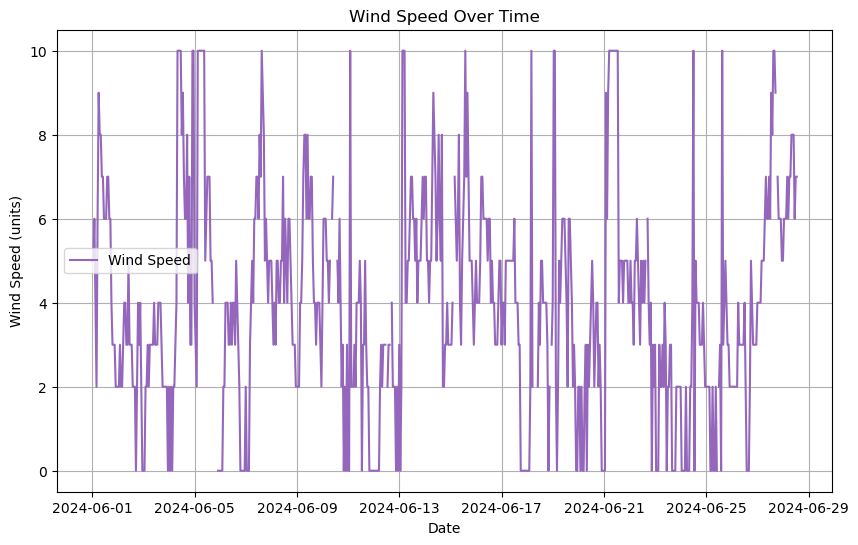

<Figure size 1000x600 with 0 Axes>

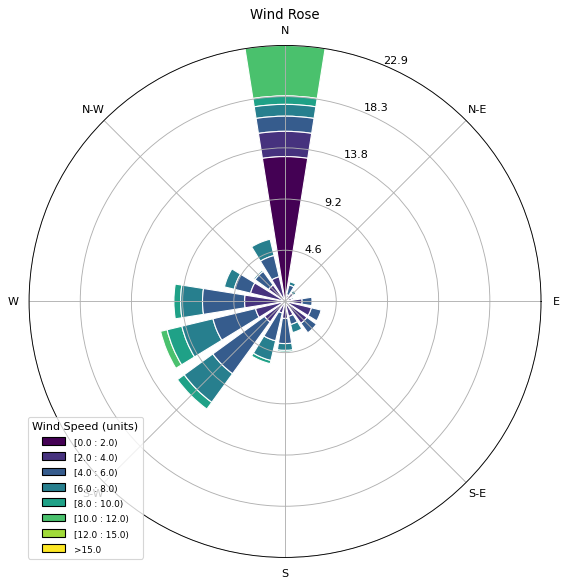

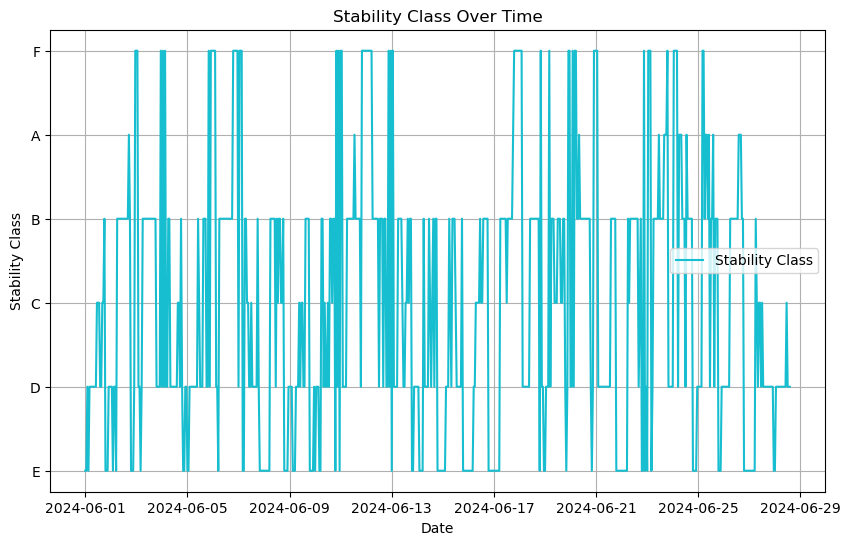

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [26]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots
def plot_time_series(x, y, label, ylabel, title, color):
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


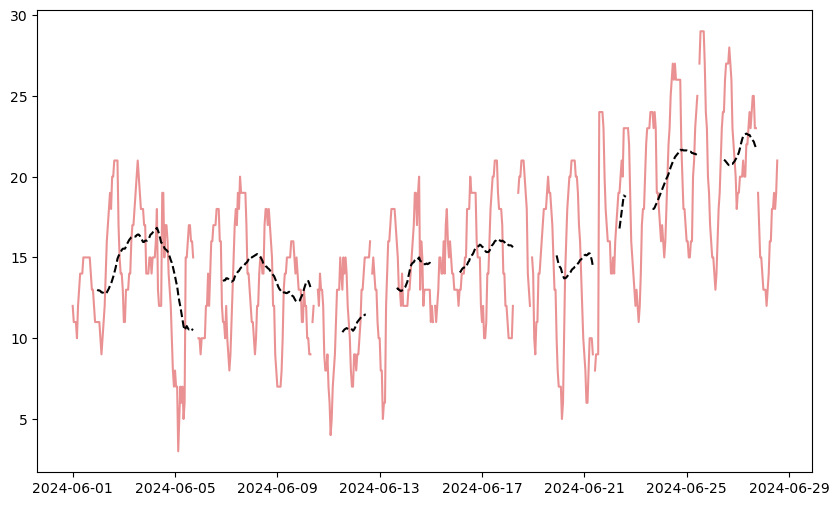

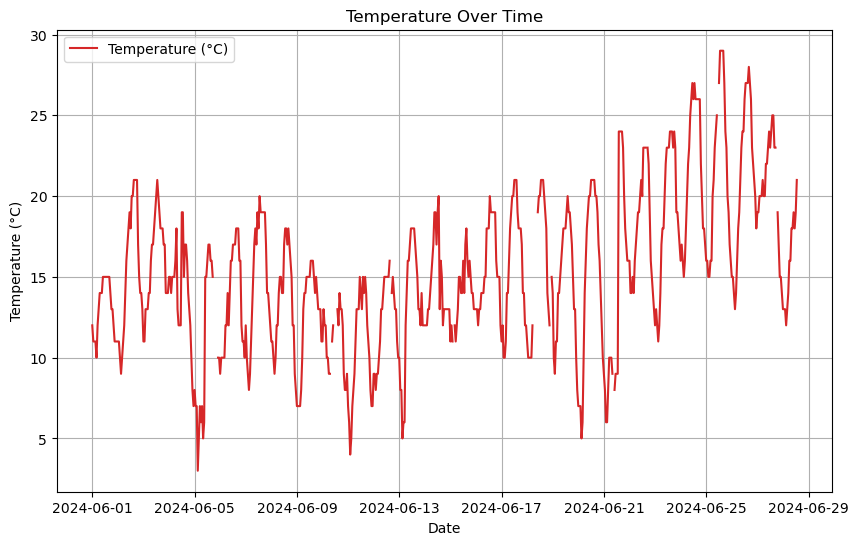

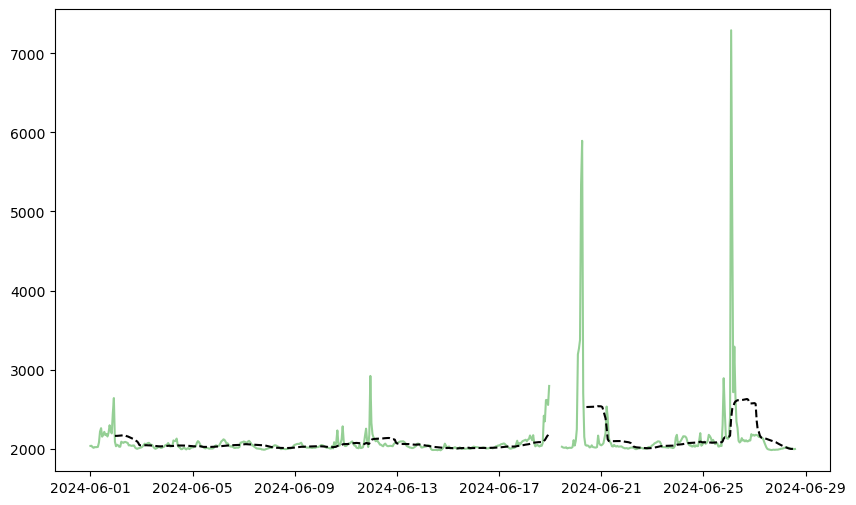

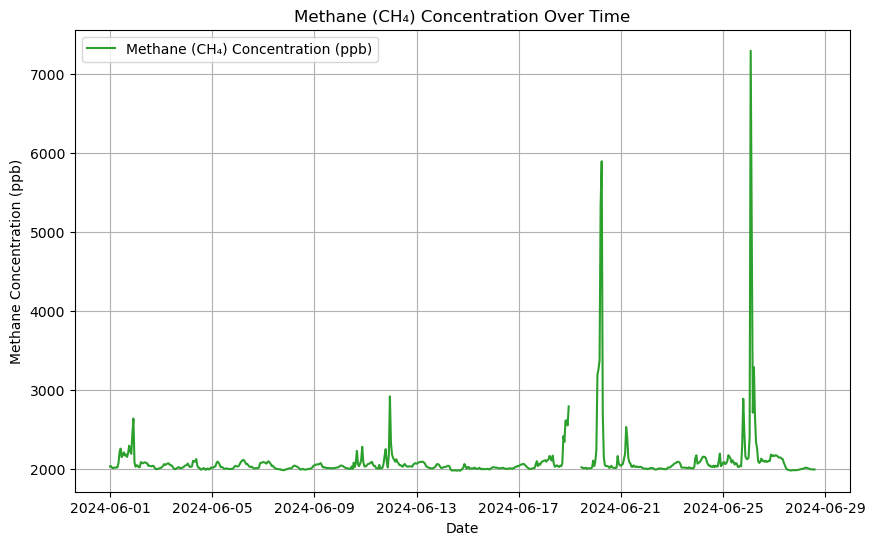

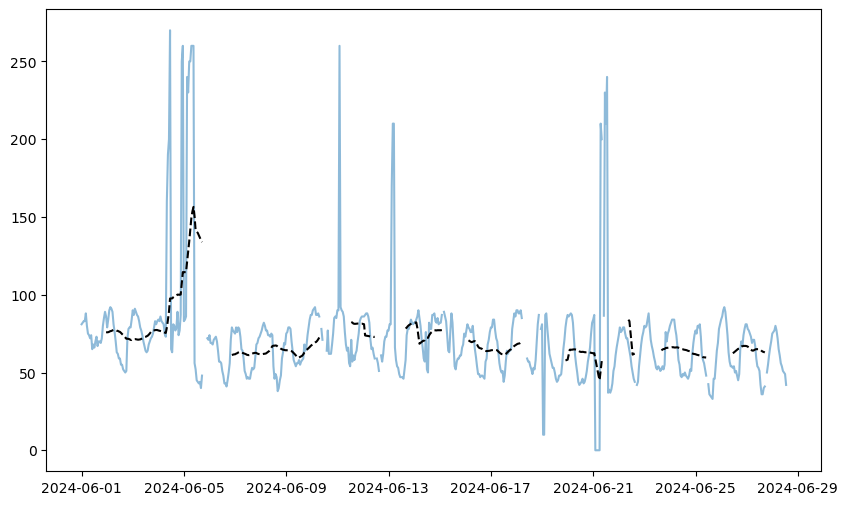

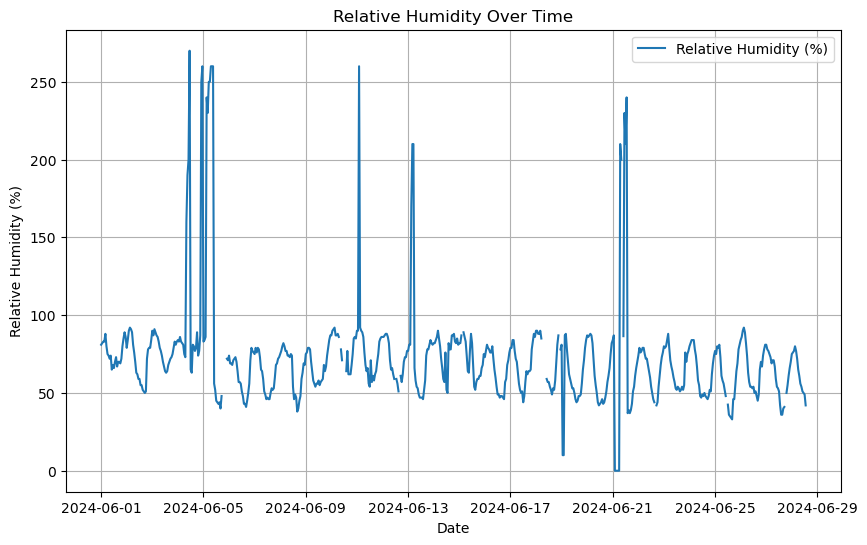

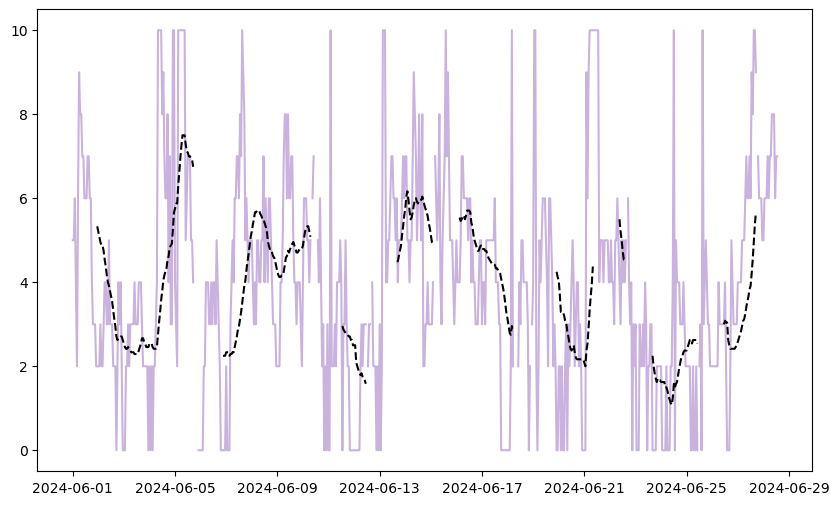

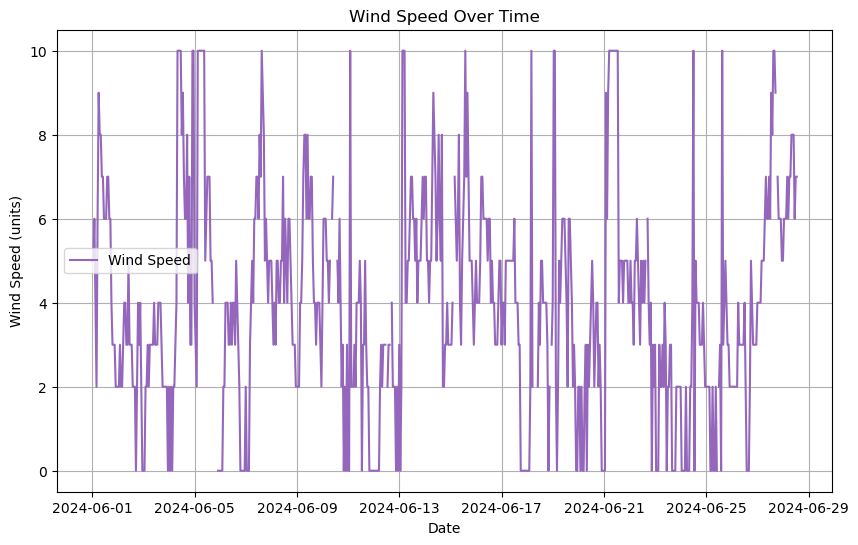

<Figure size 1000x600 with 0 Axes>

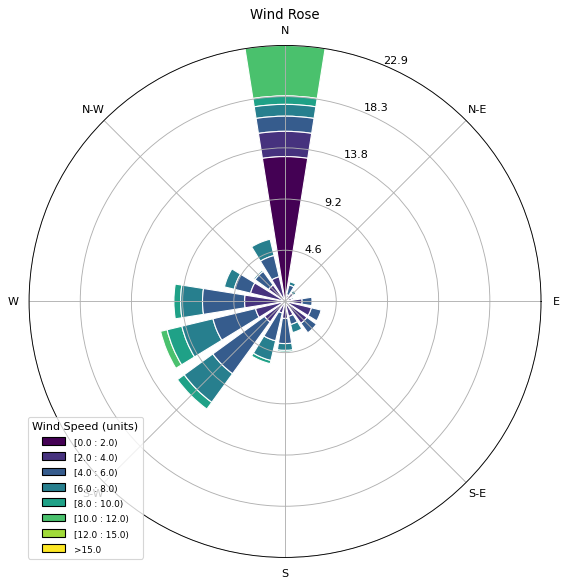

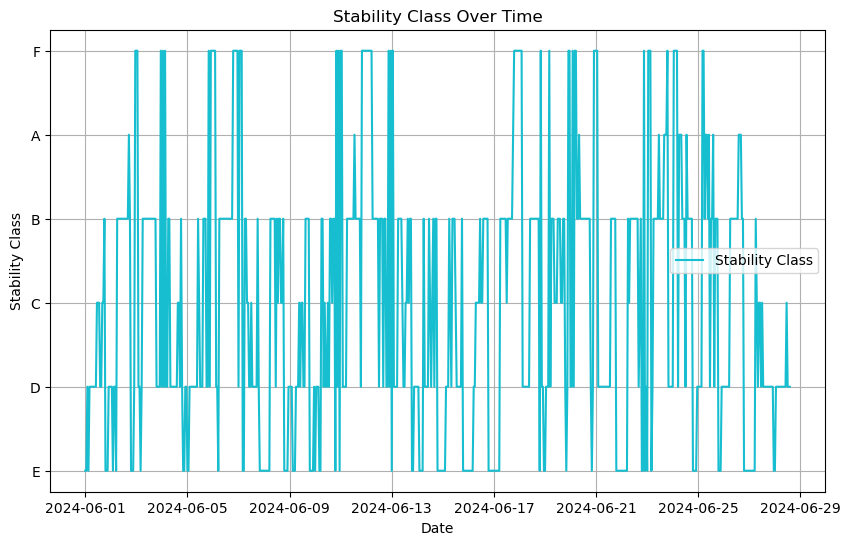

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [27]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
def plot_time_series(x, y, label, ylabel, title, color, window=24):
    rolling_avg = y.rolling(window=window).mean()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.plot(x, rolling_avg, label=f'{label} (Rolling Avg, {window}-hour)', color='black', linestyle='--')
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


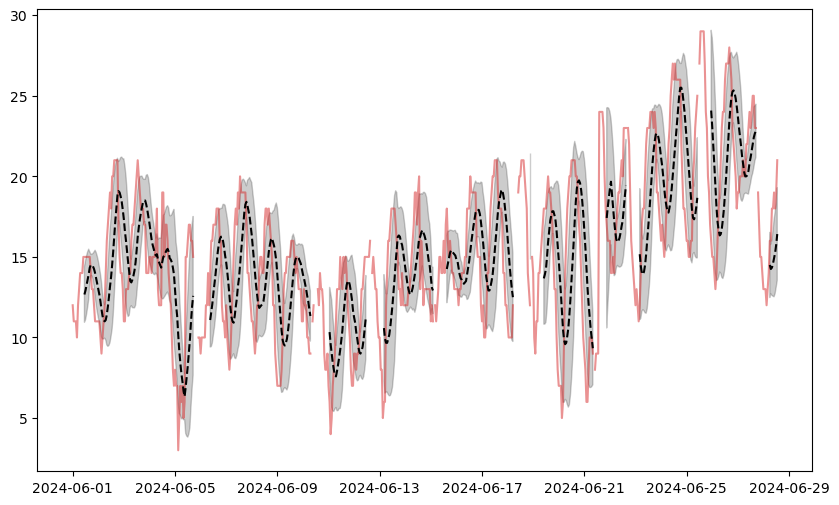

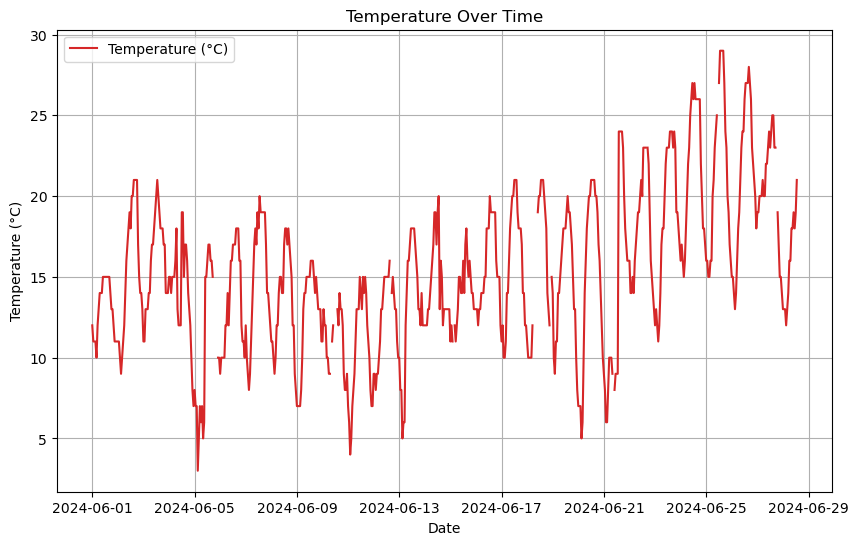

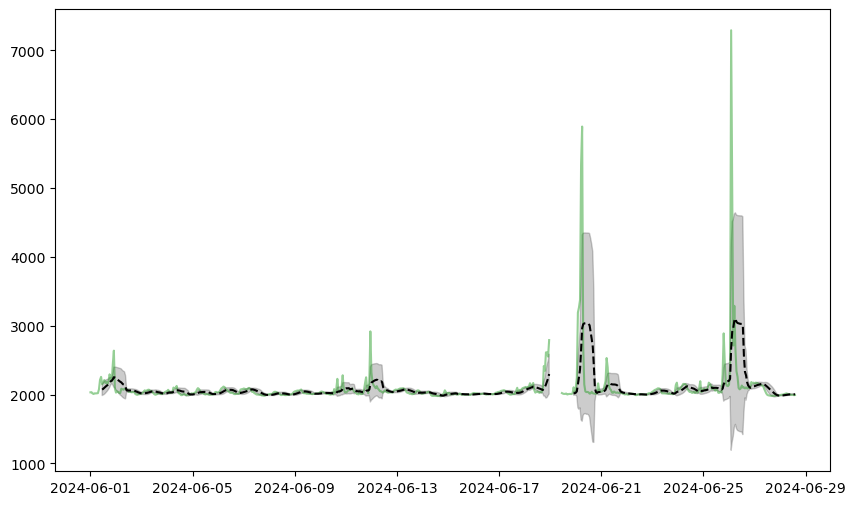

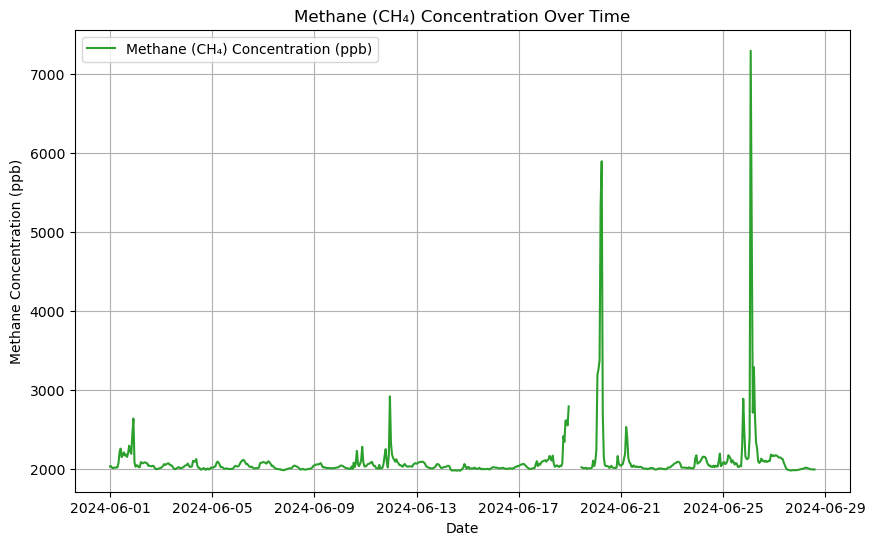

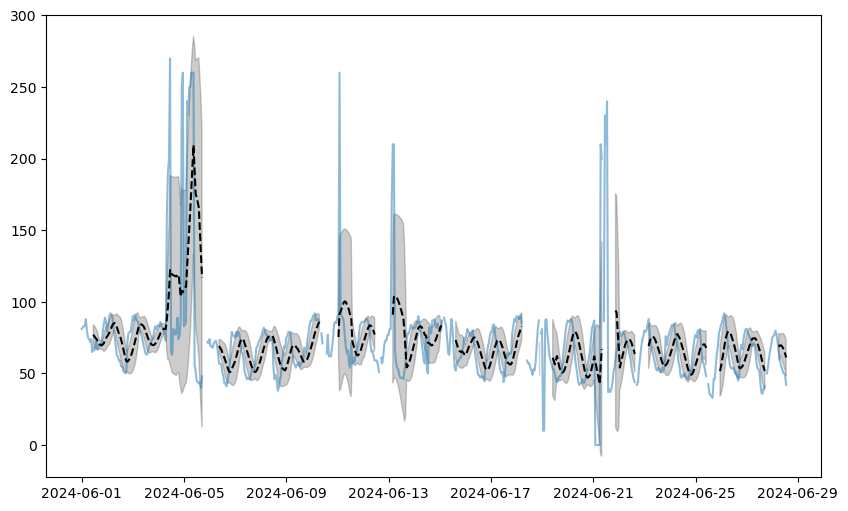

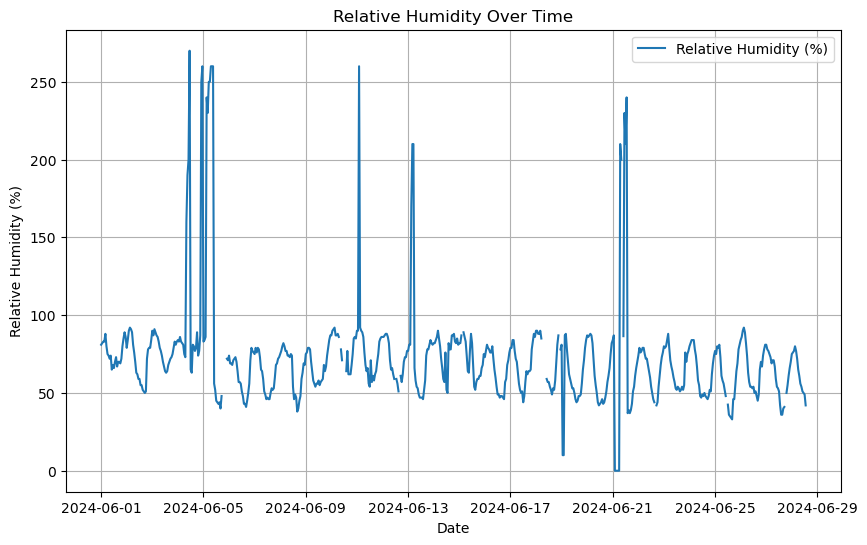

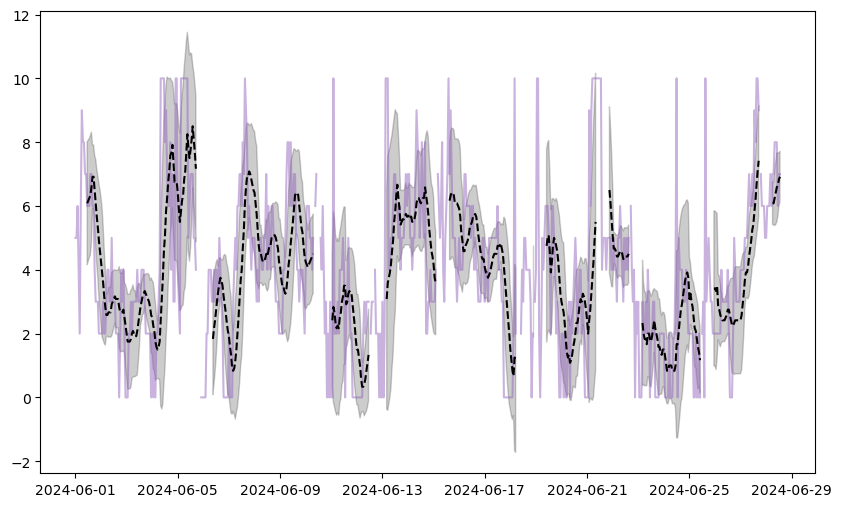

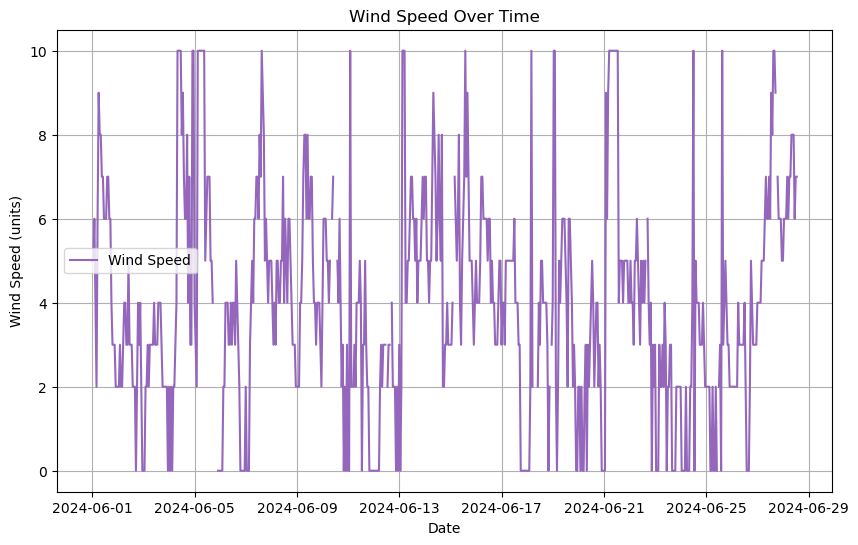

<Figure size 1000x600 with 0 Axes>

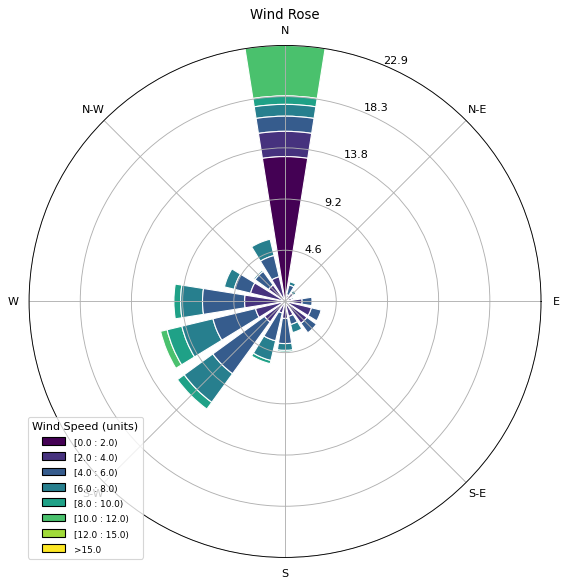

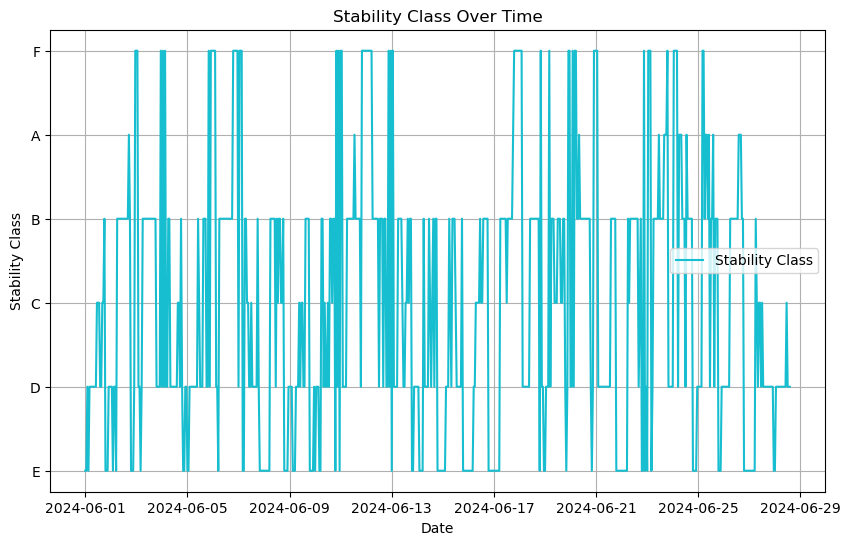

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [28]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    rolling_avg = y.rolling(window=window).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.plot(x, rolling_avg, label=f'{label} (Rolling Avg, {window}-hour)', color='black', linestyle='--')
    plt.fill_between(x, rolling_avg - rolling_std, rolling_avg + rolling_std, color='black', alpha=0.2, label='Rolling Avg ± 1 Std Dev')
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


In [29]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
        plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


IndentationError: unexpected indent (1538583618.py, line 43)

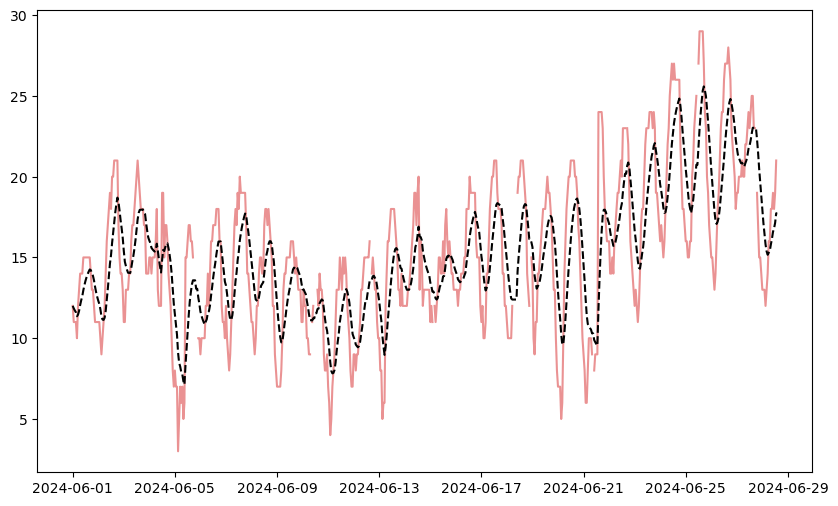

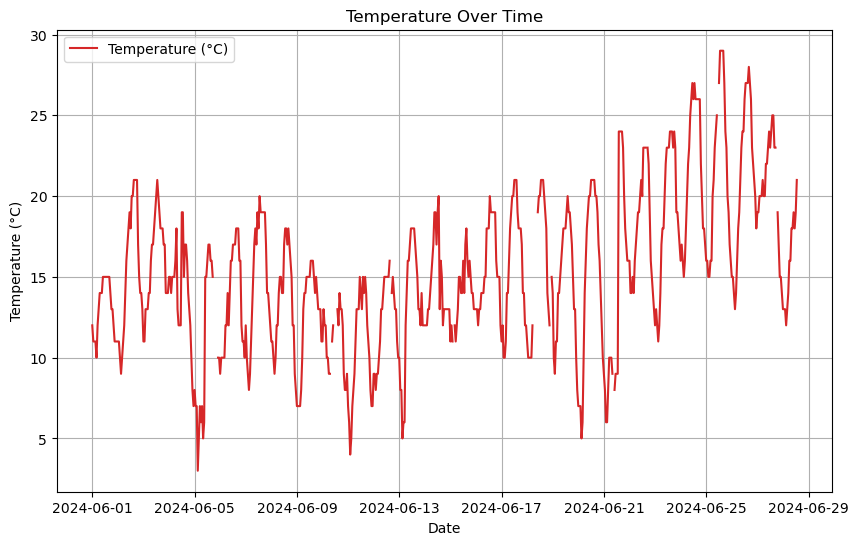

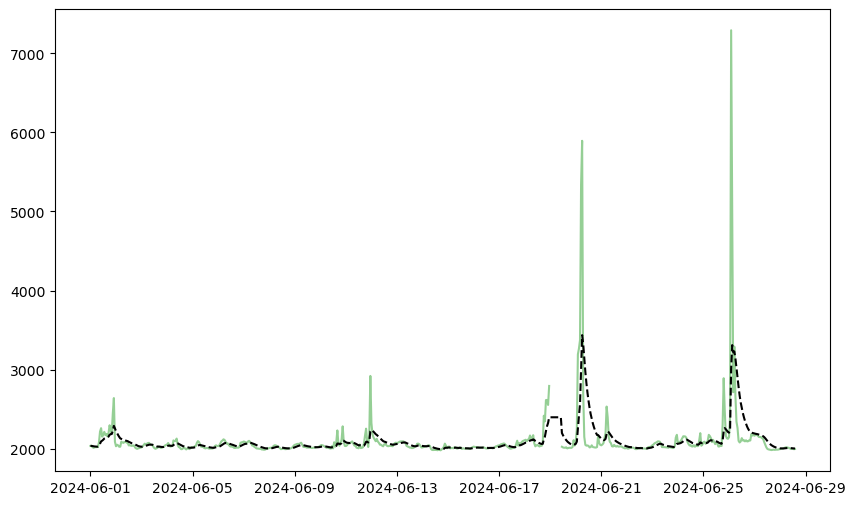

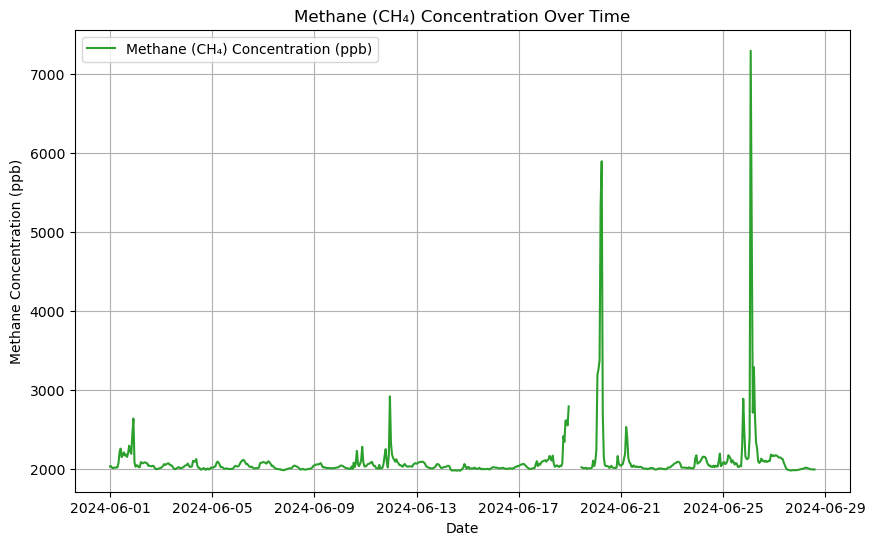

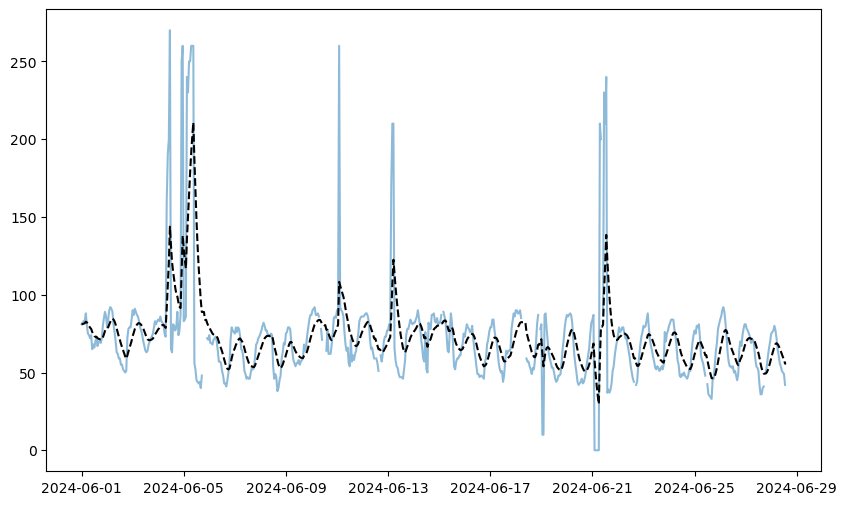

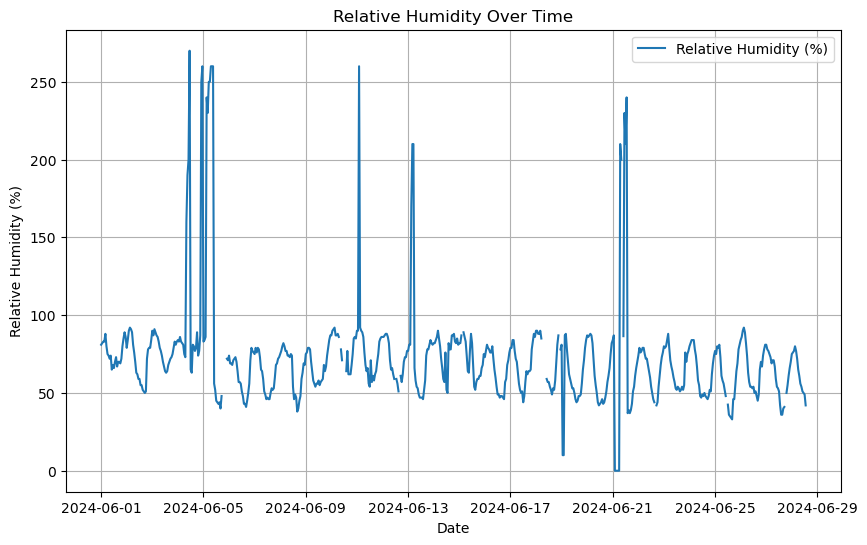

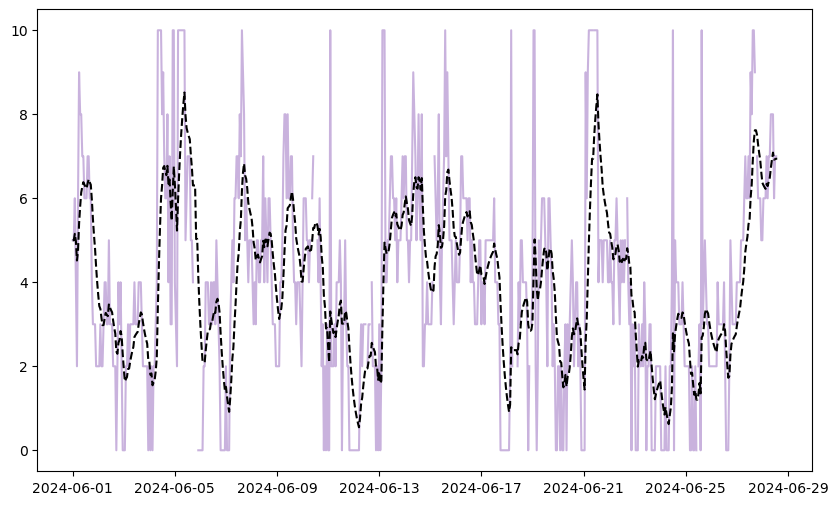

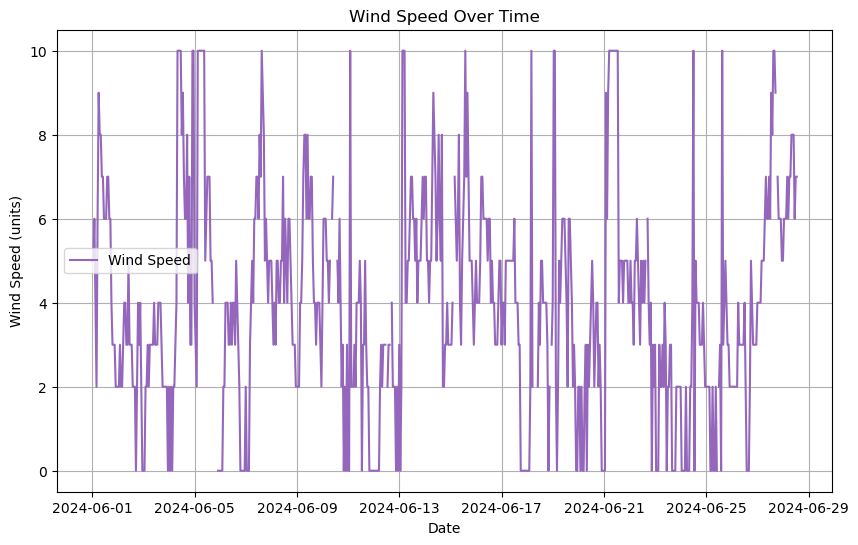

<Figure size 1000x600 with 0 Axes>

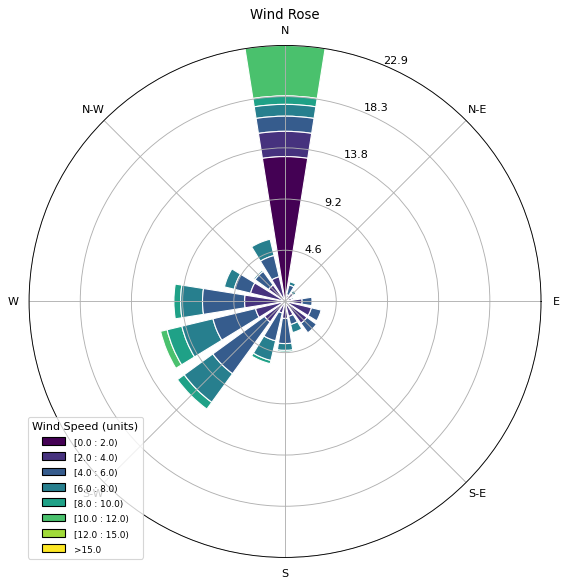

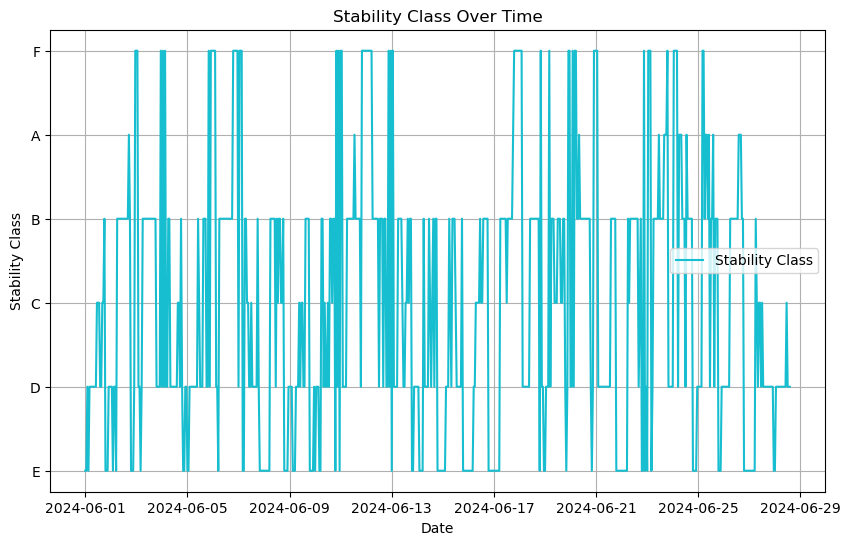

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [31]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.title(title)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


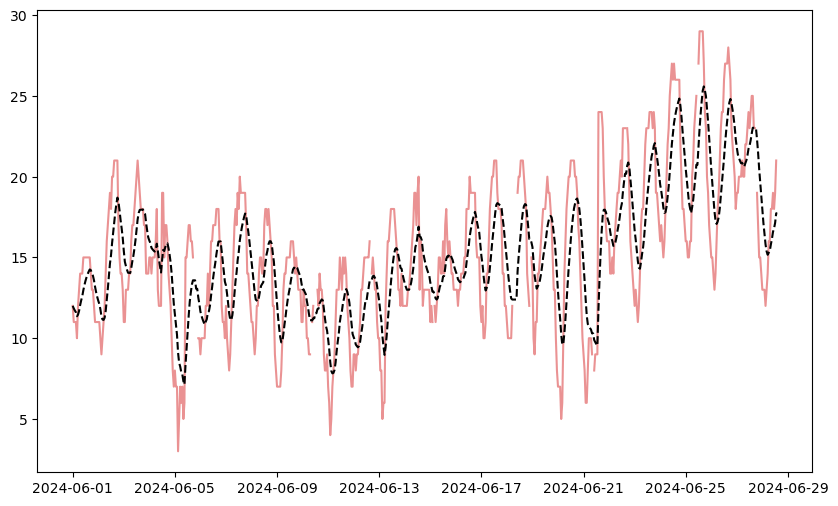

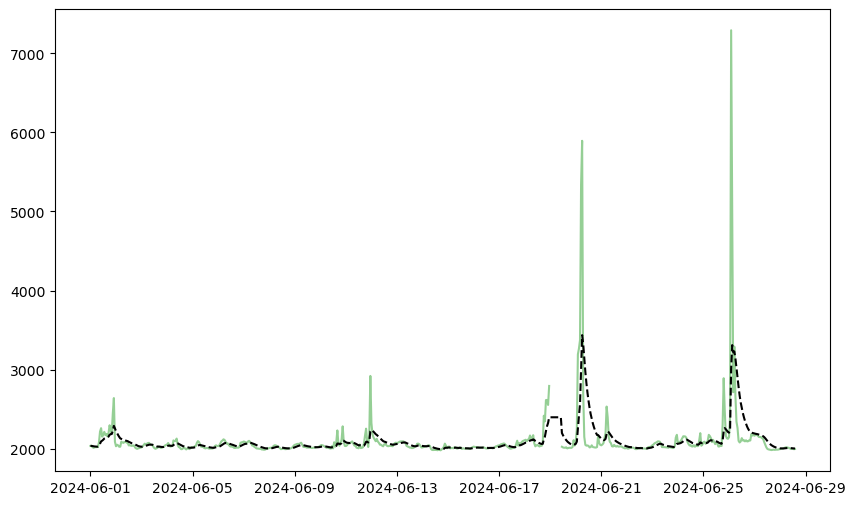

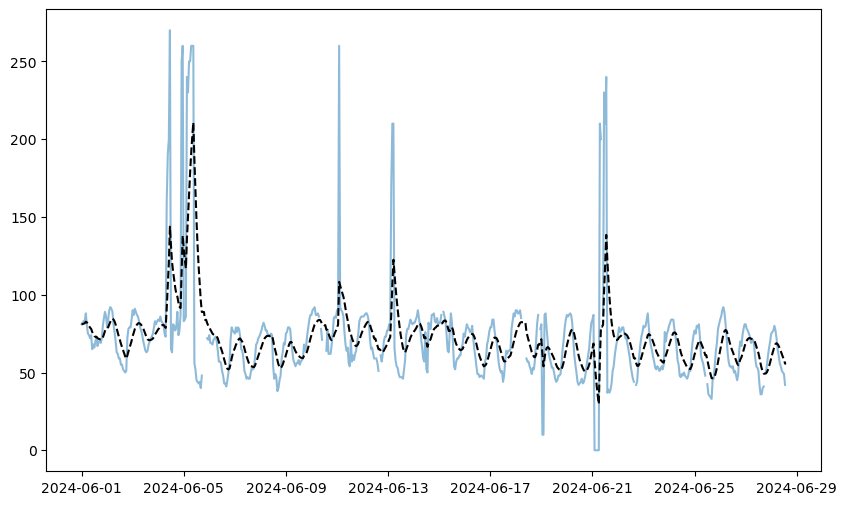

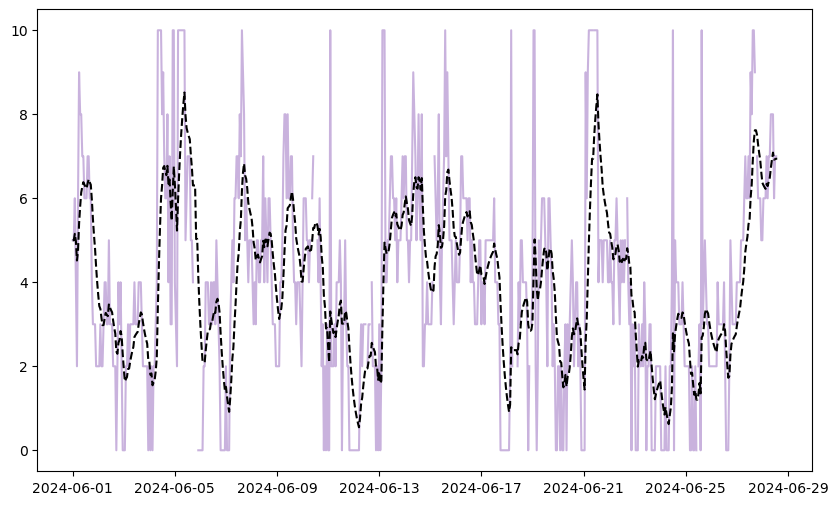

<Figure size 1000x600 with 0 Axes>

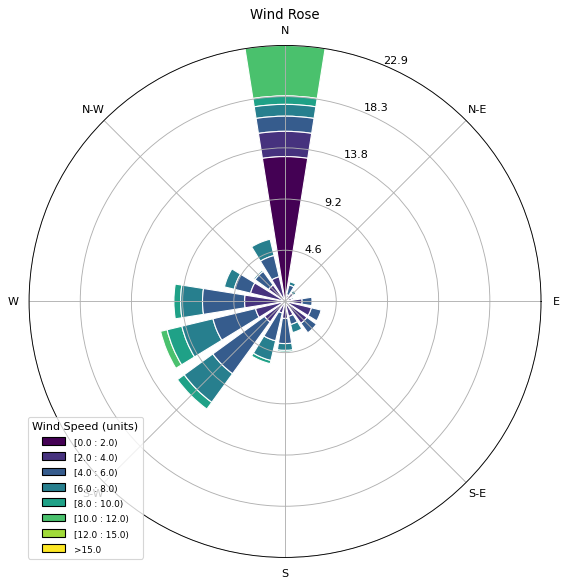

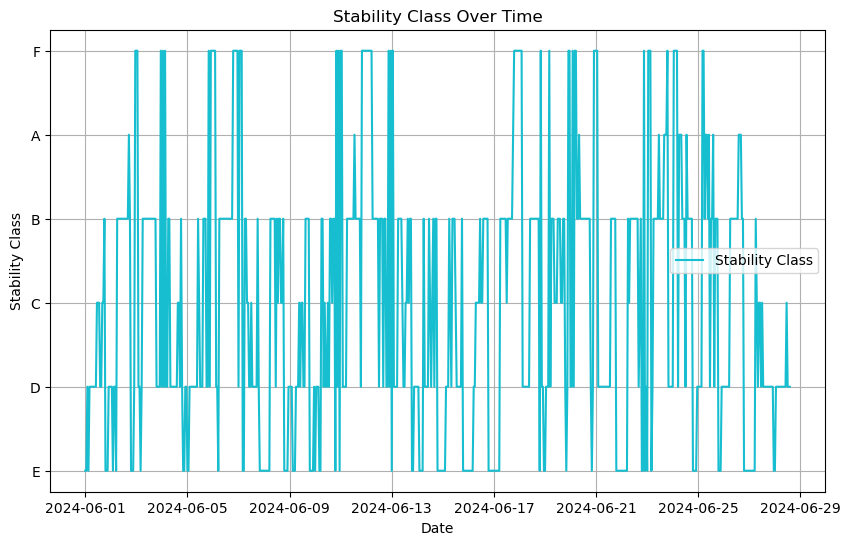

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [32]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
plt.plot(data['date'], data['stability_class'], label='Stability Class', color='tab:cyan')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


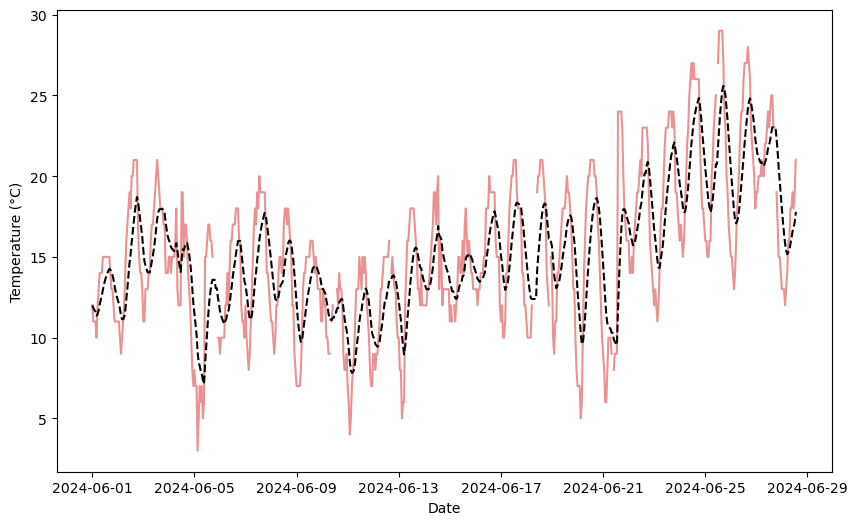

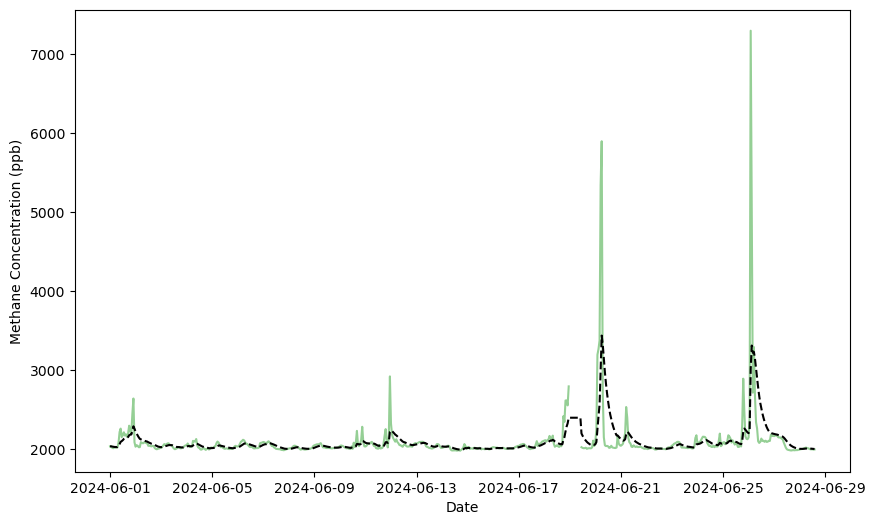

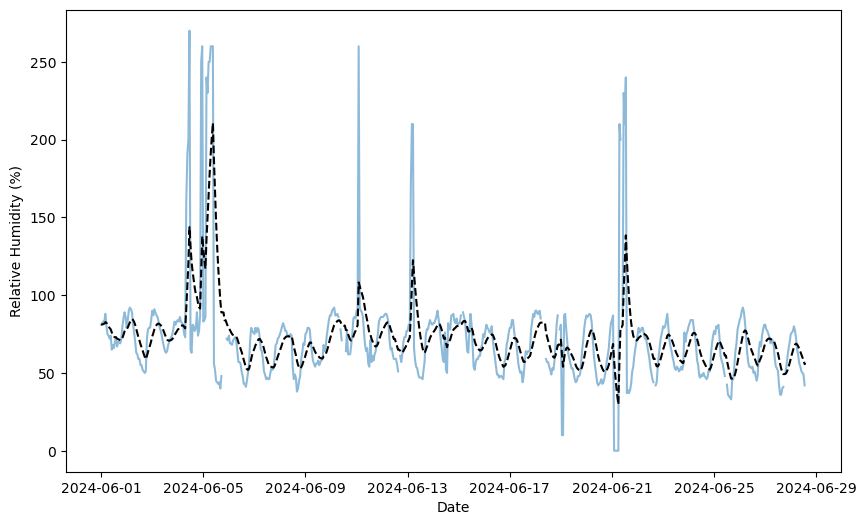

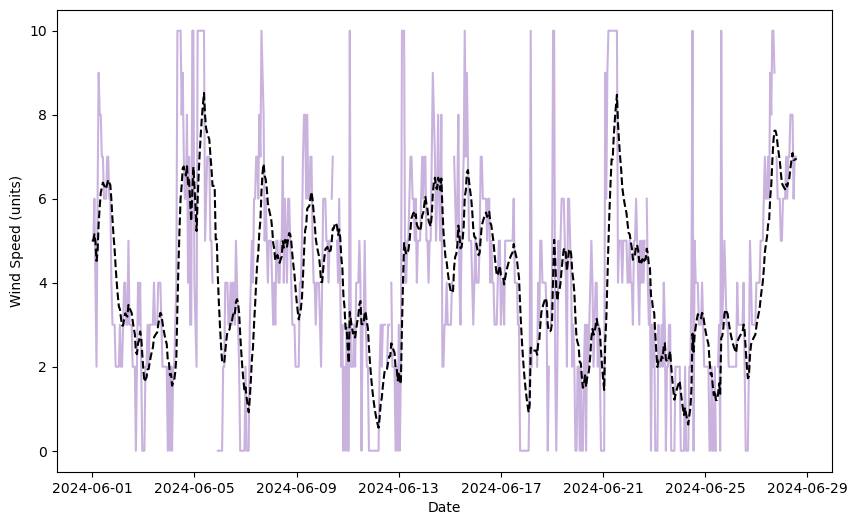

<Figure size 1000x600 with 0 Axes>

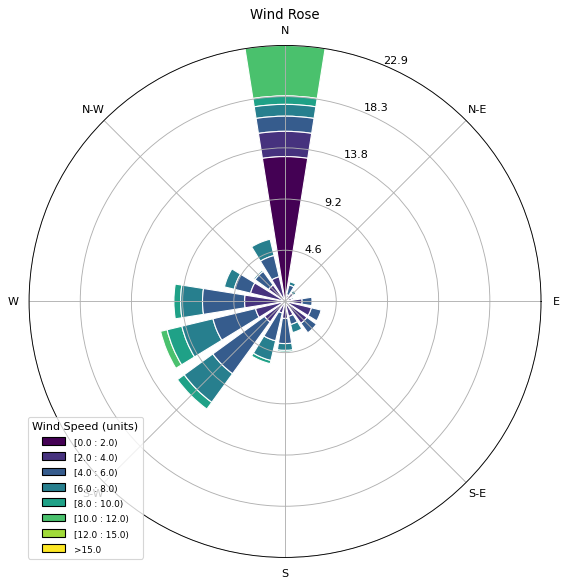

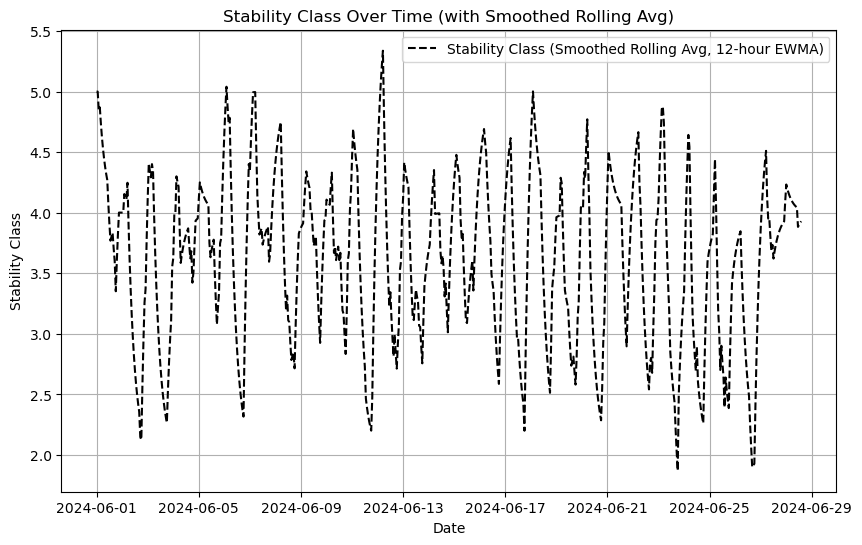

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [33]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5, 'F': 6})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


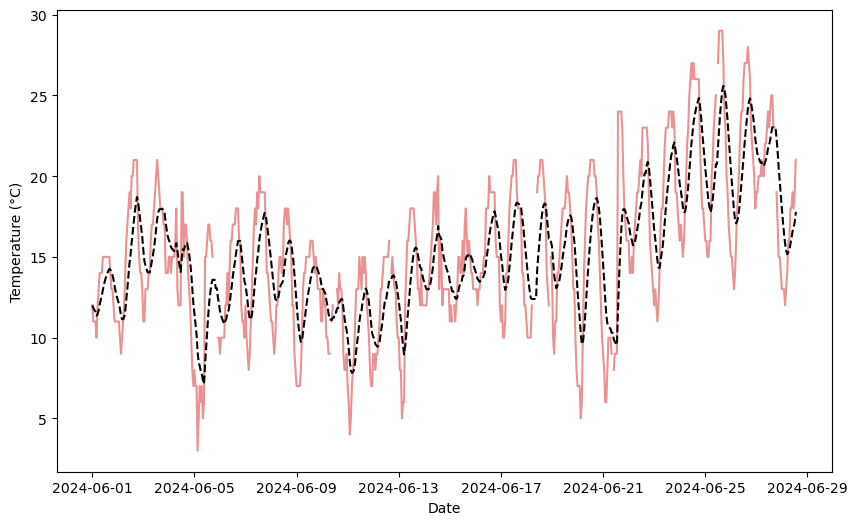

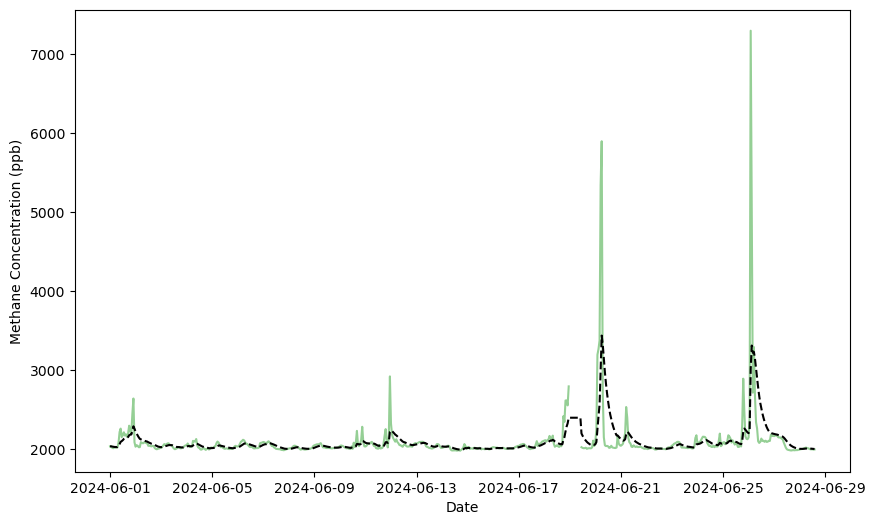

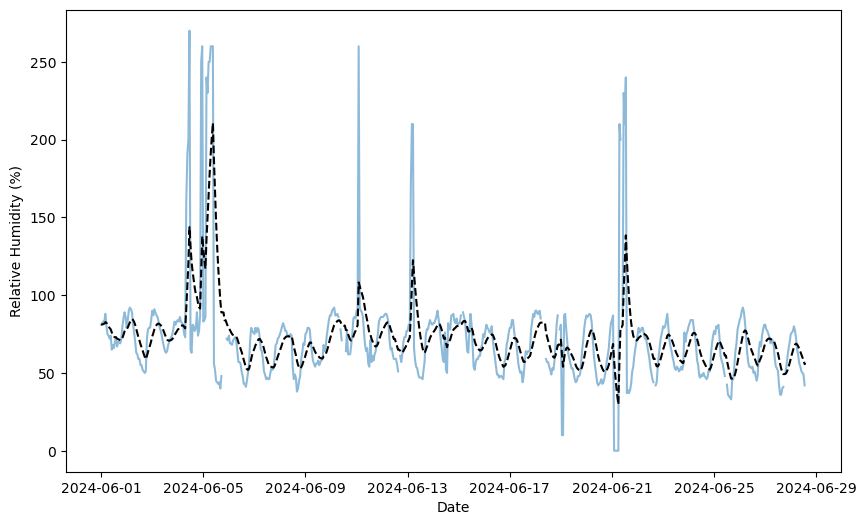

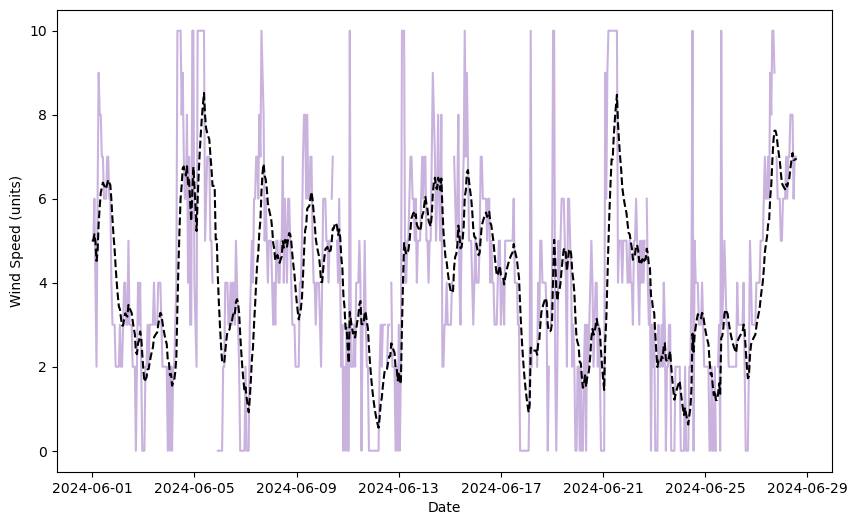

<Figure size 1000x600 with 0 Axes>

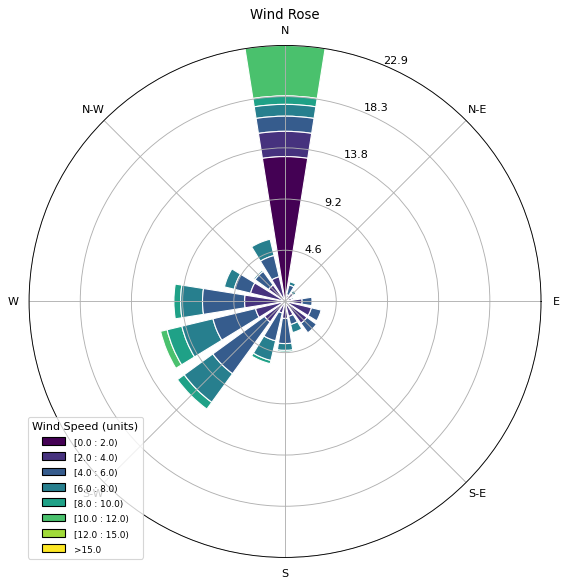

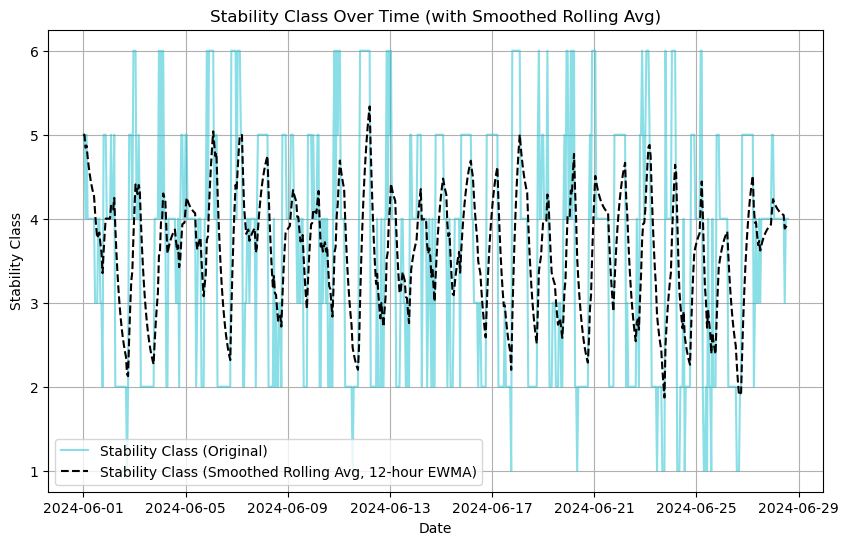

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [34]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')
ax.set_title('Wind Rose')
ax.set_legend(title='Wind Speed (units)')
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5, 'F': 6})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


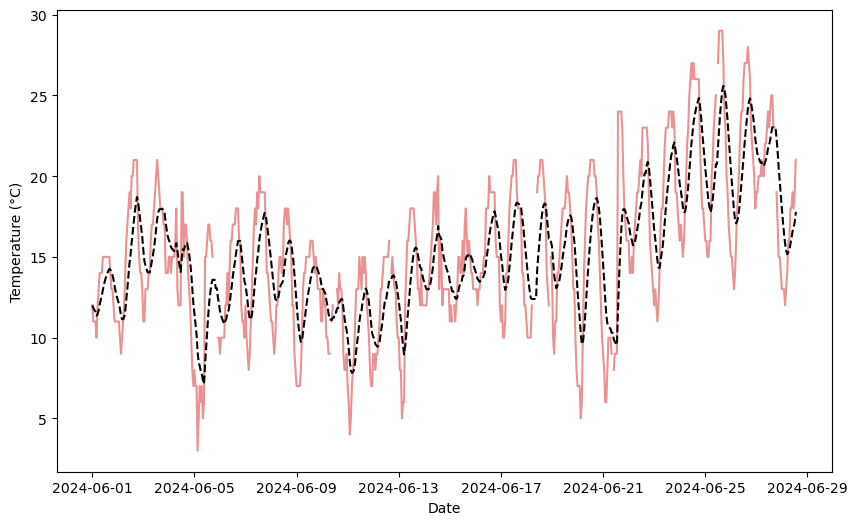

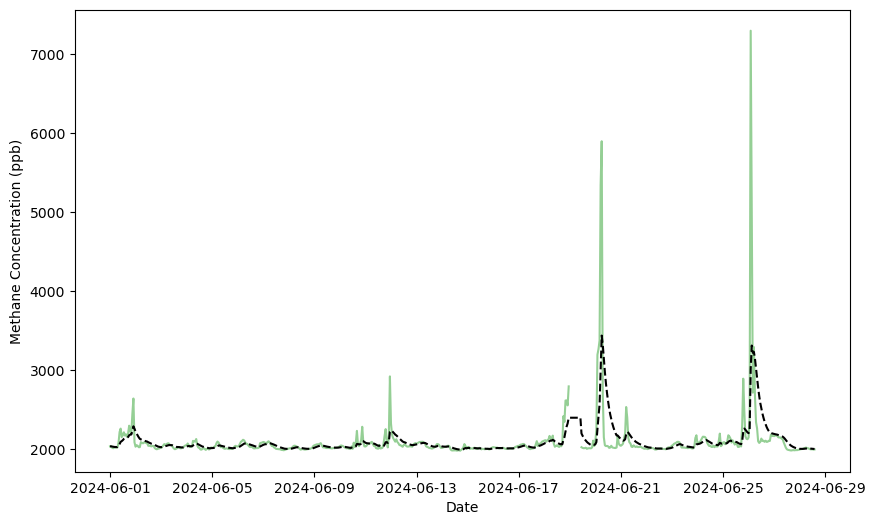

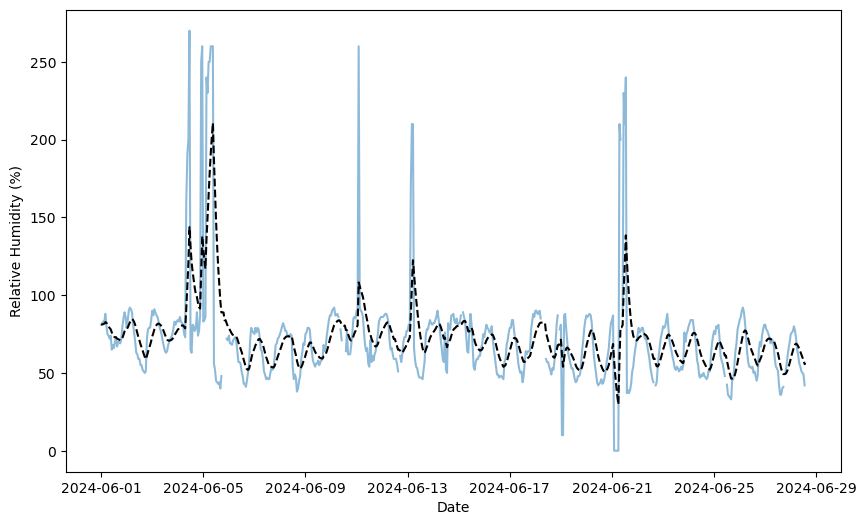

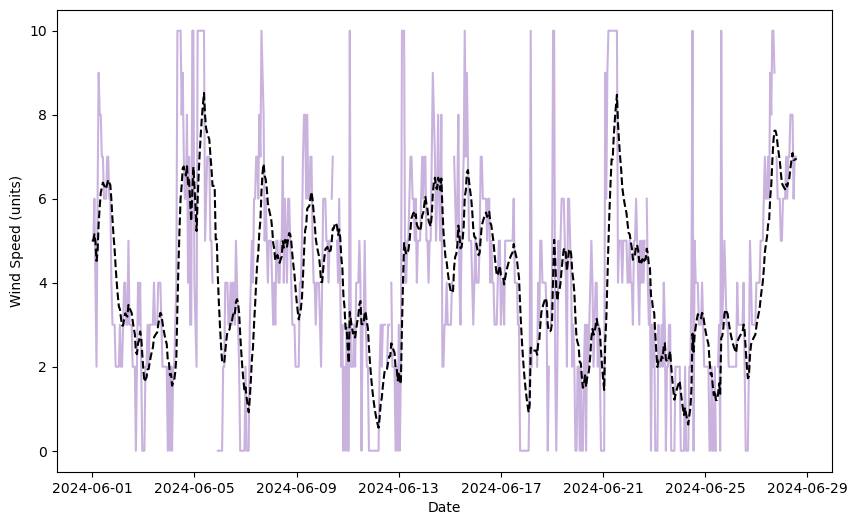

<Figure size 1000x600 with 0 Axes>

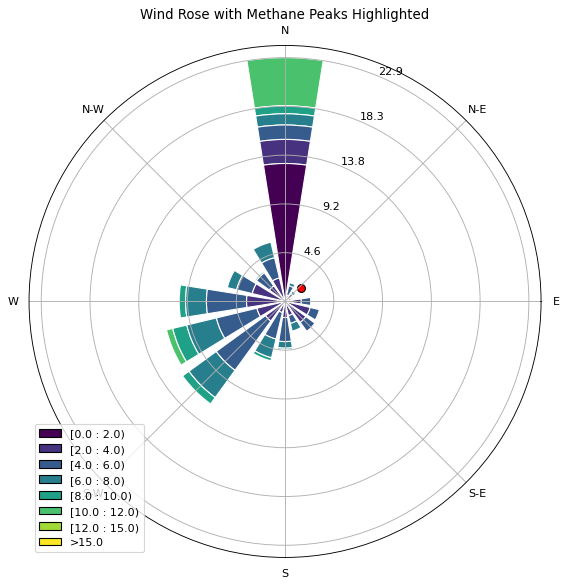

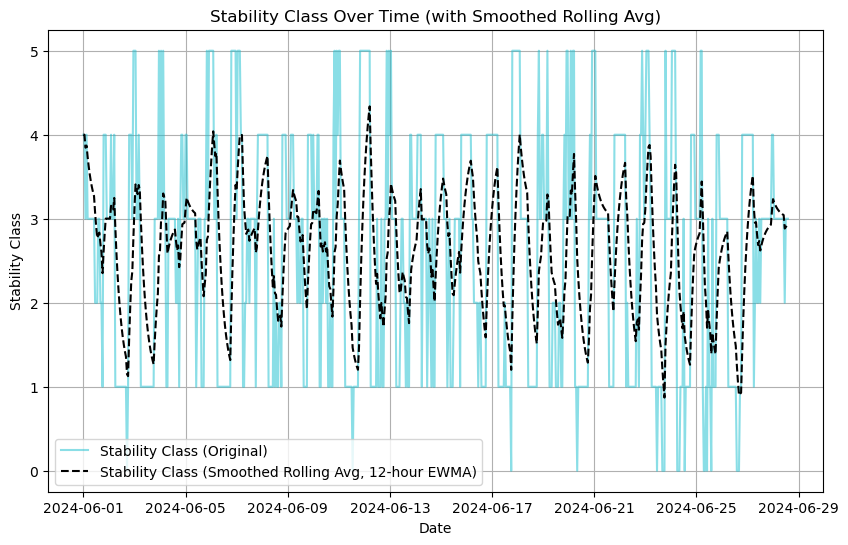

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [35]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the time of maximum methane concentration
ax.scatter([max_methane_wd], [max_methane_ws], color='red', s=50, label='Max Methane Peak', edgecolor='black')

ax.set_title('Wind Rose with Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


In [36]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the time of maximum methane concentration
ax.scatter([max_methane_wd], [max_methane_ws], color='red', s=50, label='Max Methane Peak', edgecolor='black')
ax.text(max_methane_wd, max_methane_ws, f'Time: {max_methane_time}'
Methane: {max_methane_value:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: EOL while scanning string literal (4096601.py, line 91)

In [37]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the time of maximum methane concentration
ax.scatter([max_methane_wd], [max_methane_ws], color='red', s=50, label='Max Methane Peak', edgecolor='black')
ax.text(max_methane_wd, max_methane_ws, f'Time: {max_methane_time}
Methane: {max_methane_value:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: EOL while scanning string literal (4096601.py, line 91)

In [38]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the time of maximum methane concentration
ax.scatter([max_methane_wd], [max_methane_ws], color='red', s=50, label='Max Methane Peak', edgecolor='black')
ax.text(max_methane_wd, max_methane_ws, f'Time: {max_methane_time}')
Methane: {max_methane_value:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: invalid syntax (2862908147.py, line 92)

In [39]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the time of maximum methane concentration
ax.scatter([max_methane_wd], [max_methane_ws], color='red', s=50, label='Max Methane Peak', edgecolor='black')
ax.text(max_methane_wd, max_methane_ws, f'Time: {max_methane_time}',
Methane: {max_methane_value:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: invalid syntax (1502501.py, line 92)

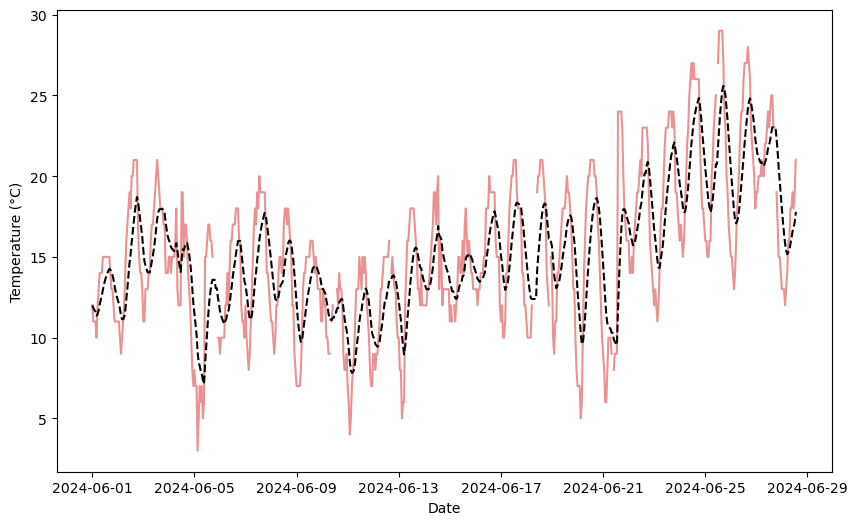

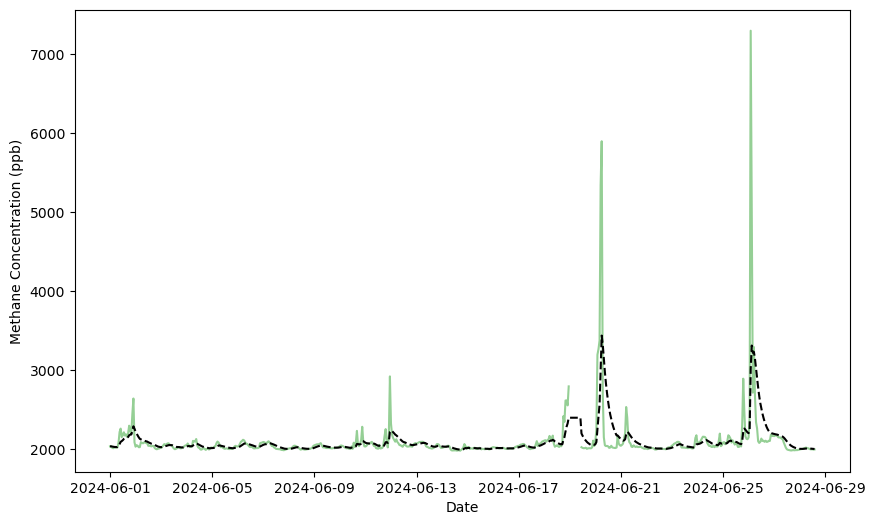

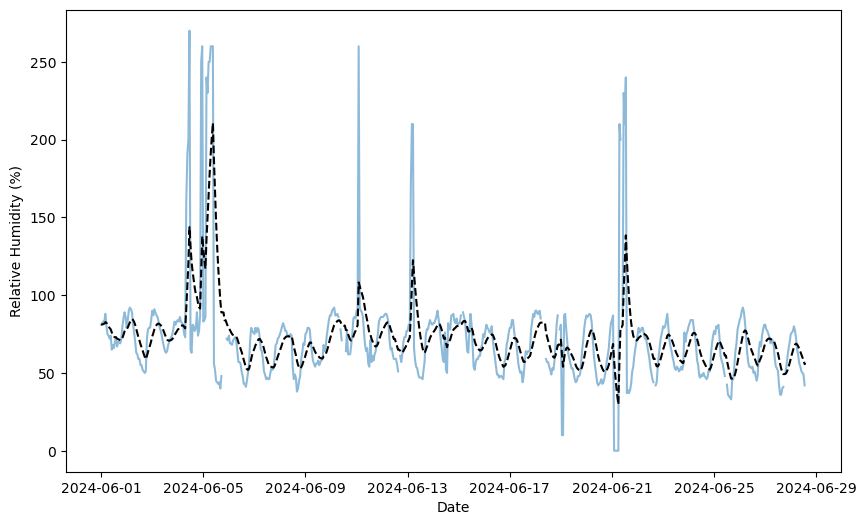

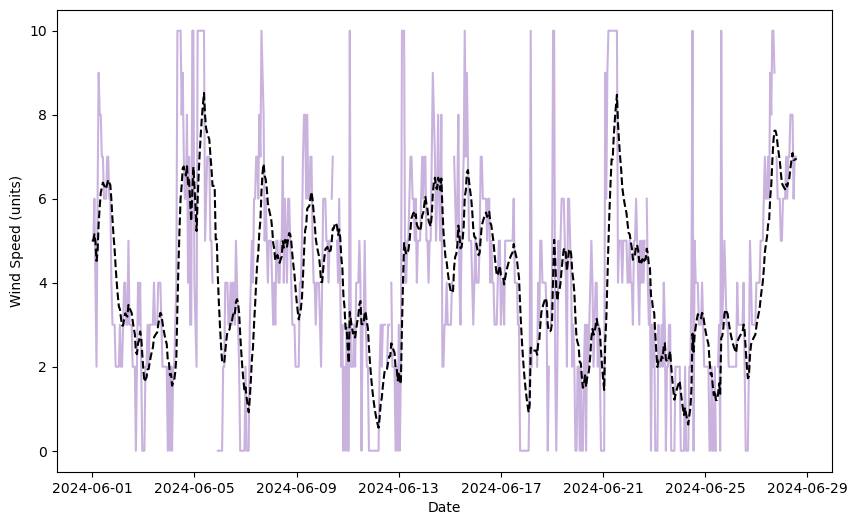

<Figure size 1000x600 with 0 Axes>

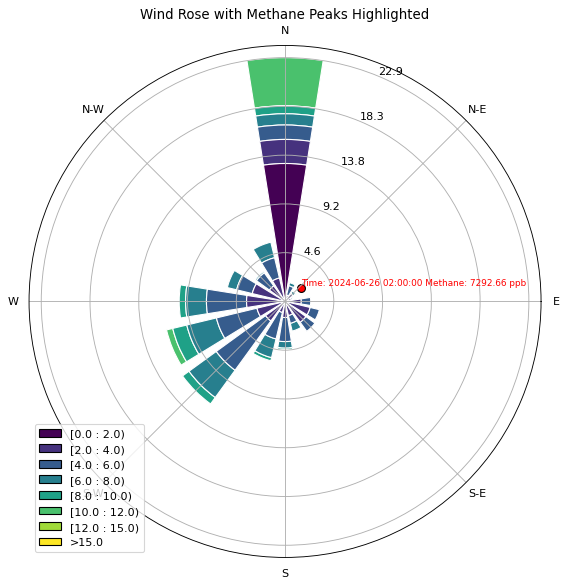

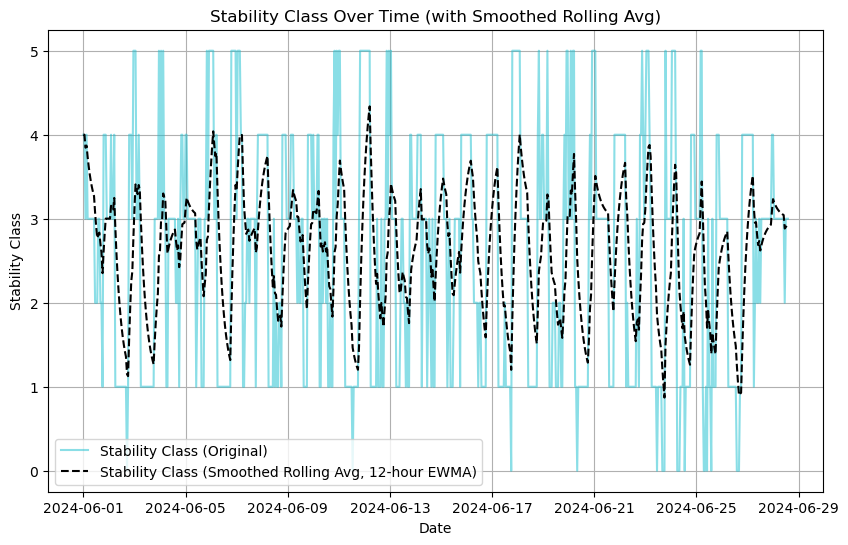

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [40]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the time of maximum methane concentration
ax.scatter([max_methane_wd], [max_methane_ws], color='red', s=50, label='Max Methane Peak', edgecolor='black')
ax.text(max_methane_wd, max_methane_ws, f'Time: {max_methane_time} Methane: {max_methane_value:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


In [41]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f'Time: {row['date']}
Methane: {row['ch4_ppb']:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: f-string: unmatched '[' (3299287969.py, line 93)

In [42]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f'Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb', fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: f-string: unmatched '[' (4017623456.py, line 93)

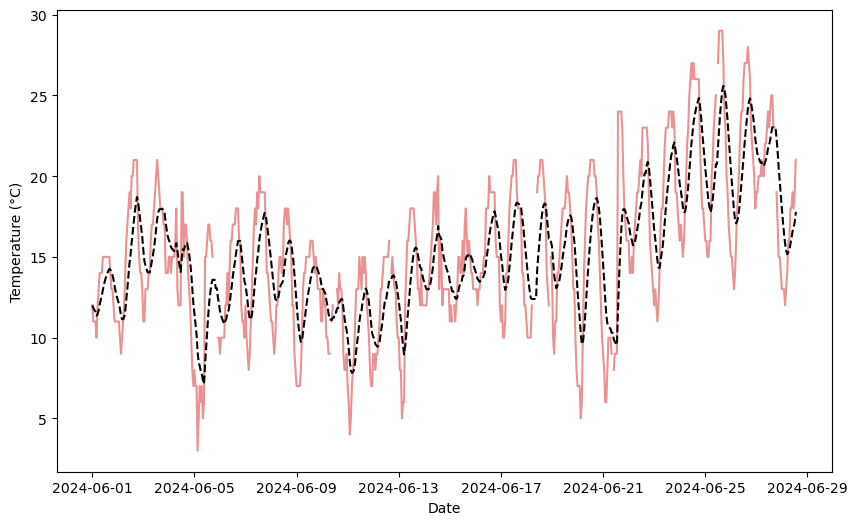

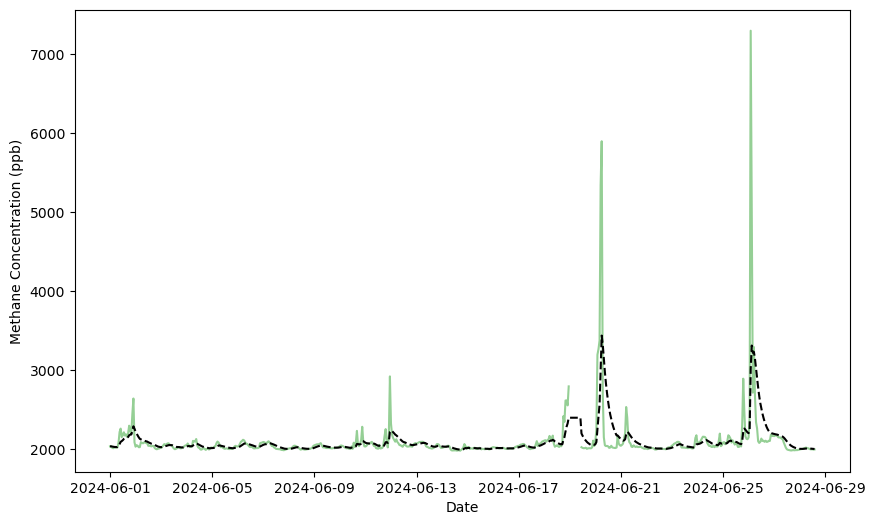

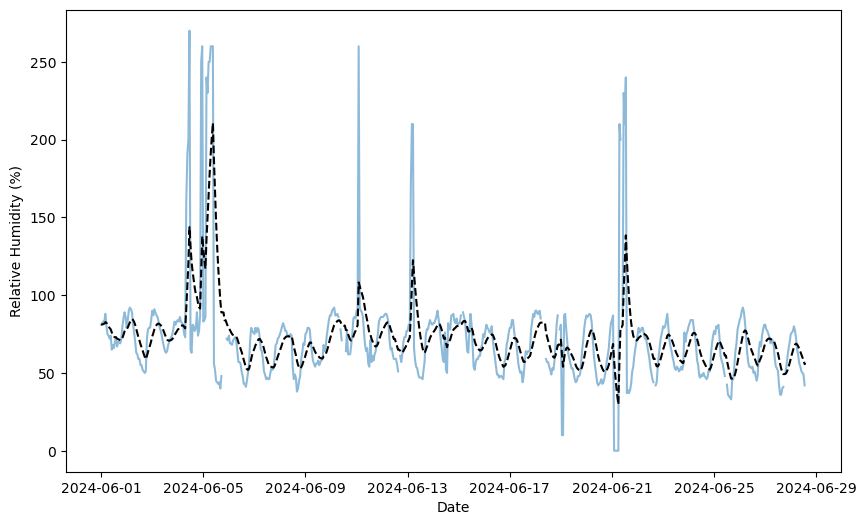

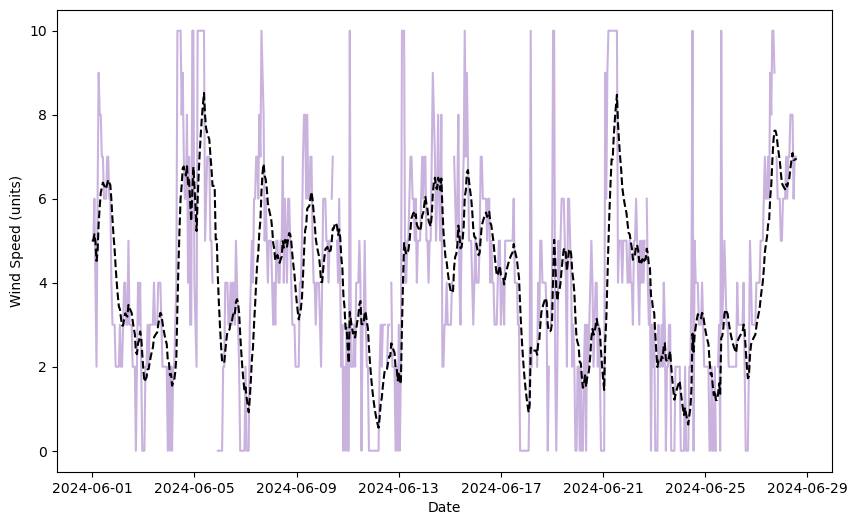

<Figure size 1000x600 with 0 Axes>

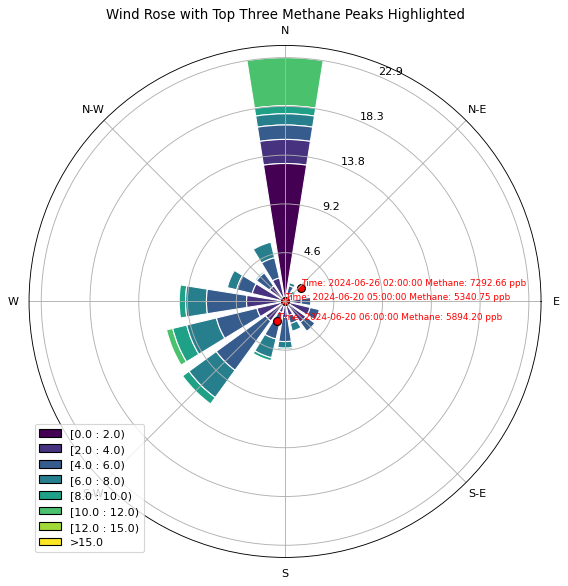

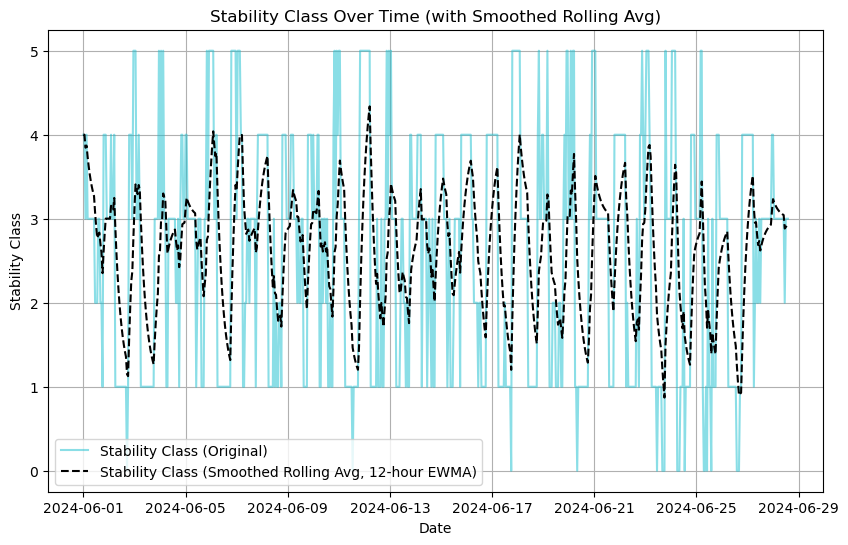

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [43]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.
def plot_time_series(x, y, label, ylabel, title, color, window=12):
    # Use an exponentially weighted moving average (EWMA) to smooth the rolling average
    # EWMA gives more weight to recent values, making it responsive to changes while still smoothing noise.
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    rolling_std = y.rolling(window=window).std()
    plt.figure(figsize=(10, 6))
    plt.plot(x, y, label=label, color=color, alpha=0.5)
    plt.xlabel('Date')
    plt.ylabel(ylabel)
    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time
plot_time_series(data['date'], data['temp'], label='Temperature (°C)', ylabel='Temperature (°C)', title='Temperature Over Time', color='tab:red')

# Plot Methane (CH4) Concentration in ppb over Time
plot_time_series(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', ylabel='Methane Concentration (ppb)', title='Methane (CH₄) Concentration Over Time', color='tab:green')

# Plot Relative Humidity (RH) over Time
plot_time_series(data['date'], data['rh'], label='Relative Humidity (%)', ylabel='Relative Humidity (%)', title='Relative Humidity Over Time', color='tab:blue')

# Plot Wind Speed over Time
plot_time_series(data['date'], data['ws'], label='Wind Speed', ylabel='Wind Speed (units)', title='Wind Speed Over Time', color='tab:purple')

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")



In [44]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 10))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time


# Plot Methane (CH4) Concentration in ppb over Time


# Plot Relative Humidity (RH) over Time


# Plot Wind Speed over Time


# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


SyntaxError: invalid syntax (4024258137.py, line 78)

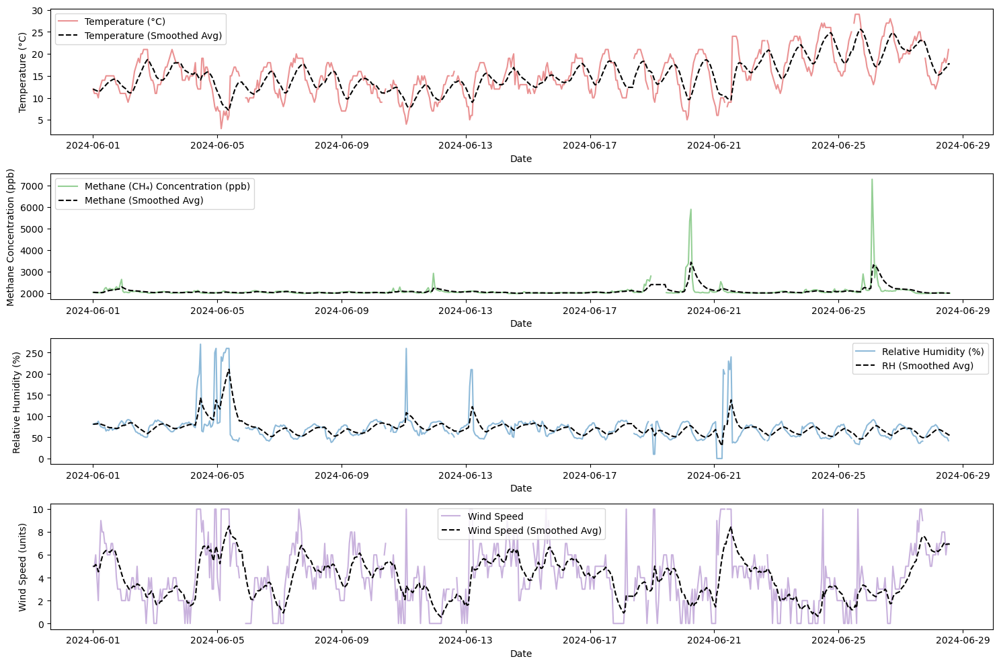

NameError: name 'x' is not defined

In [45]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 10))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    
plt.plot(x, rolling_avg, label=f'{label} (Smoothed Rolling Avg, {window}-hour EWMA)', color='black', linestyle='--')
    
# Plot Temperature over Time


# Plot Methane (CH4) Concentration in ppb over Time


# Plot Relative Humidity (RH) over Time


# Plot Wind Speed over Time


# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


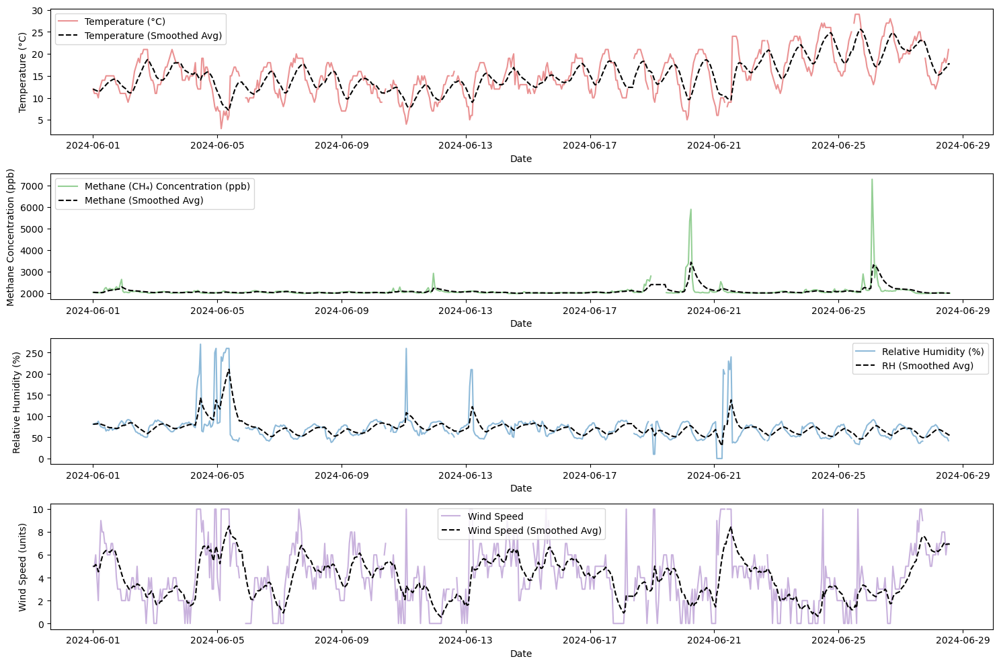

<Figure size 1000x600 with 0 Axes>

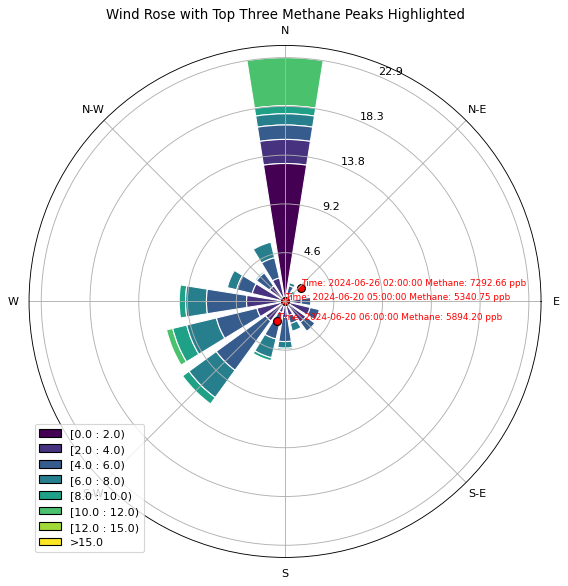

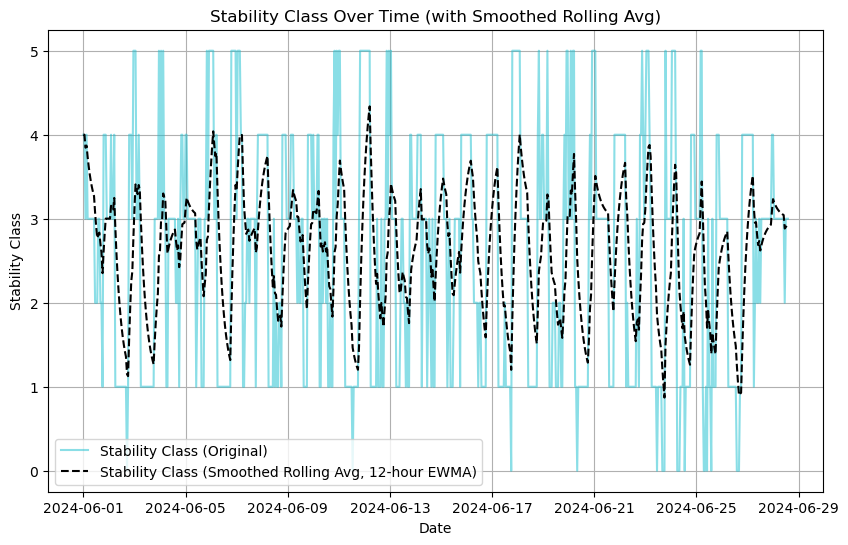

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [46]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 10))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


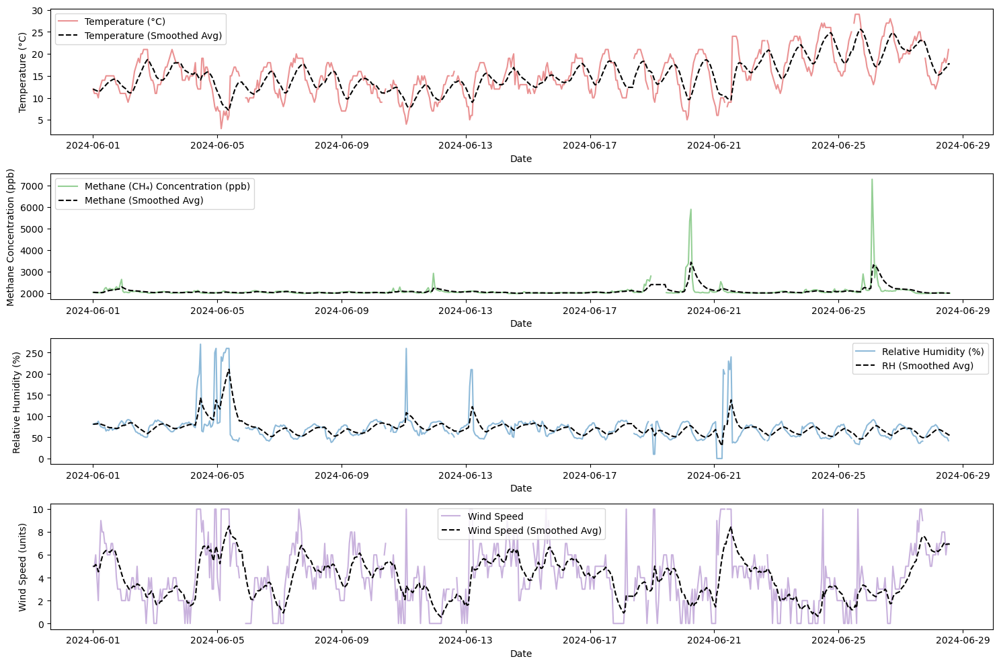

<Figure size 1000x600 with 0 Axes>

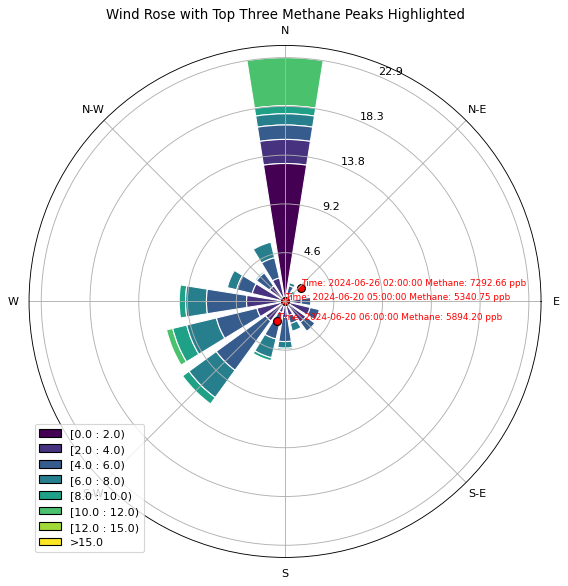

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [47]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 10))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


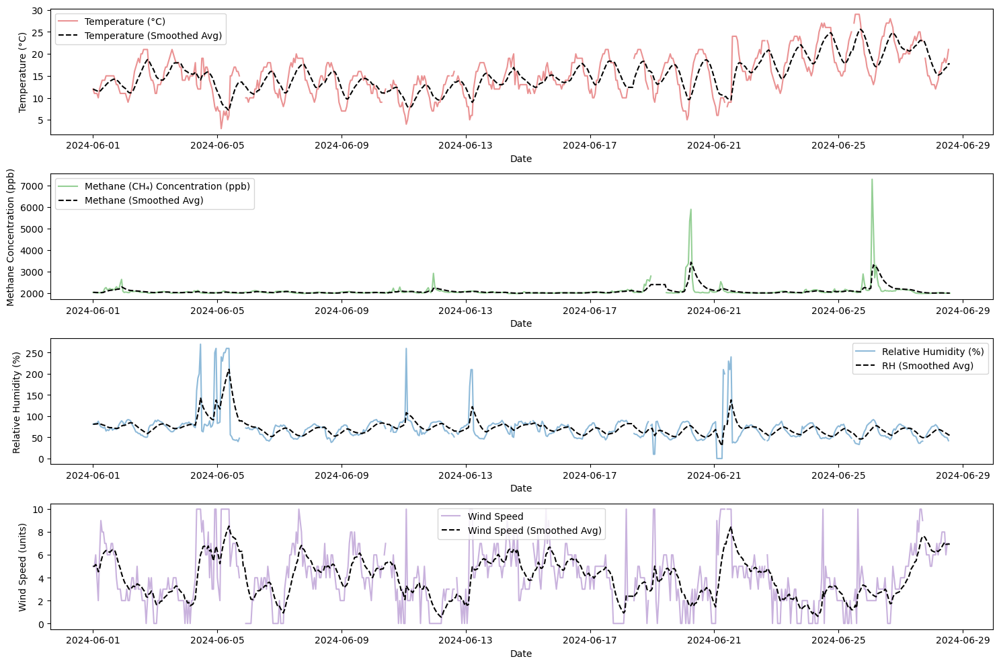

<Figure size 1000x600 with 0 Axes>

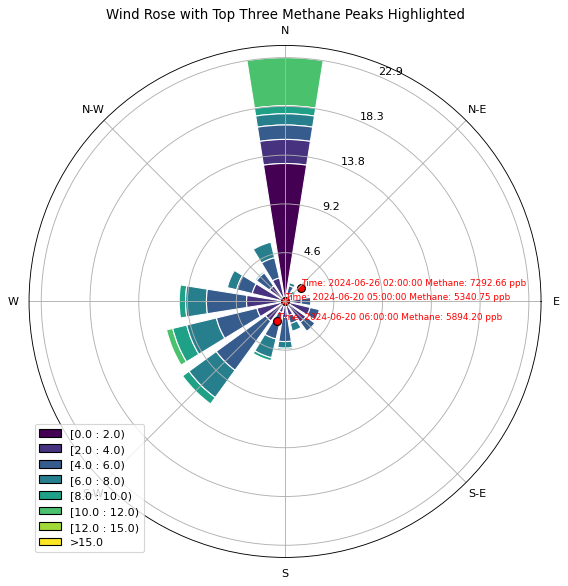

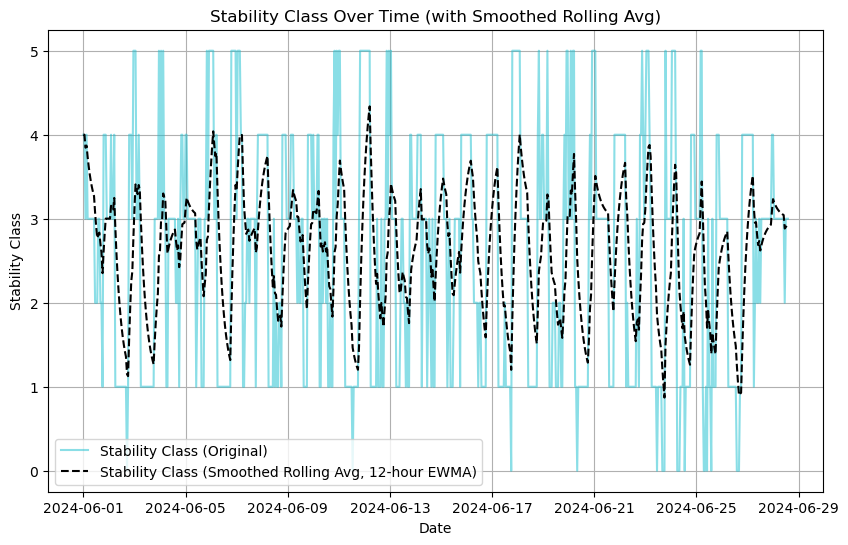

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: D


In [48]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 10))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=f'Methane Peak {idx + 1}', edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        elif 5 <= wind_speed <= 6:
            return 'C'  # Slightly Unstable
        else:
            return 'D'  # Neutral
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 3 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


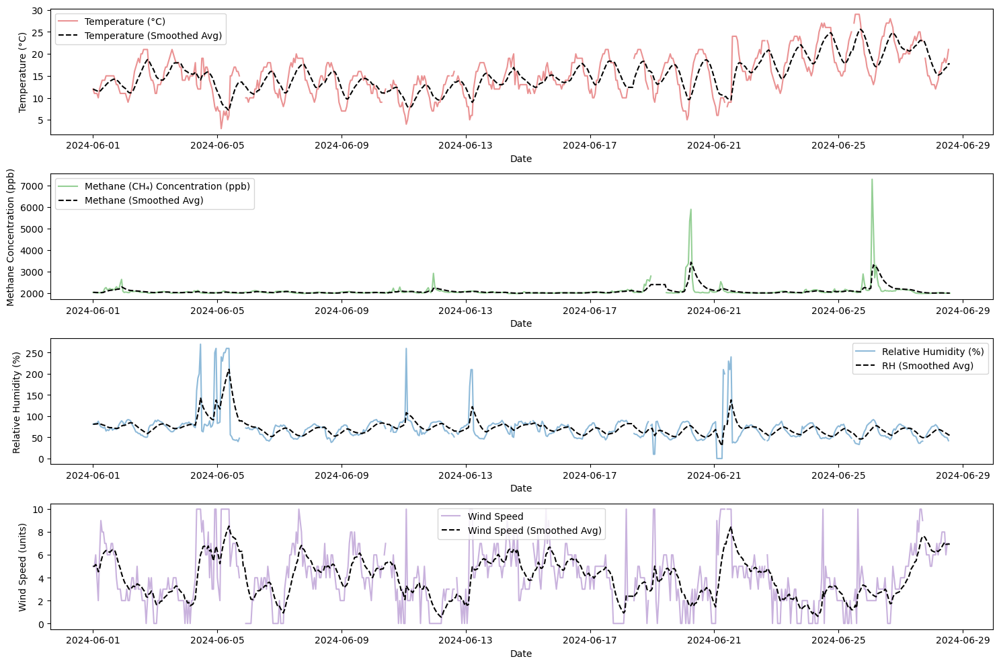

<Figure size 1000x600 with 0 Axes>

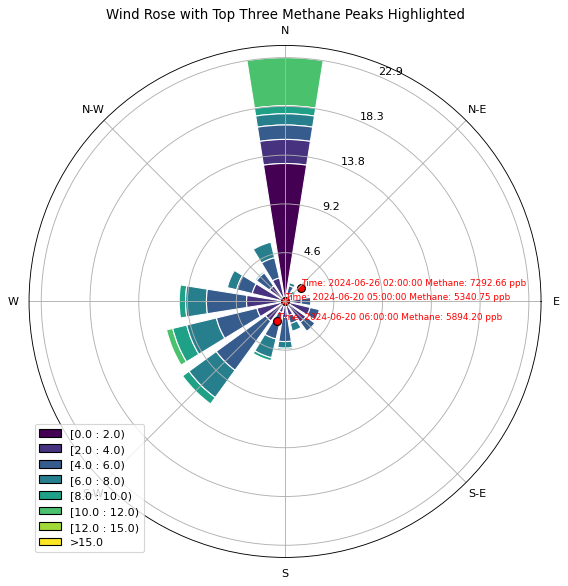

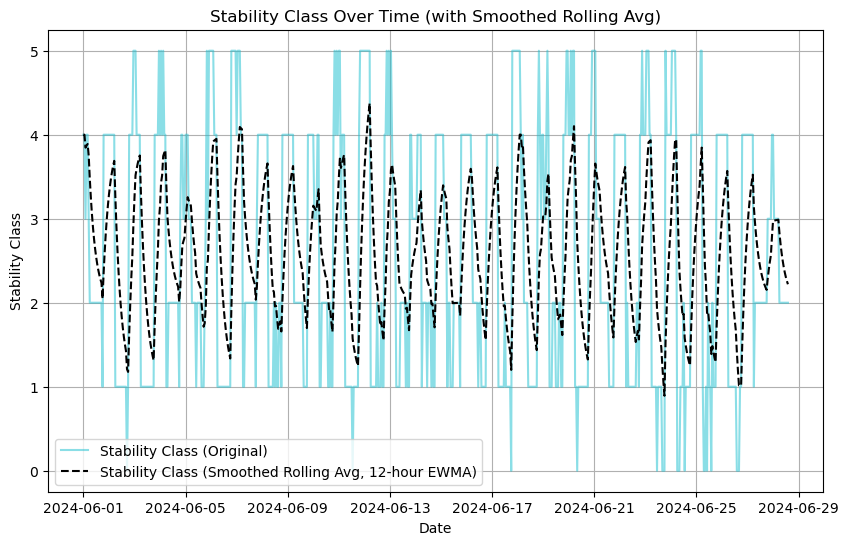

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [49]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 10))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    label = f'Methane Peak {idx + 1}' if idx == 0 else None  # Avoid duplicate labels in the legend
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=label, edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Plot Stability Class as Time Series
plt.figure(figsize=(10, 6))
# Use an exponentially weighted moving average (EWMA) to smooth the stability class
stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
rolling_avg_stability = stability_class_numeric.ewm(span=12, adjust=False).mean()
plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg, 12-hour EWMA)', color='black', linestyle='--')
plt.xlabel('Date')
plt.ylabel('Stability Class')
plt.title('Stability Class Over Time (with Smoothed Rolling Avg)')
plt.grid(True)
plt.legend()
plt.show()


# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


KeyError: 'stability_class'

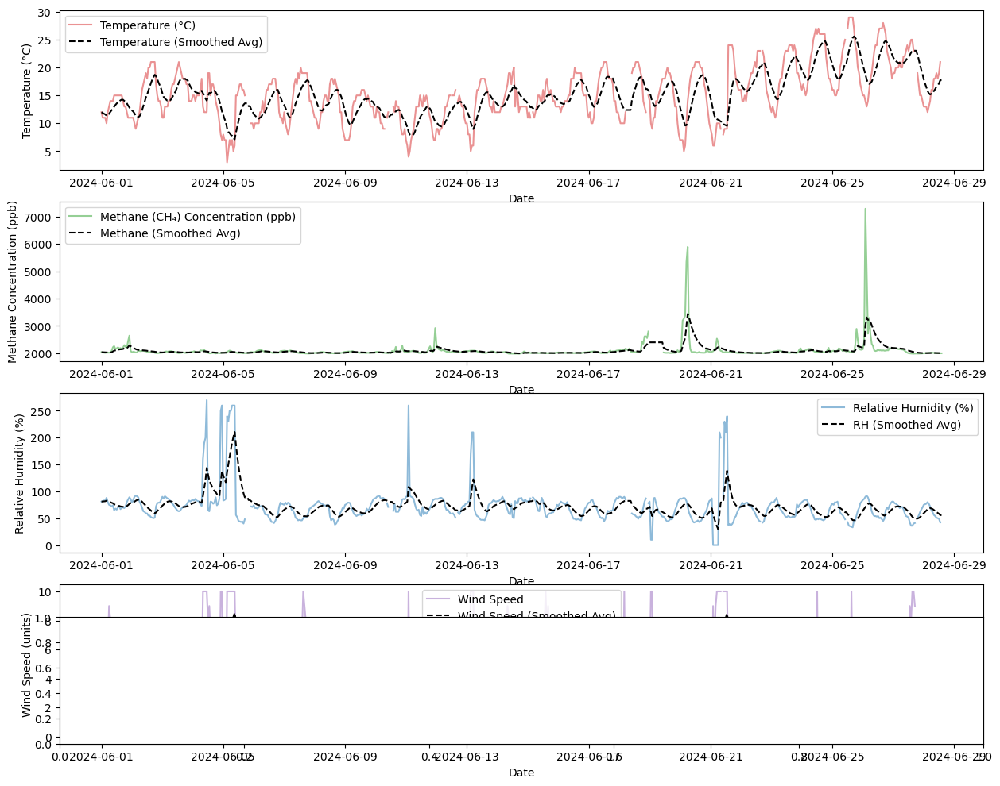

In [50]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()


# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 12))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

        # Stability Class
    plt.subplot(5, 1, 5)
    stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
    rolling_avg_stability = stability_class_numeric.ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
    plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Stability Class')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)



# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    label = f'Methane Peak {idx + 1}' if idx == 0 else None  # Avoid duplicate labels in the legend
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=label, edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()



# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


/var/folders/86/d5n0l2wj5yn0p84q_4jzm_6r0000gn/T/ipykernel_82492/1046855639.py:105: UserWarning: tight_layout not applied: number of rows in subplot specifications must be multiples of one another.
  plt.tight_layout()


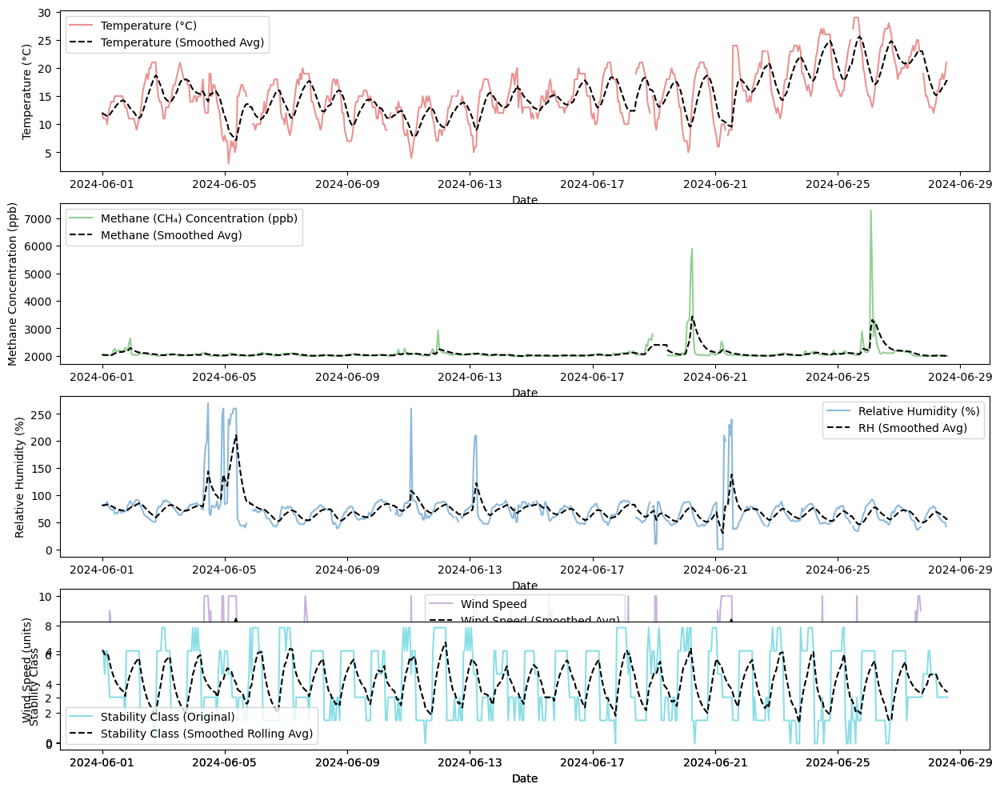

<Figure size 1000x600 with 0 Axes>

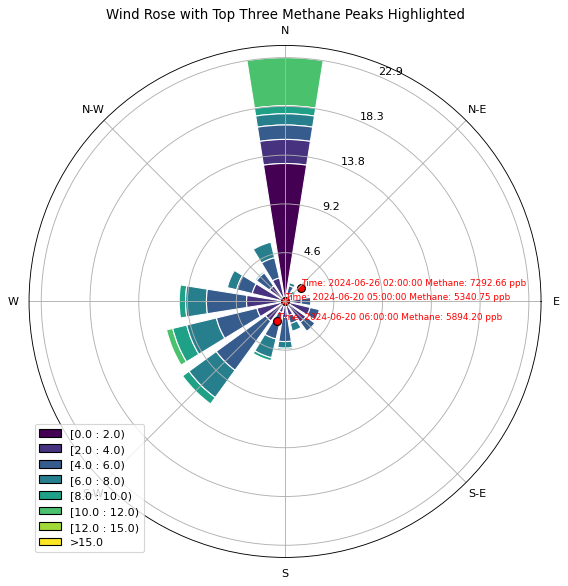

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [51]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral


# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 12))

    # Temperature
    plt.subplot(4, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(4, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(4, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(4, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

        # Stability Class
    plt.subplot(5, 1, 5)
    stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
    rolling_avg_stability = stability_class_numeric.ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
    plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Stability Class')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    




# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    label = f'Methane Peak {idx + 1}' if idx == 0 else None  # Avoid duplicate labels in the legend
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=label, edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()



# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


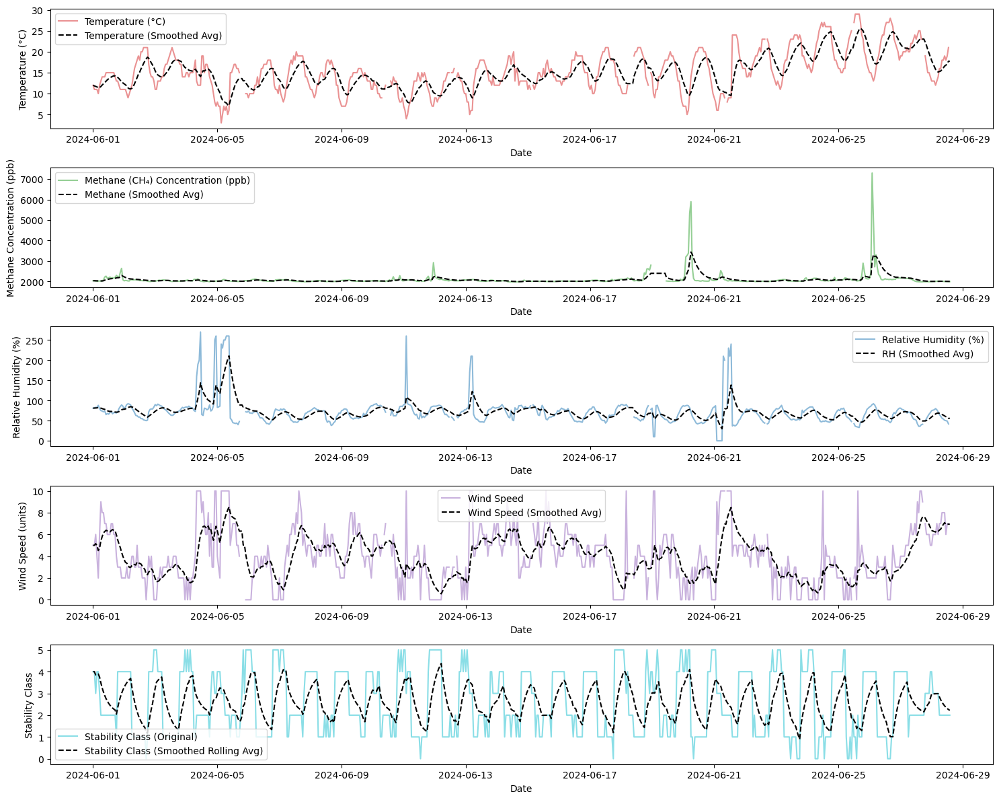

<Figure size 1000x600 with 0 Axes>

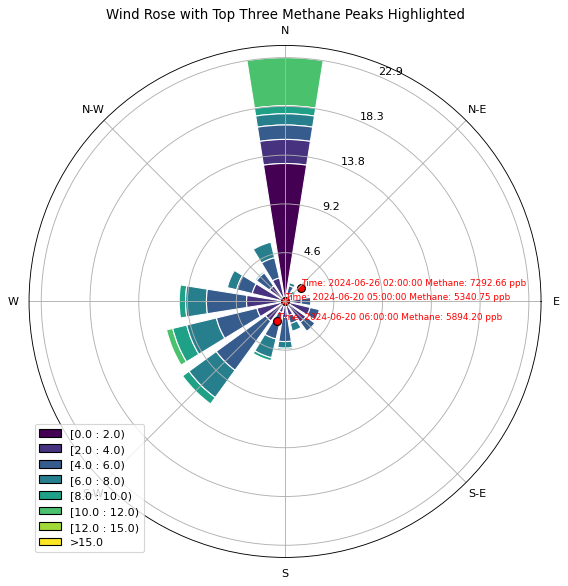

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [52]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral


# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Function to create combined time series plots with rolling average
# Note: Using an Exponentially Weighted Moving Average (EWMA) to smooth the rolling average.
# EWMA is preferred here because it gives more weight to recent values, allowing the average to adapt more quickly to changes in the data while still providing a smoothing effect.

def plot_combined_time_series(data, window=12):
    plt.figure(figsize=(15, 12))

    # Temperature
    plt.subplot(5, 1, 1)
    rolling_avg_temp = data['temp'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['temp'], label='Temperature (°C)', color='tab:red', alpha=0.5)
    plt.plot(data['date'], rolling_avg_temp, label='Temperature (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend()

    # Methane Concentration
    plt.subplot(5, 1, 2)
    rolling_avg_ch4 = data['ch4_ppb'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ch4_ppb'], label='Methane (CH₄) Concentration (ppb)', color='tab:green', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ch4, label='Methane (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Methane Concentration (ppb)')
    plt.legend()

    # Relative Humidity
    plt.subplot(5, 1, 3)
    rolling_avg_rh = data['rh'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['rh'], label='Relative Humidity (%)', color='tab:blue', alpha=0.5)
    plt.plot(data['date'], rolling_avg_rh, label='RH (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Relative Humidity (%)')
    plt.legend()

    # Wind Speed
    plt.subplot(5, 1, 4)
    rolling_avg_ws = data['ws'].ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], data['ws'], label='Wind Speed', color='tab:purple', alpha=0.5)
    plt.plot(data['date'], rolling_avg_ws, label='Wind Speed (Smoothed Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Wind Speed (units)')
    plt.legend()

        # Stability Class
    plt.subplot(5, 1, 5)
    stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
    rolling_avg_stability = stability_class_numeric.ewm(span=window, adjust=False).mean()
    plt.plot(data['date'], stability_class_numeric, label='Stability Class (Original)', color='tab:cyan', alpha=0.5)
    plt.plot(data['date'], rolling_avg_stability, label='Stability Class (Smoothed Rolling Avg)', color='black', linestyle='--')
    plt.xlabel('Date')
    plt.ylabel('Stability Class')
    plt.legend()

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)    




# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    label = f'Methane Peak {idx + 1}' if idx == 0 else None  # Avoid duplicate labels in the legend
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=label, edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()



# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


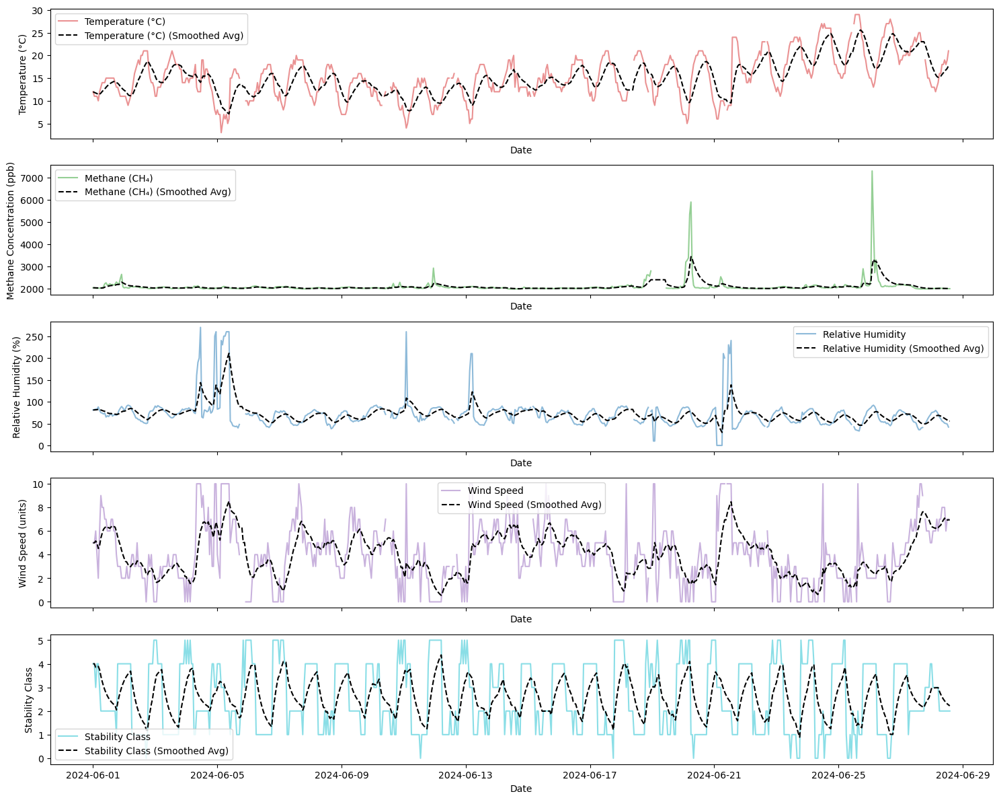

<Figure size 1000x600 with 0 Axes>

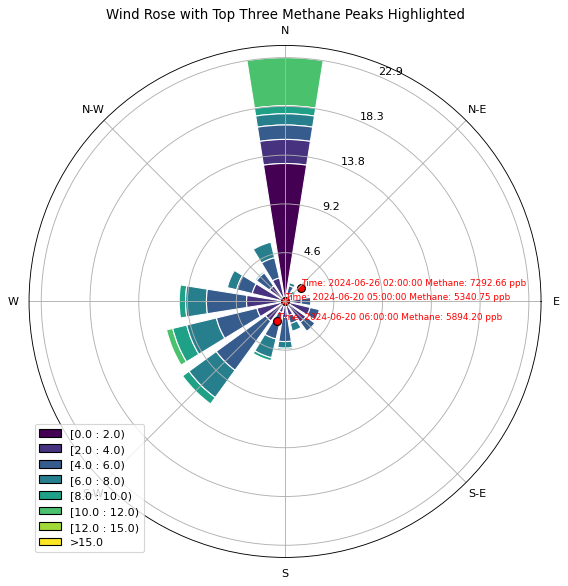

Maximum Methane Concentration: 7292.661169 ppb
Time: 2024-06-26 02:00:00
Wind Speed: 2.0
Wind Direction: 340.0
Pasquill-Gifford Stability Class: E


In [53]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.projections.polar import PolarAxes
from windrose import WindroseAxes
import matplotlib.animation as animation

# Load the dataset
file_path = 'data/msr_ch4_met_hrly_310524_270924.csv'
try:
    data = pd.read_csv(file_path)

    # Convert 'date' column to datetime format
    data['date'] = pd.to_datetime(data['date'], format='%Y-%m-%d %H:%M:%S')

    # Filter data to only include June and July 2024
    data = data[(data['date'] >= '2024-06-01') & (data['date'] <= '2024-07-01')]
except FileNotFoundError:
    print(f"Error: The file {file_path} was not found.")
    exit()
except pd.errors.EmptyDataError:
    print(f"Error: The file {file_path} is empty.")
    exit()
except pd.errors.ParserError:
    print(f"Error: The file {file_path} could not be parsed.")
    exit()

# Function to determine Pasquill-Gifford stability class
def determine_stability_class(row):
    hour = row['date'].hour
    wind_speed = row['ws']
    
    if 6 <= hour <= 18:  # Daytime hours (approx. 6 AM to 6 PM)
        if wind_speed < 2:
            return 'A'  # Very Unstable
        elif 2 <= wind_speed <= 5:
            return 'B'  # Moderately Unstable
        else:
            return 'C'  # Slightly Unstable
    else:  # Nighttime hours
        if wind_speed < 2:
            return 'F'  # Stable
        elif 2 <= wind_speed <= 5:
            return 'E'  # Slightly Stable
        else:
            return 'D'  # Neutral

# Apply the function to the dataframe
data['stability_class'] = data.apply(determine_stability_class, axis=1)

# Function to create individual time series subplots with rolling average
def plot_time_series_subplot(ax, x, y, ylabel, label, color, window):
    rolling_avg = y.ewm(span=window, adjust=False).mean()
    ax.plot(x, y, label=label, color=color, alpha=0.5)
    ax.plot(x, rolling_avg, label=f'{label} (Smoothed Avg)', color='black', linestyle='--')
    ax.set_xlabel('Date')
    ax.set_ylabel(ylabel)
    ax.legend()

# Function to create combined time series plots
def plot_combined_time_series(data, window=12):
    fig, axes = plt.subplots(5, 1, figsize=(15, 12), sharex=True)

    # Plot Temperature
    plot_time_series_subplot(axes[0], data['date'], data['temp'], 'Temperature (°C)', 'Temperature (°C)', 'tab:red', window)

    # Plot Methane Concentration
    plot_time_series_subplot(axes[1], data['date'], data['ch4_ppb'], 'Methane Concentration (ppb)', 'Methane (CH₄)', 'tab:green', window)

    # Plot Relative Humidity
    plot_time_series_subplot(axes[2], data['date'], data['rh'], 'Relative Humidity (%)', 'Relative Humidity', 'tab:blue', window)

    # Plot Wind Speed
    plot_time_series_subplot(axes[3], data['date'], data['ws'], 'Wind Speed (units)', 'Wind Speed', 'tab:purple', window)

    # Plot Stability Class
    stability_class_numeric = data['stability_class'].map({'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5})
    plot_time_series_subplot(axes[4], data['date'], stability_class_numeric, 'Stability Class', 'Stability Class', 'tab:cyan', window)

    plt.tight_layout()
    plt.show()

plot_combined_time_series(data)

# Plot Wind Rose Chart with Methane Peaks Highlighted
plt.figure(figsize=(10, 6))
ax = WindroseAxes.from_ax()
custom_bins = [0, 2, 4, 6, 8, 10, 12, 15]
ax.bar(data['wd'], data['ws'], bins=custom_bins, normed=True, opening=0.8, edgecolor='white')

# Highlight the wind direction and speed at the top three methane concentrations
max_methane_rows = data.nlargest(3, 'ch4_ppb')
for idx, row in max_methane_rows.iterrows():
    label = f'Methane Peak {idx + 1}' if idx == 0 else None  # Avoid duplicate labels in the legend
    ax.scatter(row['wd'], row['ws'], color='red', s=50, label=label, edgecolor='black')
    ax.text(row['wd'], row['ws'], f"Time: {row['date']} Methane: {row['ch4_ppb']:.2f} ppb", fontsize=8, color='red', ha='left', va='bottom')

ax.set_title('Wind Rose with Top Three Methane Peaks Highlighted')
ax.set_legend(title='Wind Speed (units)')
plt.legend()
plt.show()

# Find the maximum methane concentration and related data
max_methane_idx = data['ch4_ppb'].idxmax()
max_methane_row = data.loc[max_methane_idx]
max_methane_value = max_methane_row['ch4_ppb']
max_methane_time = max_methane_row['date']
max_methane_ws = max_methane_row['ws']
max_methane_wd = max_methane_row['wd']
max_methane_stability = max_methane_row['stability_class']

print(f"Maximum Methane Concentration: {max_methane_value} ppb")
print(f"Time: {max_methane_time}")
print(f"Wind Speed: {max_methane_ws}")
print(f"Wind Direction: {max_methane_wd}")
print(f"Pasquill-Gifford Stability Class: {max_methane_stability}")


In [54]:
import folium

# Coordinates from the dataset
lat_lon_1 = {'lat': 52.42, 'lon': 0.57}
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map centered around the average location of the two points
map_center = [(lat_lon_1['lat'] + lat_lon_2['latitude2']) / 2,
              (lat_lon_1['lon'] + lat_lon_2['longitude2']) / 2]

# Create a folium map object
m = folium.Map(location=map_center, zoom_start=10)

# Add markers for both points
folium.Marker(
    location=[lat_lon_1['lat'], lat_lon_1['lon']],
    popup='Coordinate Pair 1',
    icon=folium.Icon(color='red')
).add_to(m)

folium.Marker(
    location=[lat_lon_2['latitude2'], lat_lon_2['longitude2']],
    popup='Coordinate Pair 2',
    icon=folium.Icon(color='blue')
).add_to(m)

# Save the map to an HTML file
m.save('map_coordinates.html')

# To view the map, open 'map_coordinates.html' in a web browser.


In [57]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt

# Coordinates from the dataset
lat_lon_1 = {'lat': 52.42, 'lon': 0.57}
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a Stadia map tiler for the background with API key
tiles_url = "https://tiles.stadiamaps.com/tiles/alidade_smooth/{z}/{x}/{y}.png?api_key=e055cd8e-5ec7-479f-a3c1-1ed46dc8ee3c"
map_tiler = cimgt.OSM(url=tiles_url)

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([min(lat_lon_1['lon'], lat_lon_2['longitude2']) - 0.1,
               max(lat_lon_1['lon'], lat_lon_2['longitude2']) + 0.1,
               min(lat_lon_1['lat'], lat_lon_2['latitude2']) - 0.1,
               max(lat_lon_1['lat'], lat_lon_2['latitude2']) + 0.1], crs=ccrs.PlateCarree())

# Add the street map tiles to the background
ax.add_image(map_tiler, 10)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the points on the map
ax.plot(lat_lon_1['lon'], lat_lon_1['lat'], 'ro', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 1')
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding labels for each point
ax.text(lat_lon_1['lon'] + 0.01, lat_lon_1['lat'], "Point 1", transform=ccrs.PlateCarree(), fontsize=12, color='red')
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinates Using Cartopy with Stadia Maps Overlay")
plt.legend()

# Display the plot
plt.show()


TypeError: __init__() got an unexpected keyword argument 'url'

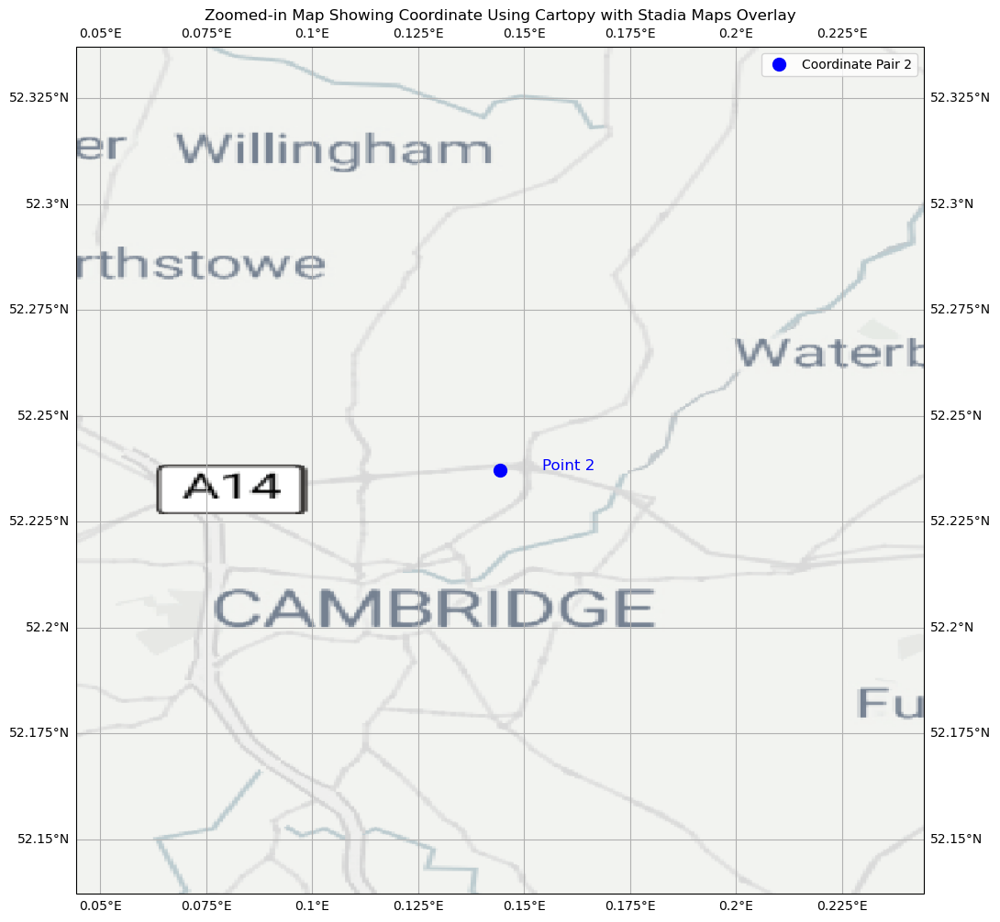

In [59]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a Stadia map tiler for the background with API key
map_tiler = cimgt.StadiaMapsTiles('e055cd8e-5ec7-479f-a3c1-1ed46dc8ee3c', resolution='@2x')

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.1,
               lat_lon_2['longitude2'] + 0.1,
               lat_lon_2['latitude2'] - 0.1,
               lat_lon_2['latitude2'] + 0.1], crs=ccrs.PlateCarree())

# Add the street map tiles to the background
ax.add_image(map_tiler, 10)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with Stadia Maps Overlay")
plt.legend()

# Display the plot
plt.show()


In [68]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a Google Satellite map tiler for the background with API key
tiles_url = "https://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}&api_key=e055cd8e-5ec7-479f-a3c1-1ed46dc8ee3c"
map_tiler = cimgt.OSM(url=tiles_url)

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.1,
               lat_lon_2['longitude2'] + 0.1,
               lat_lon_2['latitude2'] - 0.1,
               lat_lon_2['latitude2'] + 0.1], crs=ccrs.PlateCarree())

# Add the satellite imagery tiles to the background
ax.add_image(map_tiler, 10)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with Satellite Imagery Overlay")
plt.legend()

# Display the plot
plt.show()


TypeError: __init__() got an unexpected keyword argument 'url'

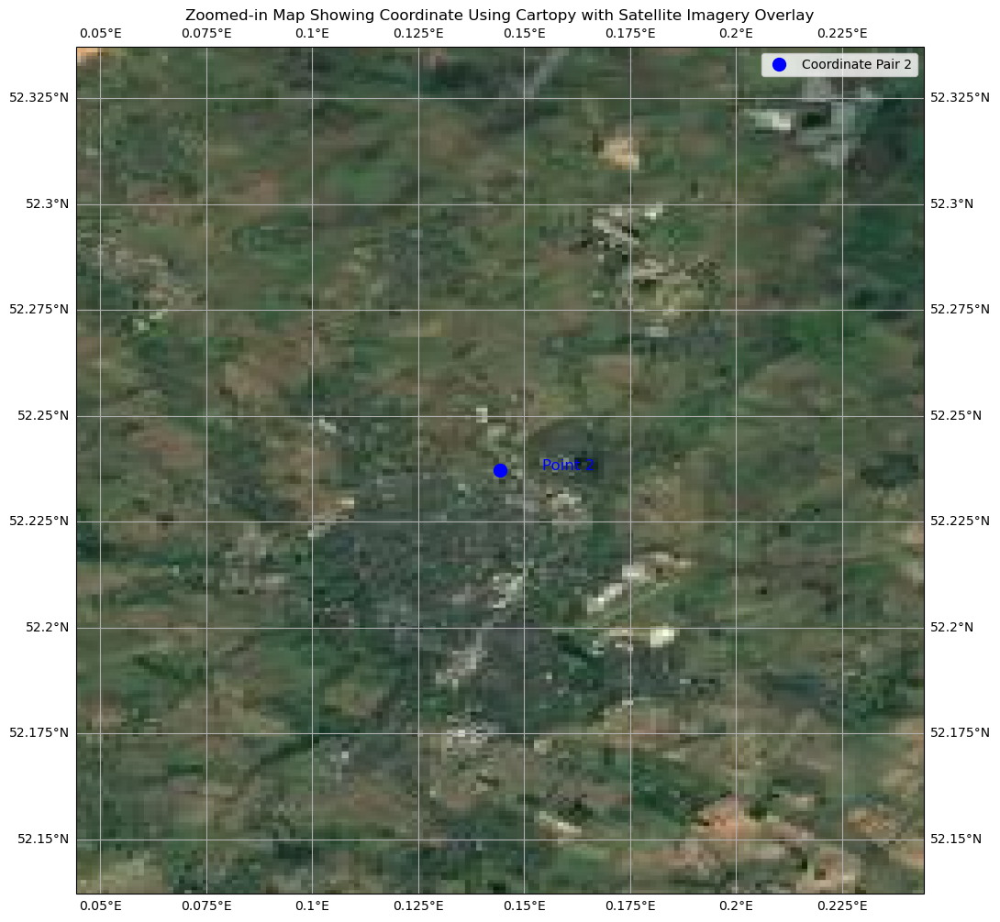

In [69]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map tiler using Google Satellite imagery (using built-in GoogleTiles from cartopy)
map_tiler = cimgt.GoogleTiles(style='satellite')

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(12, 12), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.1,
               lat_lon_2['longitude2'] + 0.1,
               lat_lon_2['latitude2'] - 0.1,
               lat_lon_2['latitude2'] + 0.1], crs=ccrs.PlateCarree())

# Add the satellite imagery tiles to the background
ax.add_image(map_tiler, 10)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with Satellite Imagery Overlay")
plt.legend()

# Display the plot
plt.show()


In [70]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map tiler using Google Satellite imagery (using built-in GoogleTiles from cartopy) with higher resolution
map_tiler = cimgt.GoogleTiles(style='satellite', tile_size=256)

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(16, 16), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.1,
               lat_lon_2['longitude2'] + 0.1,
               lat_lon_2['latitude2'] - 0.1,
               lat_lon_2['latitude2'] + 0.1], crs=ccrs.PlateCarree())

# Add the satellite imagery tiles to the background with a higher zoom level
ax.add_image(map_tiler, 12)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with High-Resolution Satellite Imagery Overlay")
plt.legend()

# Display the plot
plt.show()


TypeError: __init__() got an unexpected keyword argument 'tile_size'

/Users/angus/miniconda3/envs/methane_flux/lib/python3.9/site-packages/cartopy/io/img_tiles.py:414: UserWarning: The Stamen styles are no longer served by Stamen and are now served by Stadia Maps. Please use the StadiaMapsTiles class instead.
  warnings.warn("The Stamen styles are no longer served by Stamen and "


<urlopen error [Errno 8] nodename nor servname provided, or not known><urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>
<urlopen error [Errno 8] nodename nor servname provided, or not known>

<urlop

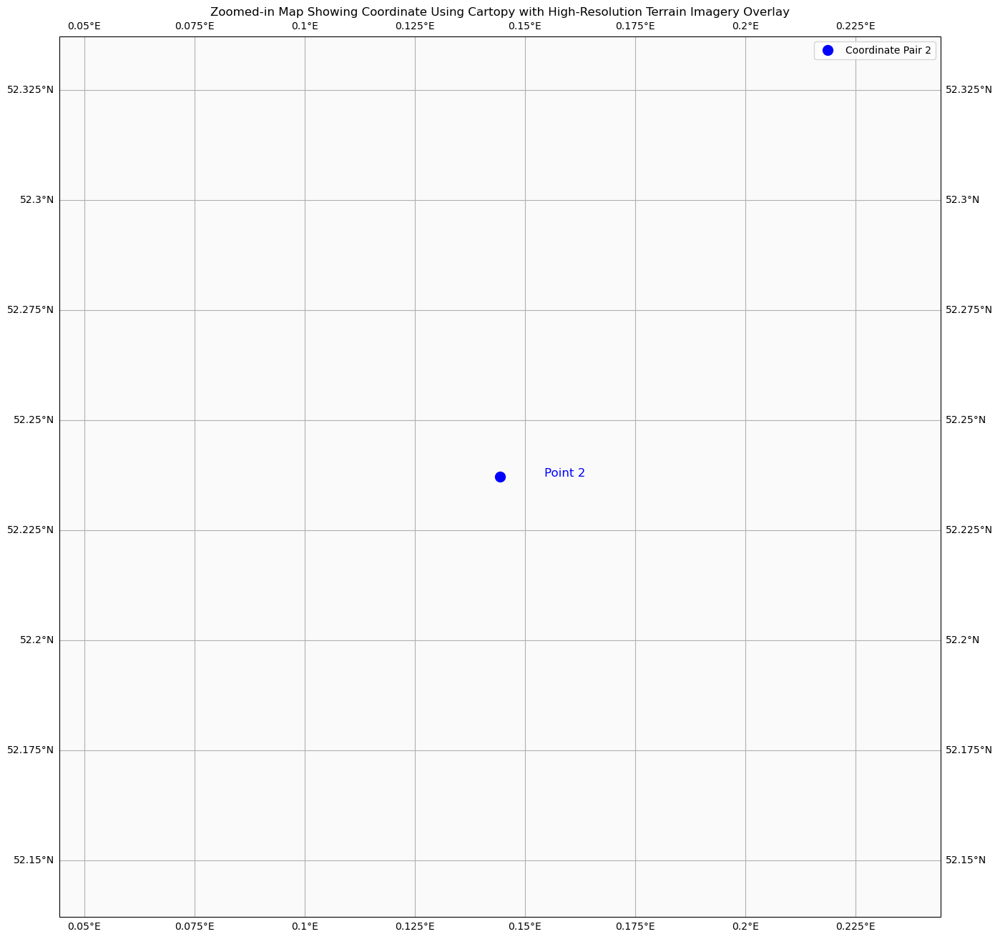

In [71]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map tiler using Google Satellite imagery (using Stamen terrain as alternative with higher resolution)
map_tiler = cimgt.Stamen('terrain')

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(16, 16), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.1,
               lat_lon_2['longitude2'] + 0.1,
               lat_lon_2['latitude2'] - 0.1,
               lat_lon_2['latitude2'] + 0.1], crs=ccrs.PlateCarree())

# Add the terrain imagery tiles to the background with a higher zoom level
ax.add_image(map_tiler, 12)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with High-Resolution Terrain Imagery Overlay")
plt.legend()

# Display the plot
plt.show()


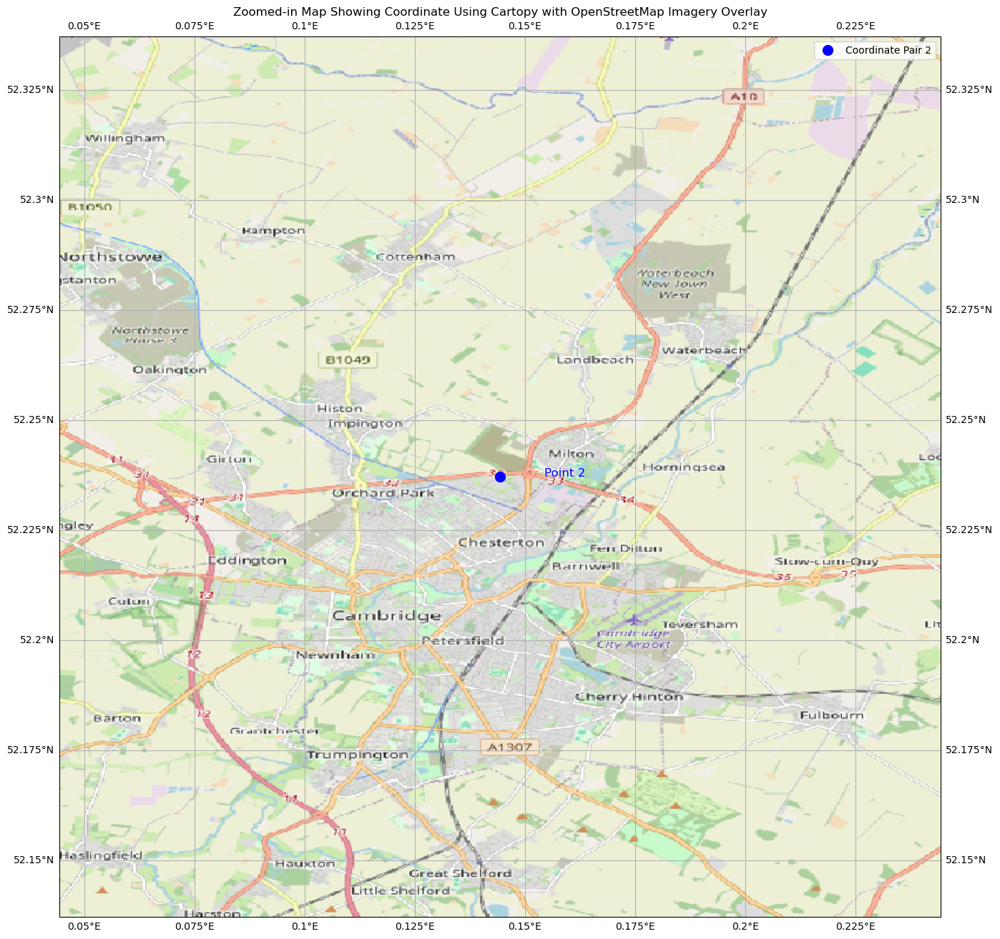

In [72]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt
import requests

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map tiler using OpenStreetMap for the background imagery
tile_url = "https://a.tile.openstreetmap.org/{z}/{x}/{y}.png"
map_tiler = cimgt.OSM()  # Using OSM as it has reliable tile servers

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(16, 16), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.1,
               lat_lon_2['longitude2'] + 0.1,
               lat_lon_2['latitude2'] - 0.1,
               lat_lon_2['latitude2'] + 0.1], crs=ccrs.PlateCarree())

# Add the OSM imagery tiles to the background with a higher zoom level
ax.add_image(map_tiler, 12)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.01, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with OpenStreetMap Imagery Overlay")
plt.legend()

# Display the plot
plt.show()

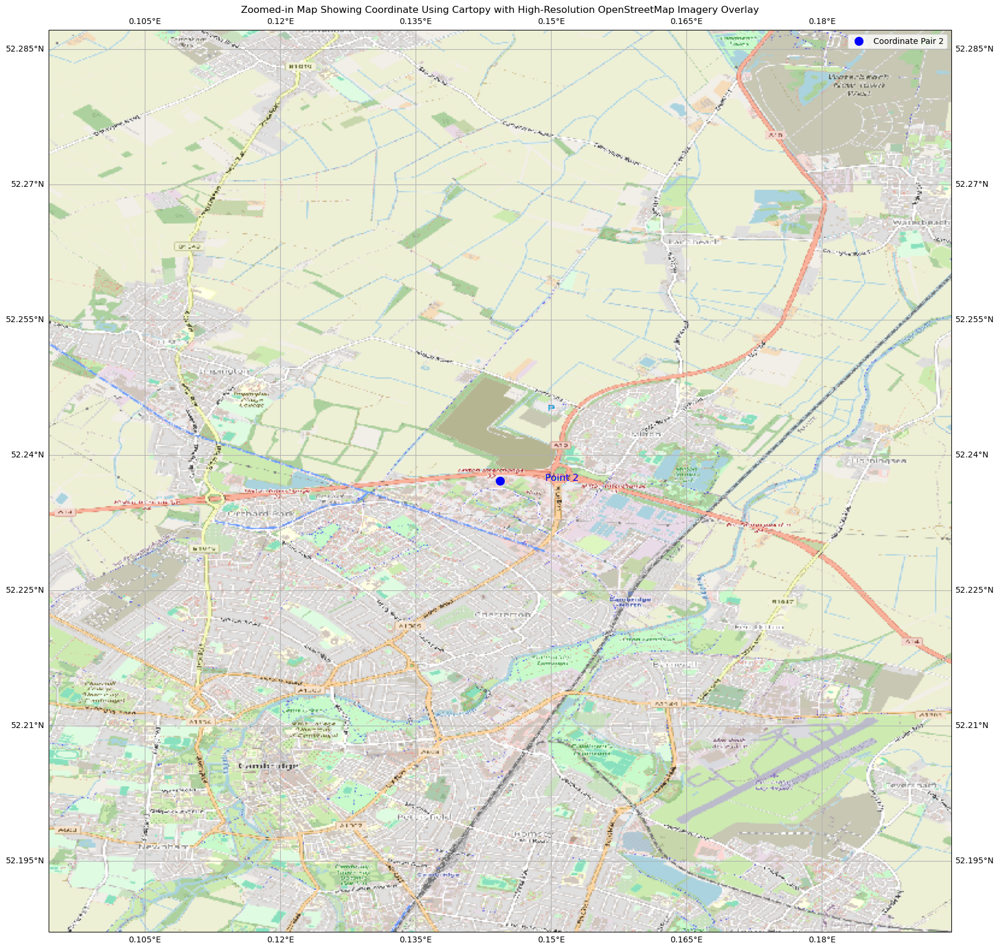

<Figure size 640x480 with 0 Axes>

In [74]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt
import requests

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map tiler using OpenStreetMap for the background imagery
tile_url = "https://a.tile.openstreetmap.org/{z}/{x}/{y}.png"
map_tiler = cimgt.OSM()  # Using OSM as it has reliable tile servers

# Create a plot with Cartopy for better geographic representation
fig, ax = plt.subplots(figsize=(20, 20), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.05,
               lat_lon_2['longitude2'] + 0.05,
               lat_lon_2['latitude2'] - 0.05,
               lat_lon_2['latitude2'] + 0.05], crs=ccrs.PlateCarree())

# Add the OSM imagery tiles to the background with a higher zoom level
ax.add_image(map_tiler, 14)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.005, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with High-Resolution OpenStreetMap Imagery Overlay")
plt.legend()

# Display the plot
plt.show()


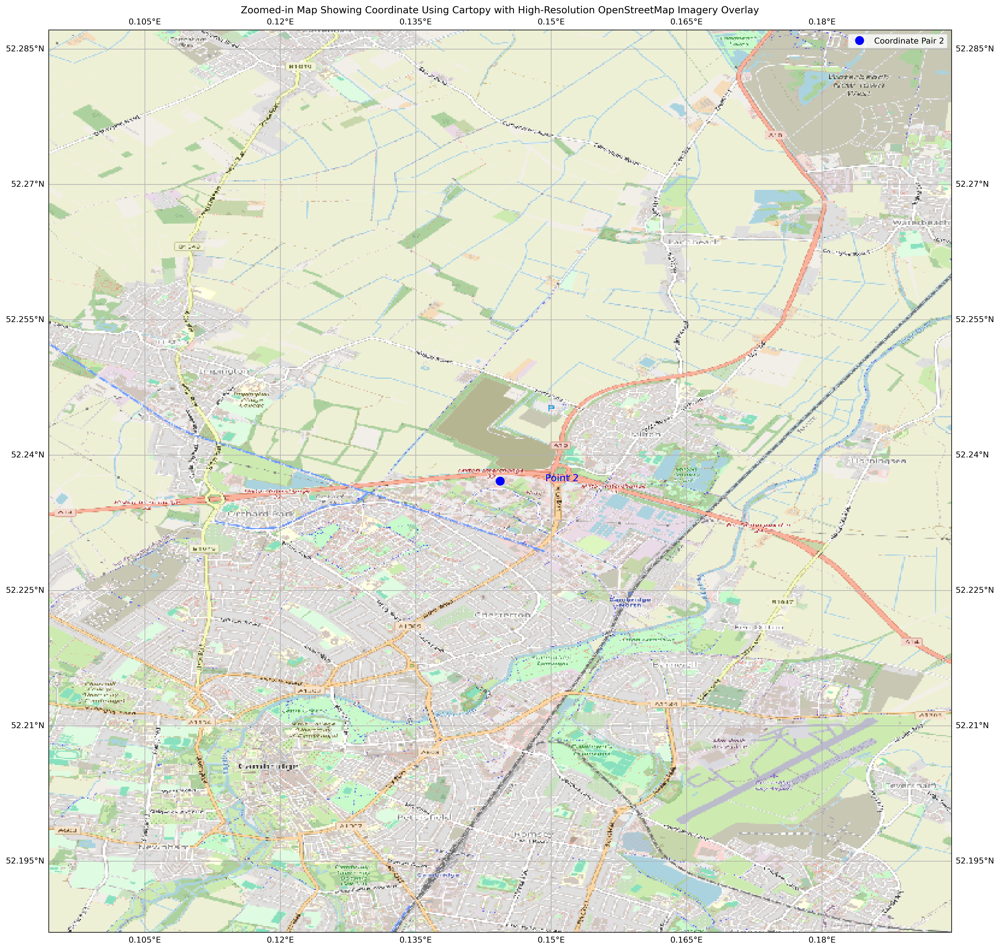

In [75]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as cimgt
import requests

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a map tiler using OpenStreetMap for the background imagery
tile_url = "https://a.tile.openstreetmap.org/{z}/{x}/{y}.png"
map_tiler = cimgt.OSM()  # Using OSM as it has reliable tile servers

# Create a plot with Cartopy for better geographic representation
plt.rcParams['figure.dpi'] = 300  # Set higher resolution for inline rendering
fig, ax = plt.subplots(figsize=(20, 20), subplot_kw={'projection': ccrs.PlateCarree()})

# Set extent to zoom into the region around the points (adding a smaller buffer for detailed view)
ax.set_extent([lat_lon_2['longitude2'] - 0.05,
               lat_lon_2['longitude2'] + 0.05,
               lat_lon_2['latitude2'] - 0.05,
               lat_lon_2['latitude2'] + 0.05], crs=ccrs.PlateCarree())

# Add the OSM imagery tiles to the background with a higher zoom level
ax.add_image(map_tiler, 14)

# Add features to the map for better context
ax.add_feature(cfeature.BORDERS, linestyle=':')
ax.add_feature(cfeature.COASTLINE)
ax.gridlines(draw_labels=True)

# Plot the point on the map
ax.plot(lat_lon_2['longitude2'], lat_lon_2['latitude2'], 'bo', markersize=10, transform=ccrs.PlateCarree(), label='Coordinate Pair 2')

# Adding label for the point
ax.text(lat_lon_2['longitude2'] + 0.005, lat_lon_2['latitude2'], "Point 2", transform=ccrs.PlateCarree(), fontsize=12, color='blue')

# Add a title and legend
plt.title("Zoomed-in Map Showing Coordinate Using Cartopy with High-Resolution OpenStreetMap Imagery Overlay")
plt.legend()

# Display the plot
plt.show()


AttributeError: Mapbox

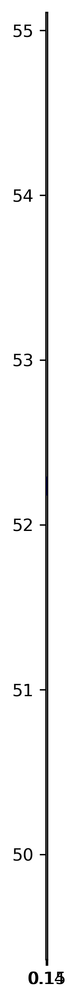

In [76]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely.geometry import Point

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a GeoDataFrame with the point
geometry = [Point(lat_lon_2['longitude2'], lat_lon_2['latitude2'])]
gdf = gpd.GeoDataFrame({'label': ['Coordinate Pair 2']}, geometry=geometry, crs='EPSG:4326')

# Create a plot
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the point using geopandas
gdf.plot(ax=ax, color='blue', markersize=100)

# Add basemap with contextily (using a higher zoom level for better resolution)
ctx.add_basemap(ax, source=ctx.providers.Mapbox.Satellite, zoom=14, crs=gdf.crs)

# Add labels for the points
for x, y, label in zip(gdf.geometry.x, gdf.geometry.y, gdf['label']):
    ax.text(x + 0.001, y, label, fontsize=12, color='blue')

# Set titles and labels
ax.set_title("Zoomed-in Map Showing Coordinate Using GeoPandas with Mapbox Satellite Imagery Overlay")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()


HTTPError: Connection reset by peer too many times. Last message was: 401 Error: Unauthorized for url: https://tiles.stadiamaps.com/tiles/alidade_smooth/14/8198/5173.png

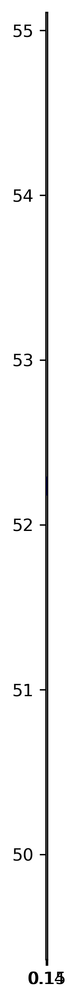

In [78]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely.geometry import Point

# Coordinates from the dataset
lat_lon_2 = {'latitude2': 52.237111, 'longitude2': 0.144343}

# Create a GeoDataFrame with the point
geometry = [Point(lat_lon_2['longitude2'], lat_lon_2['latitude2'])]
gdf = gpd.GeoDataFrame({'label': ['Coordinate Pair 2']}, geometry=geometry, crs='EPSG:4326')

# Create a plot
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the point using geopandas
gdf.plot(ax=ax, color='blue', markersize=100)


api_key = 'e055cd8e-5ec7-479f-a3c1-1ed46dc8ee3c'
# Add your API key to the desired style from contextily providers
provider = ctx.providers.Stadia.StamenTerrain(api_key=api_key)
# Add basemap with contextily (using Stadia Maps)
provider["url"] = provider["url"] + "?api_key={api_key}"

# Draw the basemap under the plot, define the Coordinate Reference System, and add the updated provider object as the source
ctx.add_basemap(ax, crs='EPSG:4326', source=provider)

# Add labels for the points
for x, y, label in zip(gdf.geometry.x, gdf.geometry.y, gdf['label']):
    ax.text(x + 0.001, y, label, fontsize=12, color='blue')

# Set titles and labels
ax.set_title("Zoomed-in Map Showing Coordinate Using GeoPandas with Stadia Maps Imagery Overlay")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()
